# RF-DETR – Entrenamiento de detección de potholes

Este notebook entrena un modelo **RF-DETR Small** para detectar *potholes* usando anotaciones COCO.

## Librerías


In [2]:
#Libraries
import torch
import os
from rfdetr import RFDETRSmall 
from pathlib import Path
import supervision as sv
from PIL import Image
import json
import matplotlib.pyplot as plt
import numpy as np

## Configuración de rutas

In [3]:
# Config Paths
try:
    PROJECT_ROOT = Path(os.getcwd())
    BASE_DIR = PROJECT_ROOT

    TRAIN_JSON = BASE_DIR / "train" / "_annotations.coco.json"
    VAL_JSON   = BASE_DIR / "valid" / "_annotations.coco.json"
    TEST_JSON  = BASE_DIR / "test" / "_annotations.coco.json"

    TRAIN_DIR  = BASE_DIR / "train" / "images"
    VAL_DIR    = BASE_DIR / "valid" / "images"
    TEST_DIR   = BASE_DIR / "test" / "images"

    OUTPUT_DIR = (BASE_DIR / "models" / "RF-DETR").resolve()
    OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

    print("Rutas cargadas correctamente")
except Exception as e:
    print(f"Error al configurar las rutas: {e}")


Rutas cargadas correctamente


## Configuración de dispositivo (CPU / GPU)

In [4]:
if torch.cuda.is_available():
    device = torch.device("cuda")
    print(f"Usando GPU: {torch.cuda.get_device_name(0)}")
else:
    device = torch.device("cpu")
    print("No se detectó GPU, usando CPU.")


Usando GPU: NVIDIA GeForce GTX 1650


## Entrenamiento del modelo


In [5]:
# define parameters and model
NUM_CLASSES = len(json.load(open(TRAIN_JSON))["categories"])  
EPOCHS = 30  # Óptimo para  dataset
BATCH_SIZE = 2
GRAD_ACCUM_STEPS = 8  # Batch efectivo de 16
LEARNING_RATE = 1e-4  # Estándar para RF-DETR

model = RFDETRSmall(
    num_classes=NUM_CLASSES,
    pretrained=True
)

# Train the model
model.train(
    dataset_dir=str(BASE_DIR),
    train_annotation_path=str(TRAIN_JSON),
    val_annotation_path=str(VAL_JSON),
    output_dir=str(OUTPUT_DIR),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    grad_accum_steps=GRAD_ACCUM_STEPS,  # IMPORTANTE
    lr=LEARNING_RATE,  # IMPORTANTE
    device=device
)

print("Entrenamiento completado")


rf-detr-small.pth: 100%|██████████| 368M/368M [00:06<00:00, 57.1MiB/s] 


Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Loading pretrain weights
TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir D:\Entrenamiento_A\models\RF-DETR' and open http://localhost:6006/ in browser.
Not using distributed mode
git:
  sha: N/A, status: clean, branch: N/A

Namespace(num_classes=2, grad_accum_steps=8, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=2, weight_decay=0.0001, epochs=40, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-small.pth', pretrain_exclude_keys=None, 

Epoch: [0]  [  0/159]  eta: 1:05:23  lr: 0.000100  class_error: 92.31  loss: 44.9613 (44.9613)  loss_ce: 6.5028 (6.5028)  loss_bbox: 2.6303 (2.6303)  loss_giou: 1.8473 (1.8473)  loss_ce_0: 6.3561 (6.3561)  loss_bbox_0: 2.8615 (2.8615)  loss_giou_0: 2.1992 (2.1992)  loss_ce_1: 6.3258 (6.3258)  loss_bbox_1: 2.8825 (2.8825)  loss_giou_1: 2.0420 (2.0420)  loss_ce_enc: 5.2088 (5.2088)  loss_bbox_enc: 3.3648 (3.3648)  loss_giou_enc: 2.7402 (2.7402)  loss_ce_unscaled: 6.5028 (6.5028)  class_error_unscaled: 92.3077 (92.3077)  loss_bbox_unscaled: 0.5261 (0.5261)  loss_giou_unscaled: 0.9236 (0.9236)  cardinality_error_unscaled: 3899.5000 (3899.5000)  loss_ce_0_unscaled: 6.3561 (6.3561)  loss_bbox_0_unscaled: 0.5723 (0.5723)  loss_giou_0_unscaled: 1.0996 (1.0996)  cardinality_error_0_unscaled: 3899.5000 (3899.5000)  loss_ce_1_unscaled: 6.3258 (6.3258)  loss_bbox_1_unscaled: 0.5765 (0.5765)  loss_giou_1_unscaled: 1.0210 (1.0210)  cardinality_error_1_unscaled: 3899.5000 (3899.5000)  loss_ce_enc_uns

## Resultados del  Entrenamiento


RESULTADOS DEL ENTRENAMIENTO - POTHOLE DETECTION

mAP@0.50:0.95: 0.5084
mAP@0.50:     0.8862
Precisión:    0.8991
Recall:       0.8800

Por clase:
  pothole: mAP@50:95=0.508, mAP@50=0.886


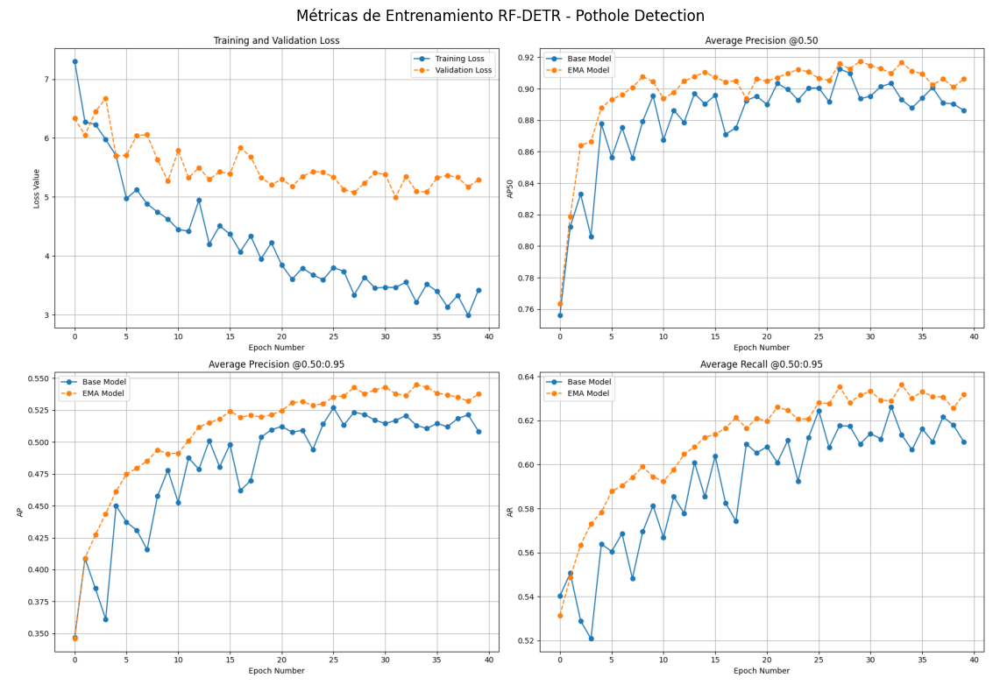


Gráfica guardada en: D:\Entrenamiento_A\models\RF-DETR\metrics_plot.png


In [6]:
# Análisis de resultados del entrenamiento
log_path = OUTPUT_DIR / "log.txt"  # Usa tu OUTPUT_DIR ya definido

with open(log_path, "r", encoding="utf-8") as f:
    lines = f.readlines()
    last = None
    # Busca la última línea con resultados
    for line in reversed(lines):
        if '"test_results_json"' in line or '"results_json"' in line:
            last = json.loads(line)
            break

if last:
    # Busca results_json en el diccionario
    if "test_results_json" in last:
        results = last["test_results_json"]
    elif "results_json" in last:
        results = last["results_json"]
    else:
        results = last
    
    print("=" * 50)
    print("RESULTADOS DEL ENTRENAMIENTO - POTHOLE DETECTION")
    print("=" * 50)
    print(f"\nmAP@0.50:0.95: {results['class_map'][-1]['map@50:95']:.4f}")
    print(f"mAP@0.50:     {results['class_map'][-1]['map@50']:.4f}")
    print(f"Precisión:    {results['class_map'][-1]['precision']:.4f}")
    print(f"Recall:       {results['class_map'][-1]['recall']:.4f}")
    print("\nPor clase:")
    for clase in results['class_map'][:-1]:
        print(f"  {clase['class']}: mAP@50:95={clase['map@50:95']:.3f}, mAP@50={clase['map@50']:.3f}")
    print("=" * 50)

# Visualizar gráfica de métricas
img_path = OUTPUT_DIR / "metrics_plot.png"
if img_path.exists():
    img = Image.open(img_path)
    plt.figure(figsize=(12, 8))
    plt.imshow(img)
    plt.axis("off")
    plt.title("Métricas de Entrenamiento RF-DETR - Pothole Detection")
    plt.tight_layout()
    plt.show()
    print(f"\nGráfica guardada en: {img_path}")
else:
    print(f"No se encontró la gráfica en: {img_path}")


## Interpretación de los Resultados – RF-DETR (Detección de Huecos en el Pavimento)

La imagen presenta una comparación entre las **anotaciones originales del dataset** y las **detecciones generadas por el modelo RF-DETR** tras el proceso de entrenamiento.

### Panel Izquierdo – Anotaciones Originales
- Muestra las **cajas delimitadoras (ground truth)** definidas manualmente en el dataset.
- Representa la referencia utilizada durante el entrenamiento.
- Permite verificar la calidad y coherencia de las etiquetas.
- Cada bounding box corresponde a un **hueco en el pavimento (pothole)** identificado en la imagen.

### Panel Derecho – Detecciones del Modelo
- Muestra las **predicciones realizadas por RF-DETR** sobre la misma imagen.
- Cada caja incluye:
  - **Bounding box** estimada por el modelo
  - **Nivel de confianza** asociado a la detección
- Las detecciones reflejan la capacidad del modelo para:
  - Localizar correctamente los huecos
  - Ajustar el tamaño y posición de las cajas
  - Filtrar objetos irrelevantes mediante un umbral de confianza

###  Análisis General
- Se observa una **alta correspondencia espacial** entre las anotaciones originales y las detecciones del modelo.
- El modelo logra detectar correctamente múltiples huecos en una misma imagen.
- Las predicciones presentan **buena precisión en la localización**, lo que indica un aprendizaje efectivo de las características visuales del daño en el pavimento.

### Conclusión
Estos resultados evidencian que el modelo **RF-DETR entrenado es capaz de generalizar adecuadamente**, detectando huecos en el pavimento con un alto nivel de coherencia respecto a las anotaciones originales. Esto lo convierte en una solución viable para aplicaciones de **inspección automática de infraestructura vial**.


## Prueba con imágenes de test

In [ ]:
# ======================================
# COMPARACIÓN: Ground Truth vs Predicciones
# ======================================

# Configuración
BASE_DIR = Path(r"D:\Entrenamiento_A")
TRAIN_JSON = BASE_DIR / "train" / "_annotations.coco.json"
TEST_JSON = BASE_DIR / "test" / "_annotations.coco.json"
TEST_DIR = BASE_DIR / "test"
CHECKPOINT_PATH = BASE_DIR / "models" / "RF-DETR" / "checkpoint_best_ema.pth"

# Cargar modelo
print(" Cargando modelo...")
NUM_CLASSES = len(json.load(open(TRAIN_JSON))["categories"])
model = RFDETRSmall(num_classes=NUM_CLASSES)

state = torch.load(CHECKPOINT_PATH, map_location="cpu")

if "ema" in state:
    state = state["ema"]
elif "model" in state:
    state = state["model"]
elif "state_dict" in state:
    state = state["state_dict"]

try:
    torch_model = model.model.model
except AttributeError:
    torch_model = model.model

missing, unexpected = torch_model.load_state_dict(state, strict=False)
print("Pesos cargados correctamente.")

model.optimize_for_inference(compile=False)
model.names = ["pothole"]  # Tu única clase

# Cargar dataset con anotaciones ground truth
print("📂 Cargando dataset con anotaciones...")
ds = sv.DetectionDataset.from_coco(
    images_directory_path=str(TEST_DIR),
    annotations_path=str(TEST_JSON)
)
print(f"Dataset cargado. Clases: {ds.classes}")

# Seleccionar imagen de prueba
from tkinter import Tk, filedialog

print("\n Selecciona una imagen del conjunto test...")
root = Tk()
root.withdraw()
root.attributes('-topmost', True)

IMAGE_PATH = filedialog.askopenfilename(
    title="Selecciona imagen para comparar",
    initialdir=str(TEST_DIR),
    filetypes=[
        ("Imágenes", "*.jpg *.jpeg *.png *.bmp"),
        ("Todos los archivos", "*.*")
    ]
)
root.destroy()

if not IMAGE_PATH:
    print(" No se seleccionó imagen")
else:
    print(f"Imagen: {Path(IMAGE_PATH).name}\n")
    
    # Buscar anotaciones ground truth para esta imagen
    annotations = None
    image_name = os.path.basename(IMAGE_PATH)
    
    for path, img, ann in ds:
        if image_name in path:
            annotations = ann
            break
    
    if annotations is None:
        print(f" No se encontraron anotaciones para: {image_name}")
    else:
        # Cargar imagen
        image = Image.open(IMAGE_PATH).convert("RGB")
        
        # Hacer predicción con el modelo
        print("🔍 Haciendo predicción...")
        detections = model.predict(image, conf_threshold=0.4)
        
        # Ajustar IDs de clase
        adjusted_detection_class_ids = [int(cid) - 1 for cid in detections.class_id]
        valid_indices = [i for i, cid in enumerate(adjusted_detection_class_ids) if 0 <= cid < NUM_CLASSES]
        
        if len(valid_indices) < len(detections.class_id):
            print(f" Se descartaron {len(detections.class_id) - len(valid_indices)} detecciones inválidas")
        
        # Filtrar detecciones válidas
        detections.xyxy = detections.xyxy[valid_indices]
        detections.confidence = detections.confidence[valid_indices]
        detections.class_id = np.array([adjusted_detection_class_ids[i] for i in valid_indices], dtype=int)
        
        # Configurar visualización
        text_scale = sv.calculate_optimal_text_scale(resolution_wh=image.size)
        thickness = sv.calculate_optimal_line_thickness(resolution_wh=image.size)
        
        # Colores: verde para ground truth, rojo para predicciones
        color_gt = sv.ColorPalette.from_hex(["#00FF00"])  # Verde
        color_pred = sv.ColorPalette.from_hex(["#FF0000"])  # Rojo
        
        bbox_annotator_gt = sv.BoxAnnotator(color=color_gt, thickness=thickness)
        label_annotator_gt = sv.LabelAnnotator(color=color_gt, text_color=sv.Color.BLACK, text_scale=text_scale)
        
        bbox_annotator_pred = sv.BoxAnnotator(color=color_pred, thickness=thickness)
        label_annotator_pred = sv.LabelAnnotator(color=color_pred, text_color=sv.Color.WHITE, text_scale=text_scale)
        
        # Etiquetas para anotaciones ground truth
        annotations_labels = [
            ds.classes[class_id]
            for class_id in annotations.class_id
            if 0 <= class_id < len(ds.classes)
        ]
        
        # Etiquetas para predicciones del modelo
        detections_labels = [
            f"{ds.classes[int(class_id)]} {conf:.2f}"
            for class_id, conf in zip(detections.class_id, detections.confidence)
        ]
        
        # Crear imagen con anotaciones originales (ground truth)
        annotation_image = image.copy()
        annotation_image = bbox_annotator_gt.annotate(scene=annotation_image, detections=annotations)
        annotation_image = label_annotator_gt.annotate(scene=annotation_image, detections=annotations, labels=annotations_labels)
        
        # Crear imagen con predicciones del modelo
        detections_image = image.copy()
        detections_image = bbox_annotator_pred.annotate(scene=detections_image, detections=detections)
        detections_image = label_annotator_pred.annotate(scene=detections_image, detections=detections, labels=detections_labels)
        
        # Mostrar comparación
        print(f"\n📊 COMPARACIÓN:")
        print(f"  Ground Truth: {len(annotations)} potholes")
        print(f"  Predicciones: {len(detections)} potholes")
        print(f"  Diferencia: {abs(len(annotations) - len(detections))}")
        
        sv.plot_images_grid(
            images=[annotation_image, detections_image],
            grid_size=(1, 2),
            titles=[
                f"Ground Truth ({len(annotations)} potholes)",
                f"Predicciones del Modelo ({len(detections)} potholes)"
            ]
        )
        plt.suptitle(f"{image_name}", fontsize=14, y=0.98)
        plt.show()
        
        print("\n Comparación completada")


📊 Número de clases: 2
🔄 Cargando modelo...
Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Loading pretrain weights


✅ Modelo cargado exitosamente

🖼️ Imágenes encontradas: 111

📷 Procesando [1/5]: -1-_jpg.rf.464abe3d398beec515e54e9d3e2143f0.jpg
🕳️ Potholes detectados: 0


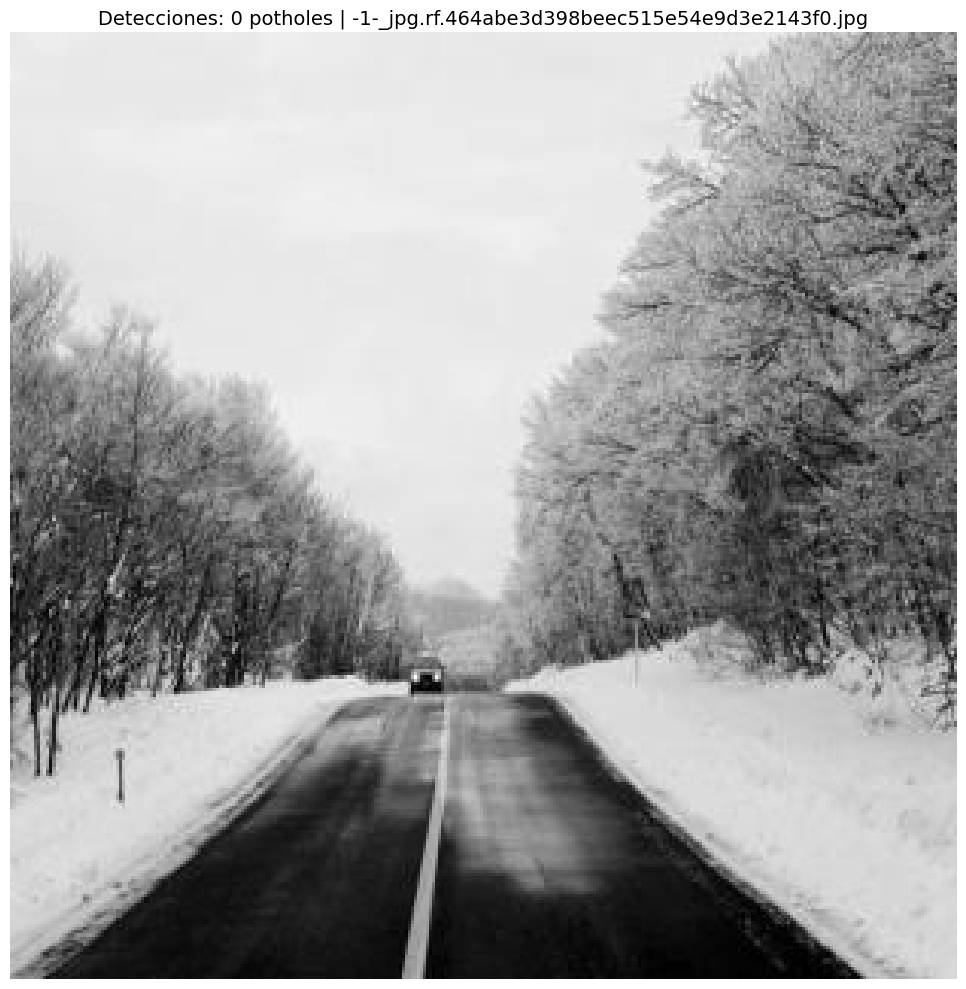


📷 Procesando [2/5]: -11-_jpg.rf.7f29ac6d54644a1c17e20673182ad5e6.jpg
🕳️ Potholes detectados: 0


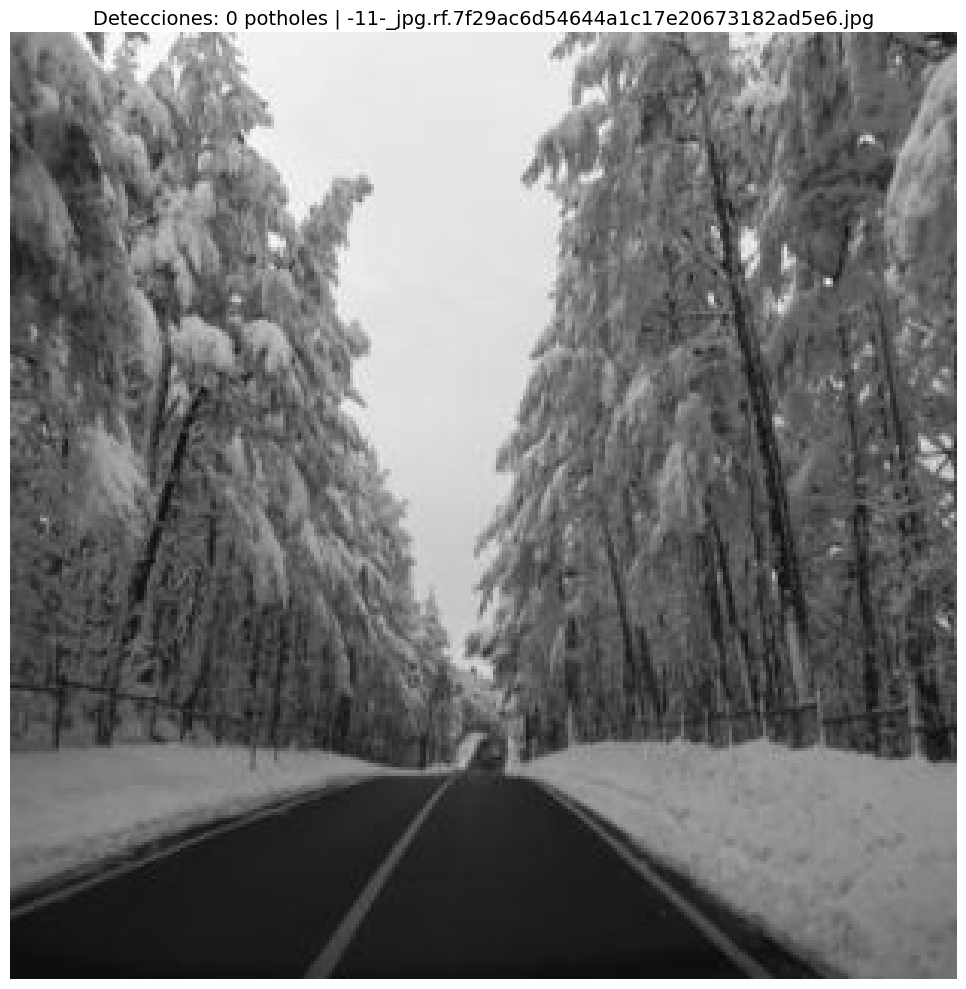


📷 Procesando [3/5]: -11-_jpg.rf.f2907b08977533f6be89be86099ba8cb.jpg
🕳️ Potholes detectados: 0


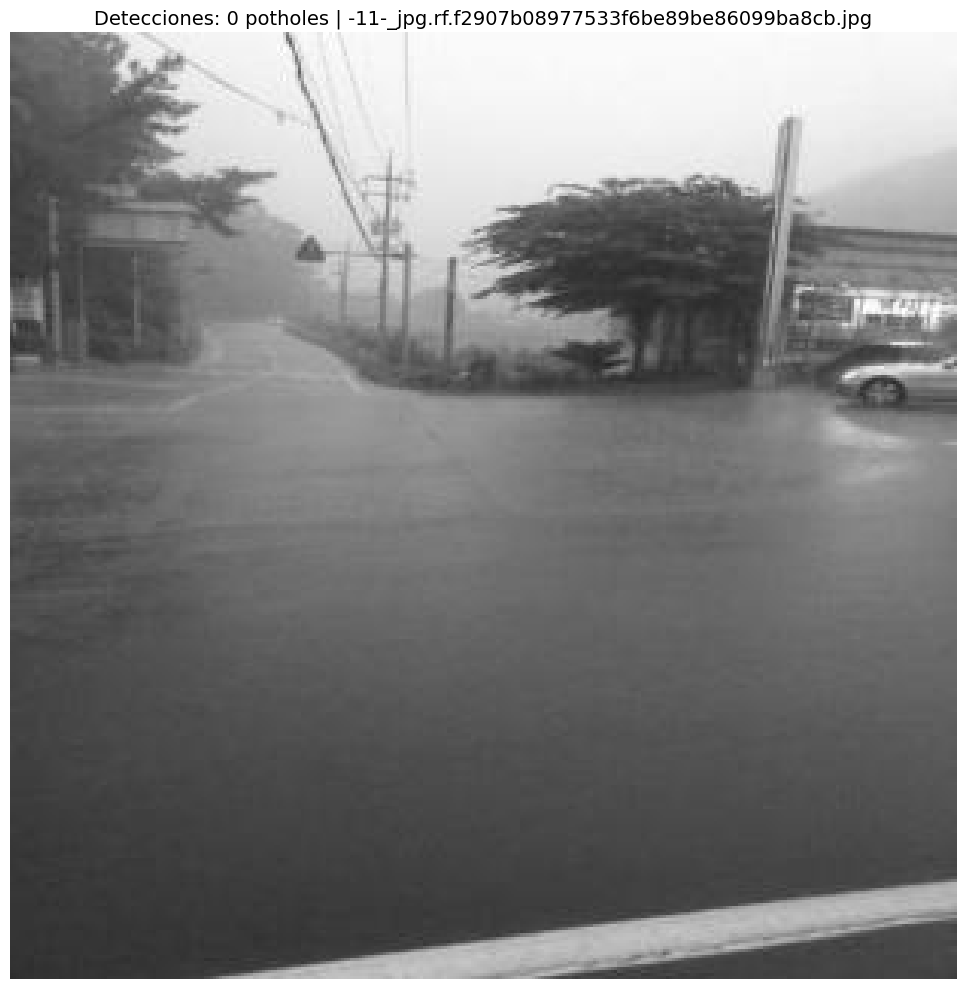


📷 Procesando [4/5]: -11-_jpg.rf.f4113331802e6c3fedb1044950cc11e2.jpg
🕳️ Potholes detectados: 0


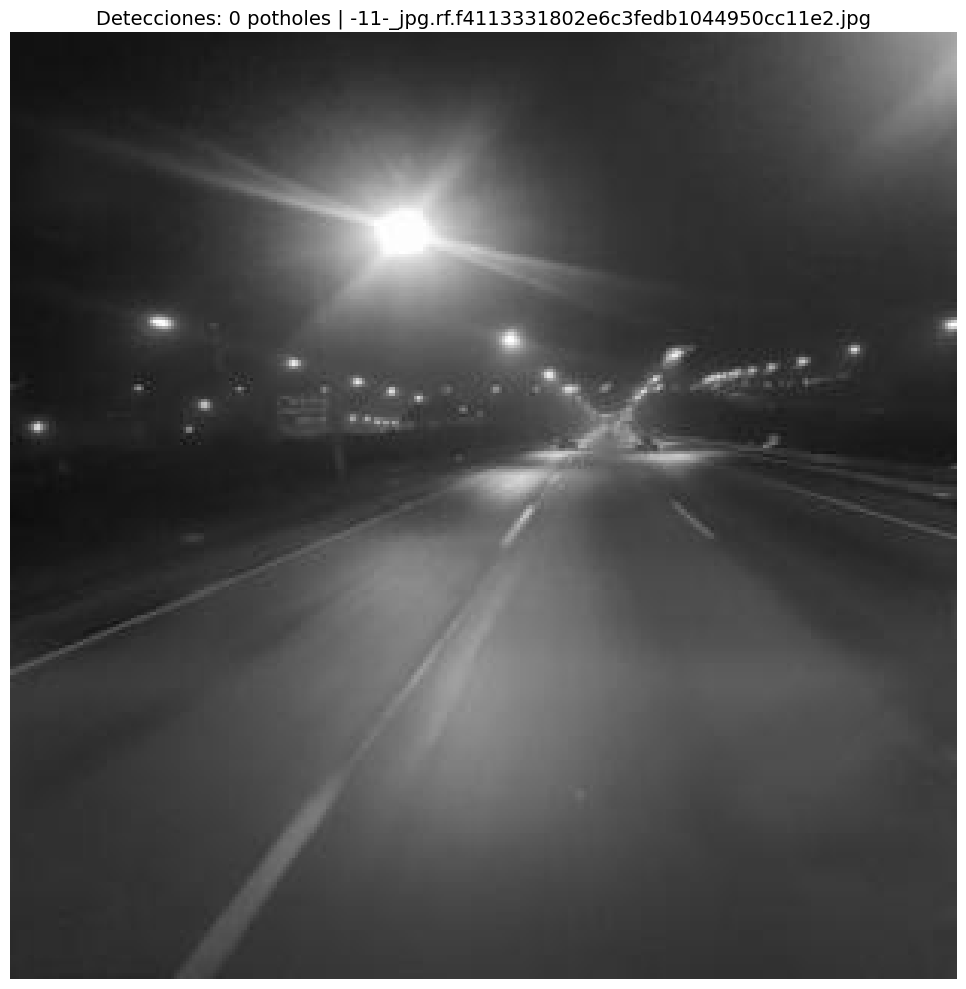


📷 Procesando [5/5]: -11-_jpg.rf.f606c1023cfe92995e640305a0323c43.jpg
🕳️ Potholes detectados: 0


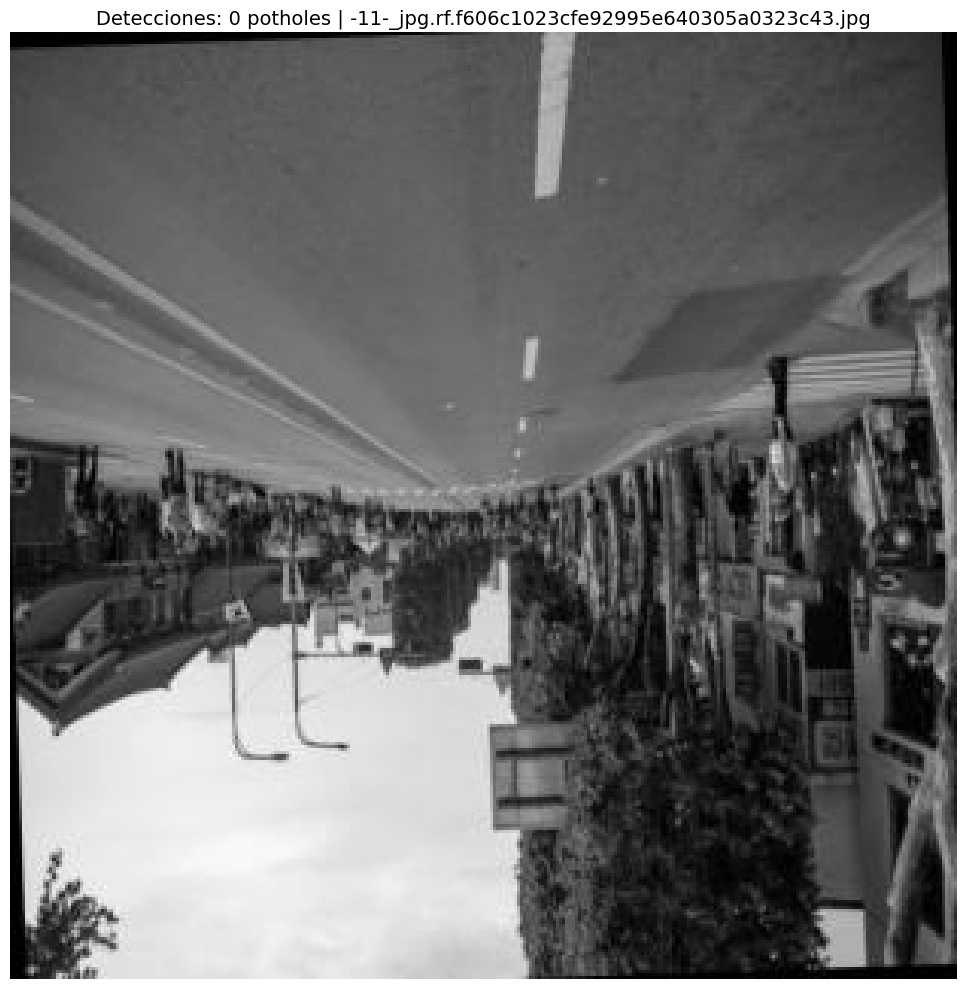


📷 Procesando [6/5]: -13-_jpg.rf.00948974bca11302e65509c3adc883ce.jpg
🕳️ Potholes detectados: 0


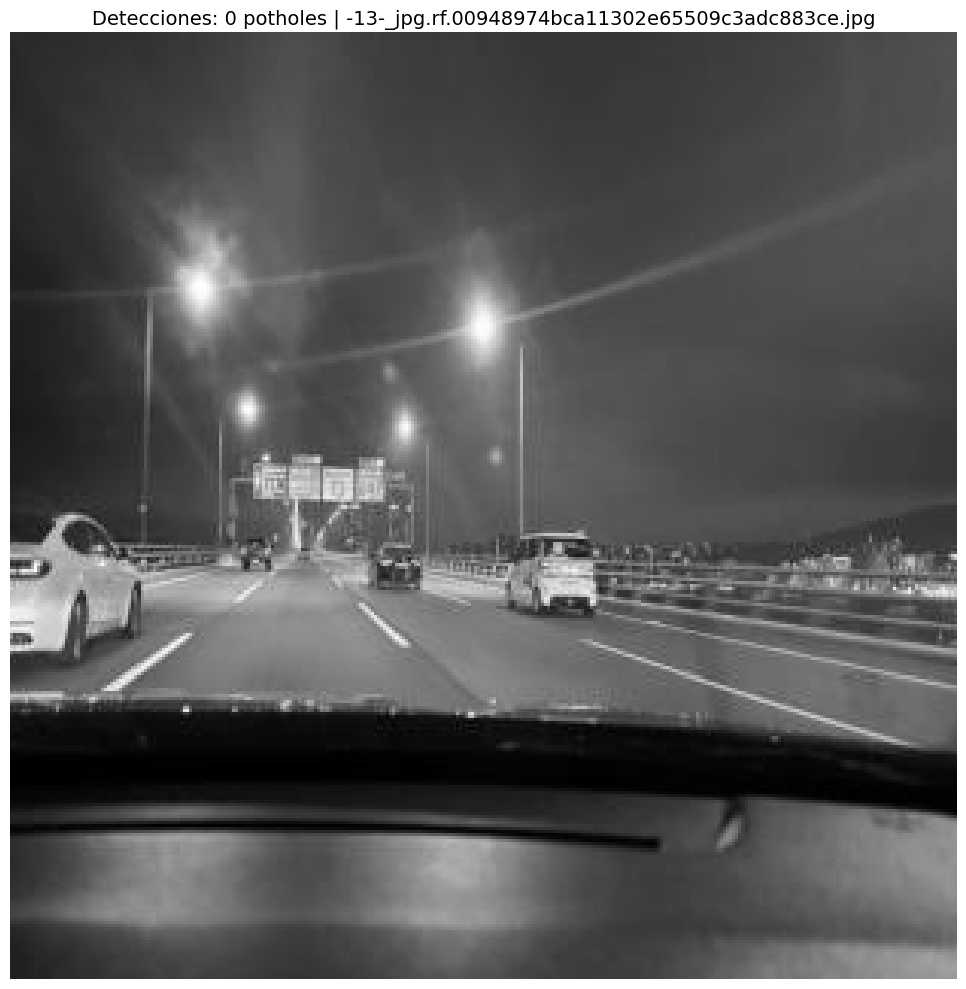


📷 Procesando [7/5]: -13-_jpg.rf.7d4adf86db4b2ac9e567cf77c74d0bdf.jpg
🕳️ Potholes detectados: 0


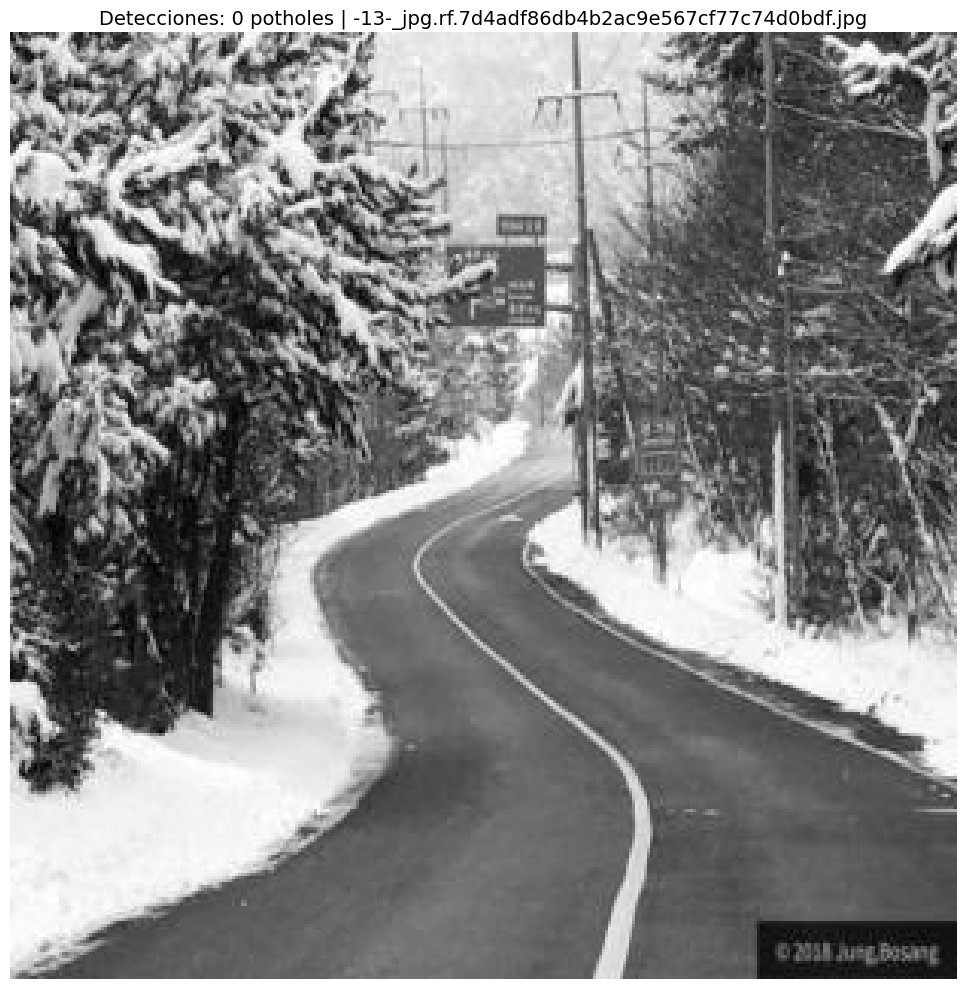


📷 Procesando [8/5]: -14-_jpg.rf.45a8587f11782432334be99833f68d06.jpg
🕳️ Potholes detectados: 0


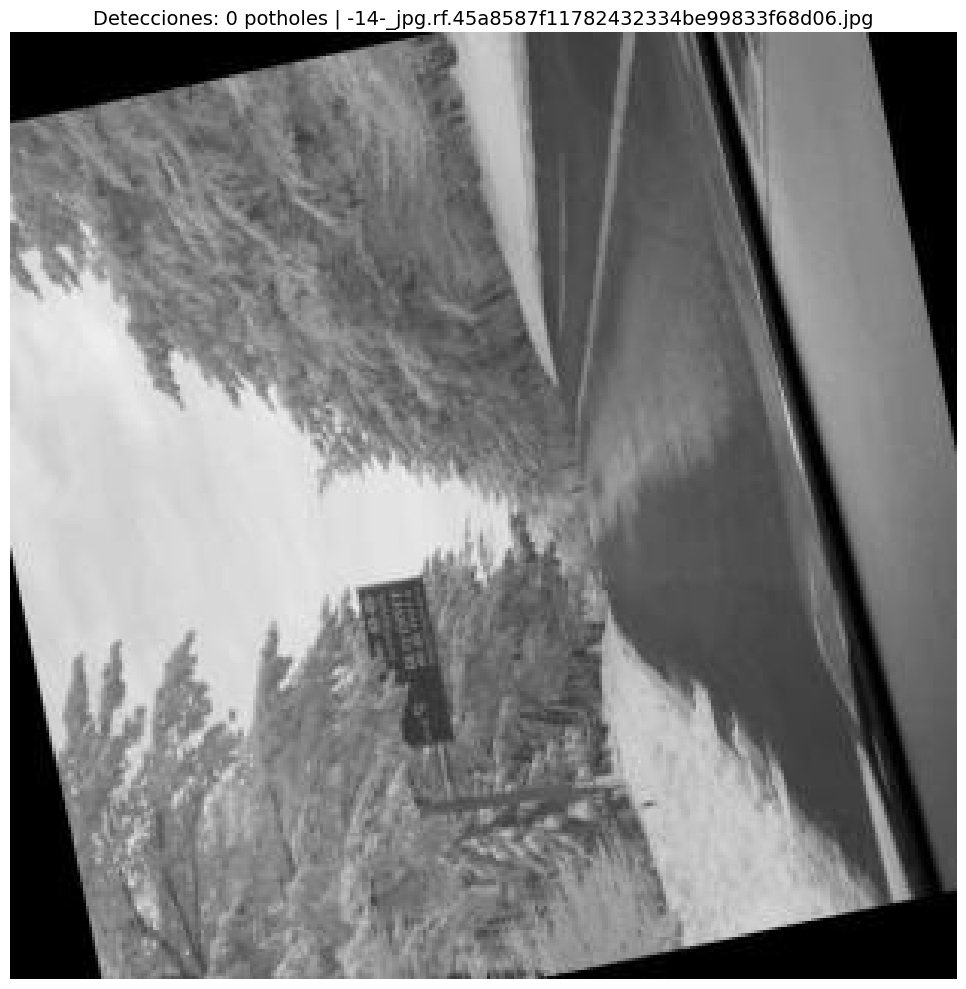


📷 Procesando [9/5]: -19-_jpg.rf.d3931430e5a149ffe90d1cdb6651f40a.jpg
🕳️ Potholes detectados: 0


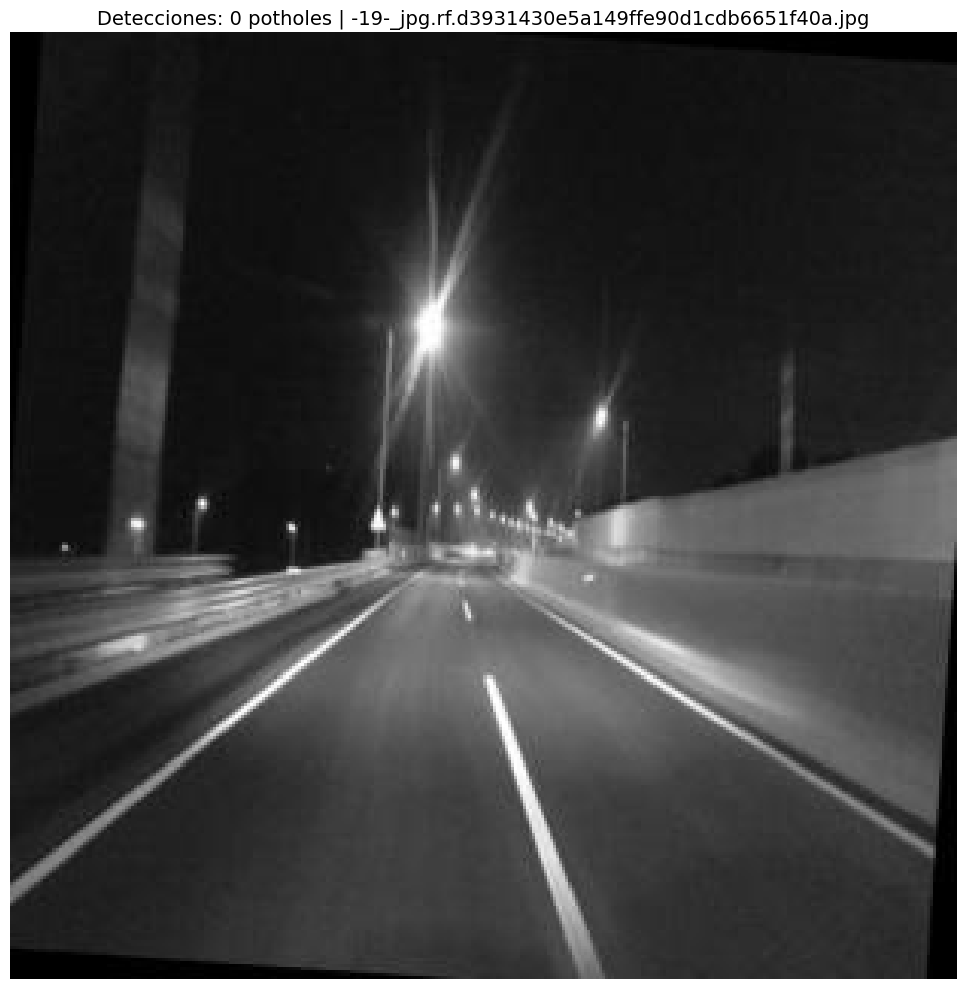


📷 Procesando [10/5]: -20-_jpg.rf.5623643f4da65891875897b4799cb832.jpg
🕳️ Potholes detectados: 0


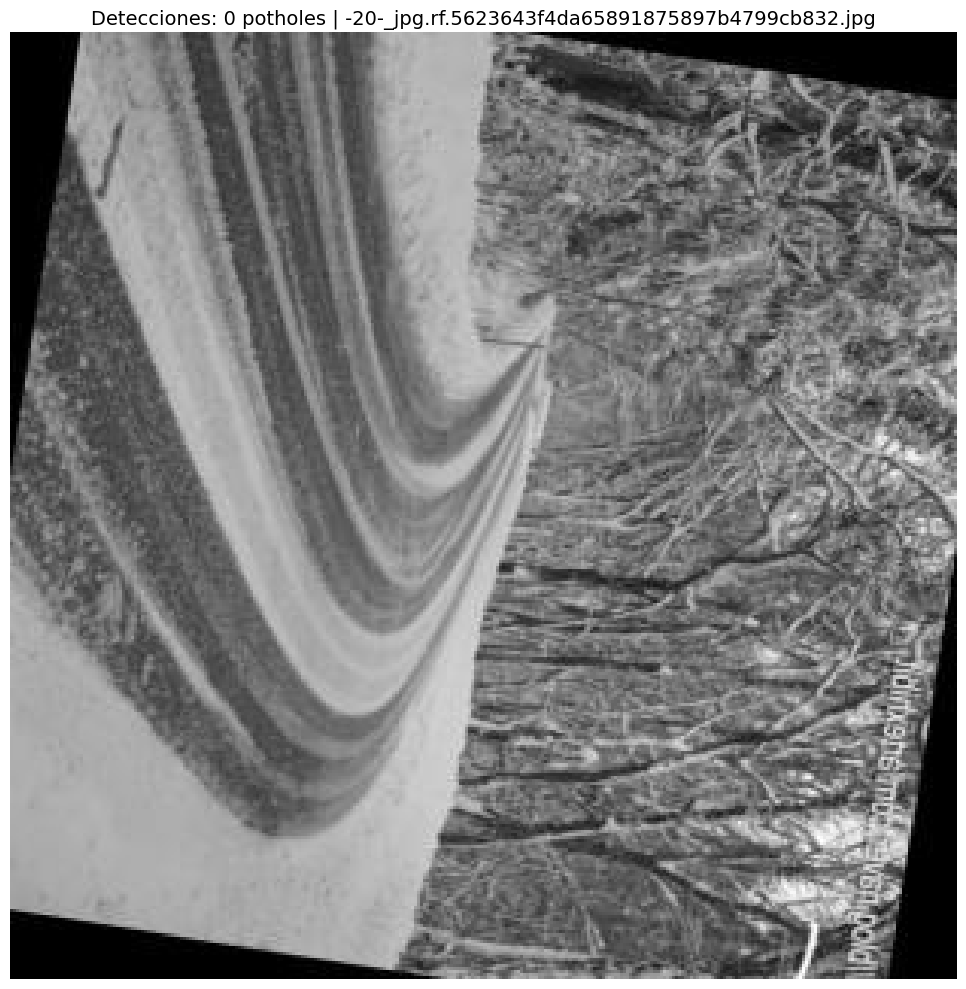


📷 Procesando [11/5]: -3-_jpg.rf.ef48e7cced436573e6e59cf7c82b8b79.jpg
🕳️ Potholes detectados: 0


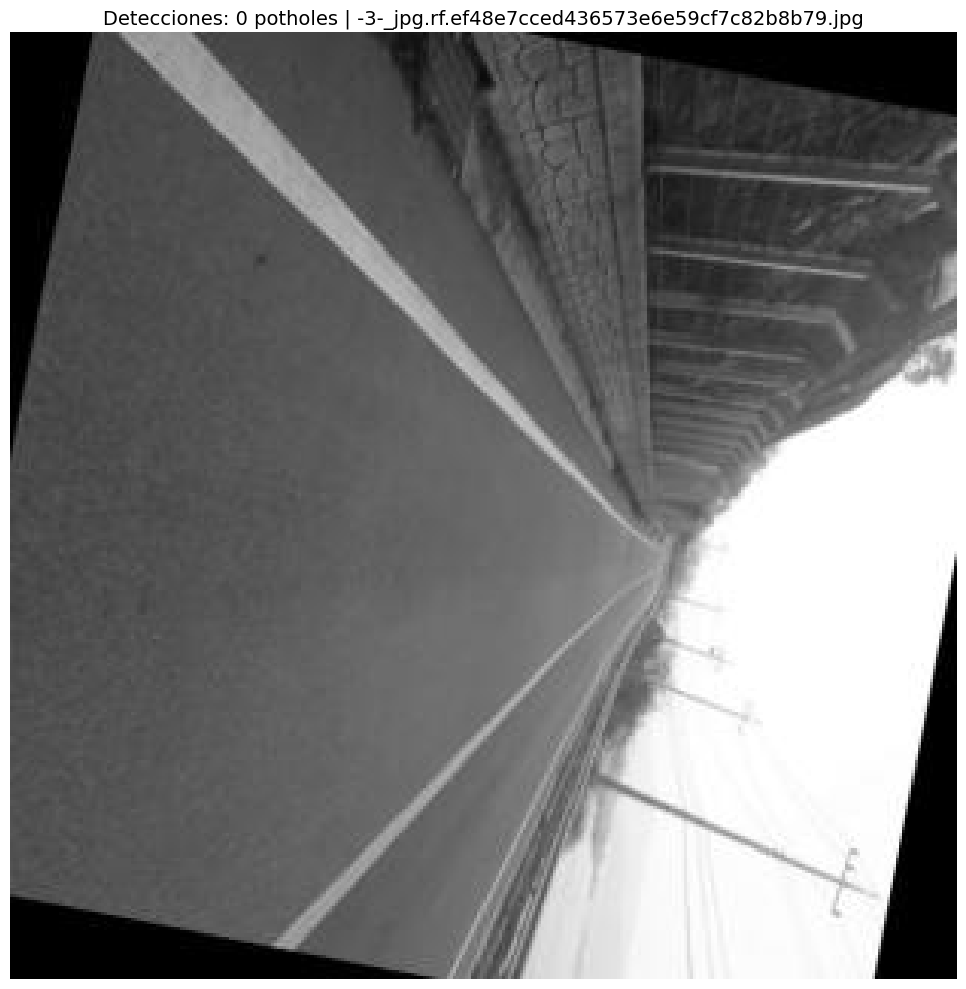


📷 Procesando [12/5]: -4-_jpg.rf.198ebbd78c45b130f621e38003a871dd.jpg
🕳️ Potholes detectados: 0


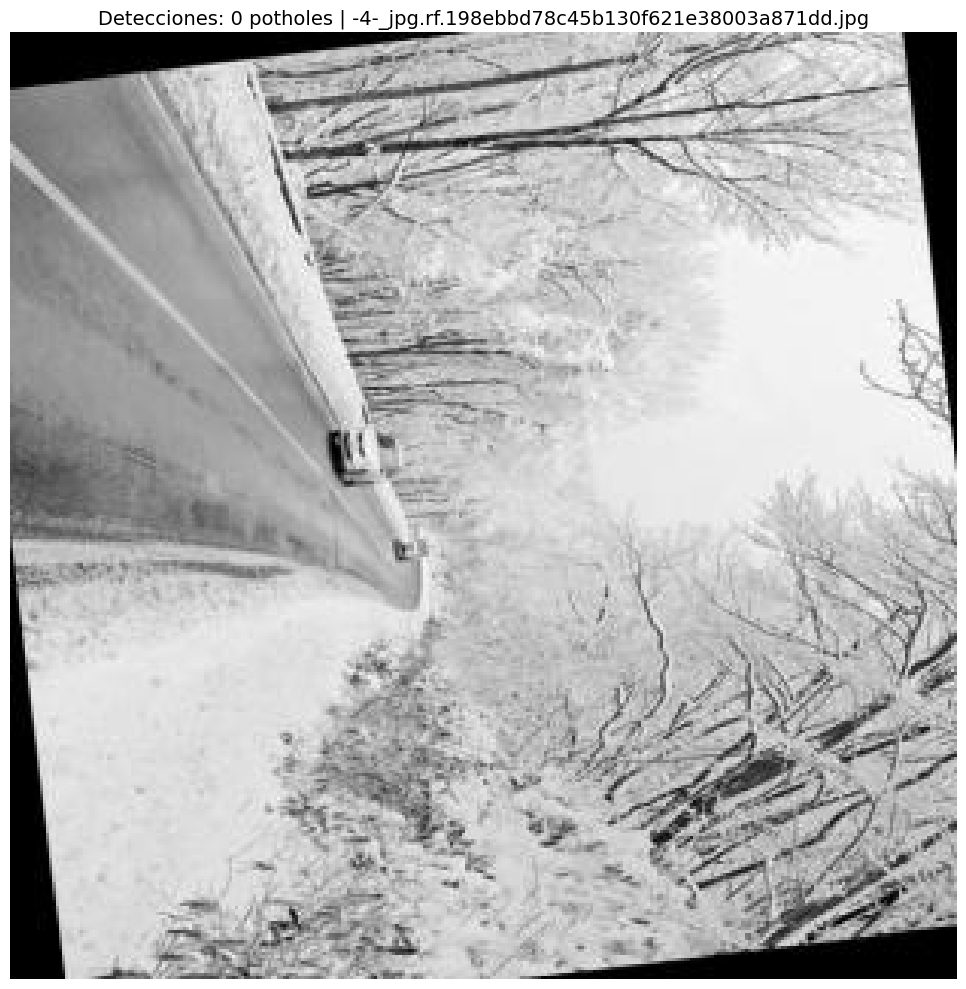


📷 Procesando [13/5]: -4-_jpg.rf.65f685540bc329eb9382d698d45a4ac8.jpg
🕳️ Potholes detectados: 0


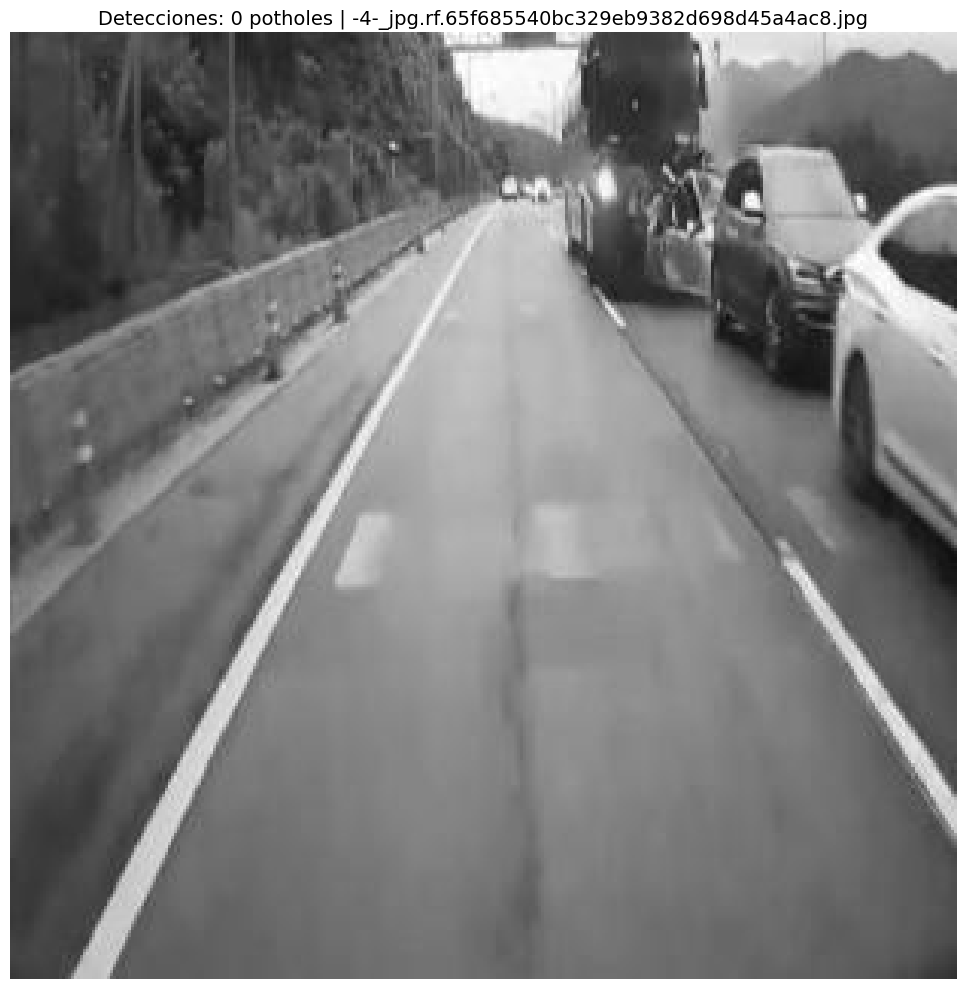


📷 Procesando [14/5]: -5-_jpg.rf.b0840410e9b67cff5fb15504d3407a7e.jpg
🕳️ Potholes detectados: 0


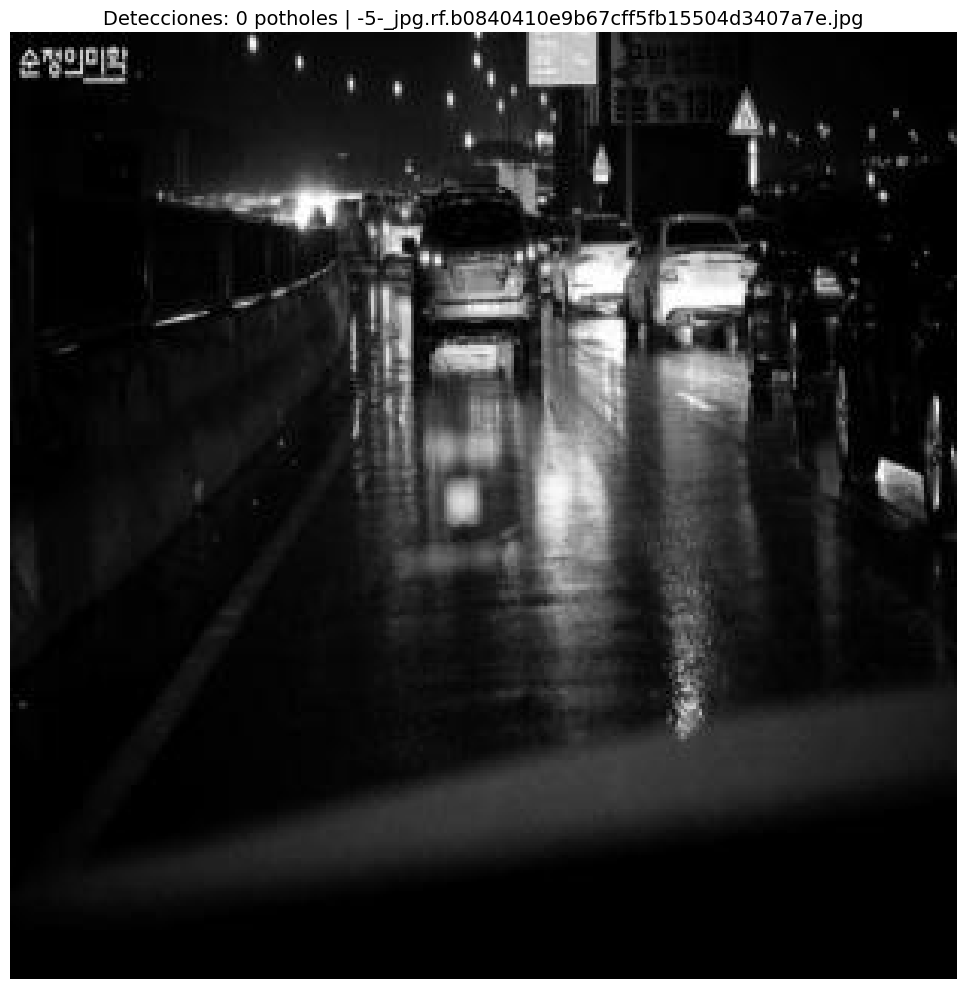


📷 Procesando [15/5]: -8-_jpg.rf.0c6a73ef0e94c9aa6a2a2a091917c703.jpg
🕳️ Potholes detectados: 0


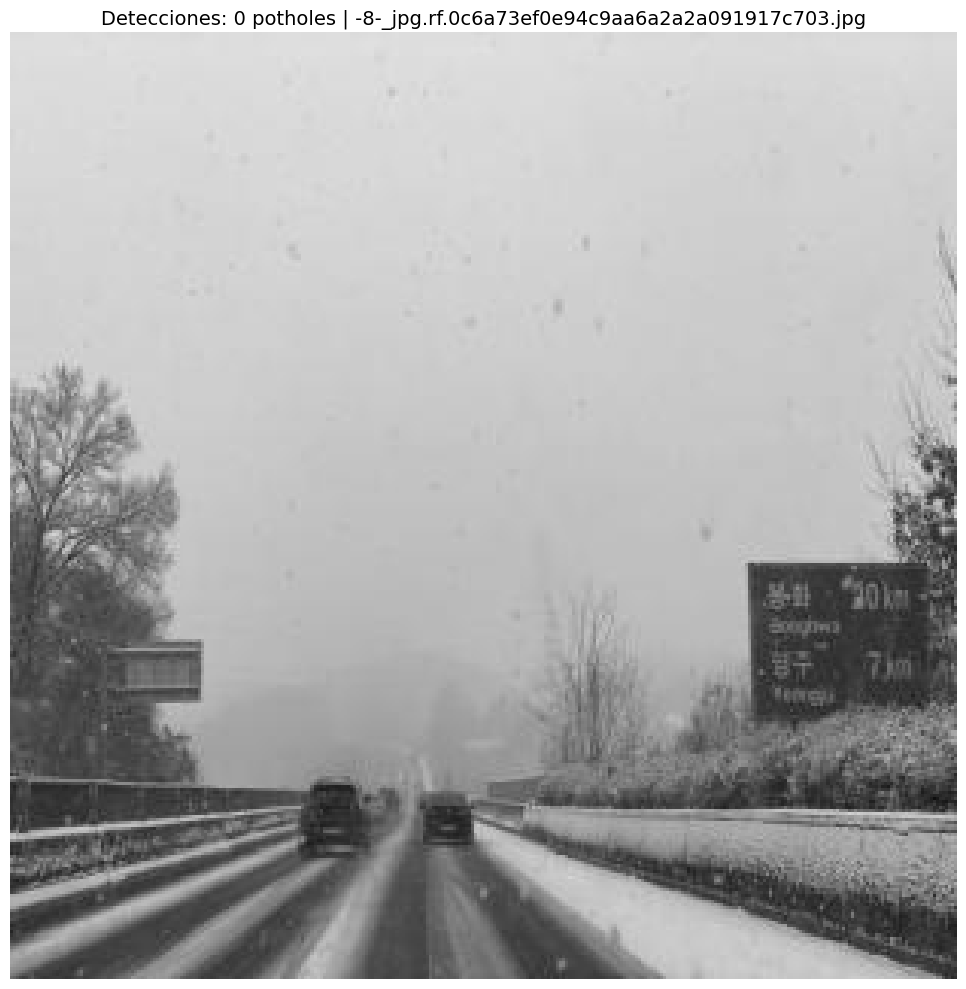


📷 Procesando [16/5]: -8-_jpg.rf.27ddb49e54517468a67f0b18f467c840.jpg
🕳️ Potholes detectados: 0


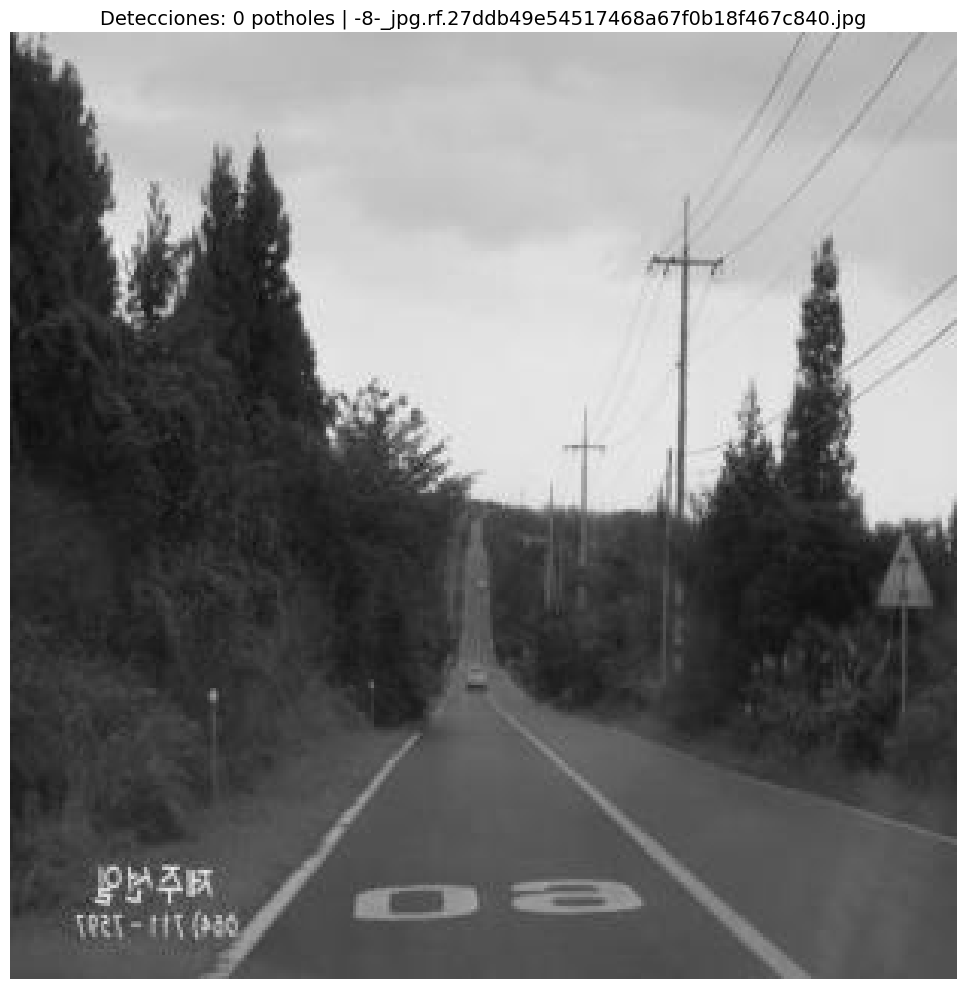


📷 Procesando [17/5]: 11_jpg.rf.5ebbca1179e053e9afca03d0f192a9b0.jpg
🕳️ Potholes detectados: 5
  1. Confianza: 87.13%
  2. Confianza: 77.96%
  3. Confianza: 71.41%
  4. Confianza: 55.04%
  5. Confianza: 52.07%


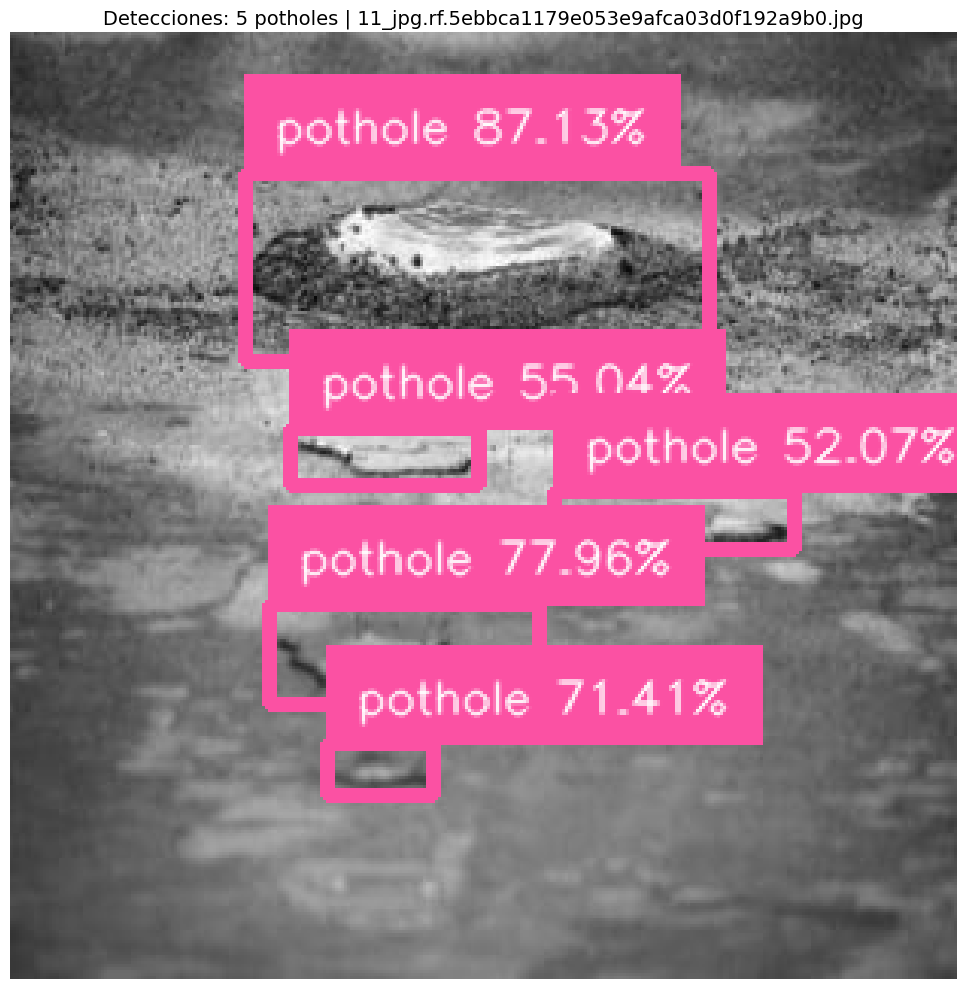


📷 Procesando [18/5]: 11_jpg.rf.804a55a36d5cc9a3ca49dfb8128c0ba2.jpg
🕳️ Potholes detectados: 5
  1. Confianza: 90.01%
  2. Confianza: 84.54%
  3. Confianza: 82.62%
  4. Confianza: 81.86%
  5. Confianza: 80.24%


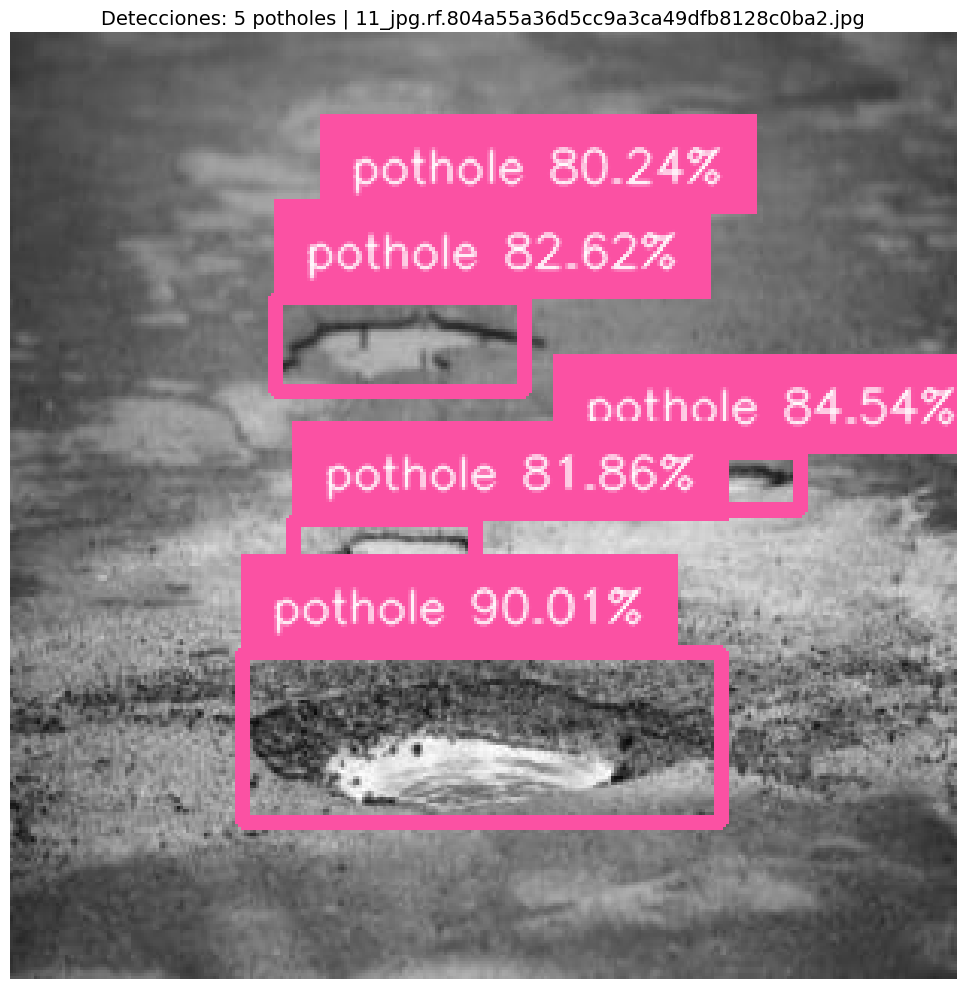


📷 Procesando [19/5]: 15_jpg.rf.c5fc1bb93a01ff2a3926827a09804c9b.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.08%


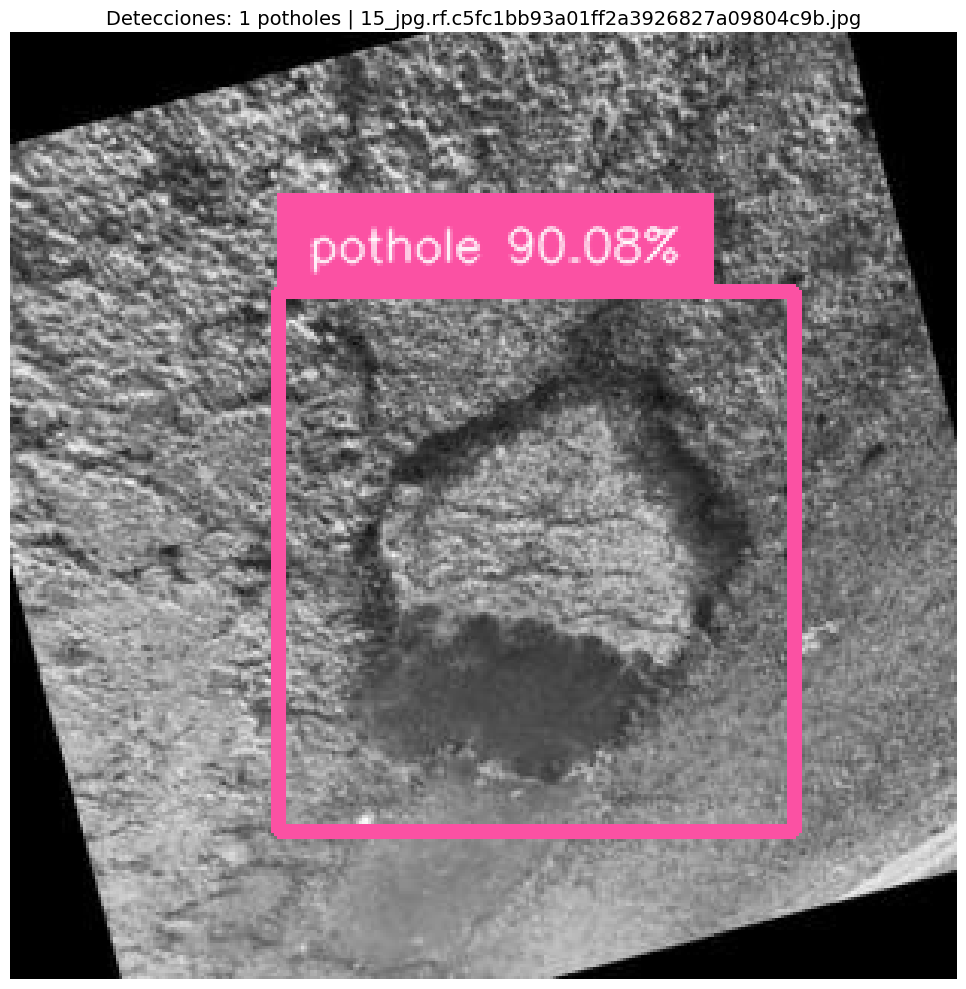


📷 Procesando [20/5]: 15_jpg.rf.e7ac8a277359c4f599e7432534cb5cd4.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.80%


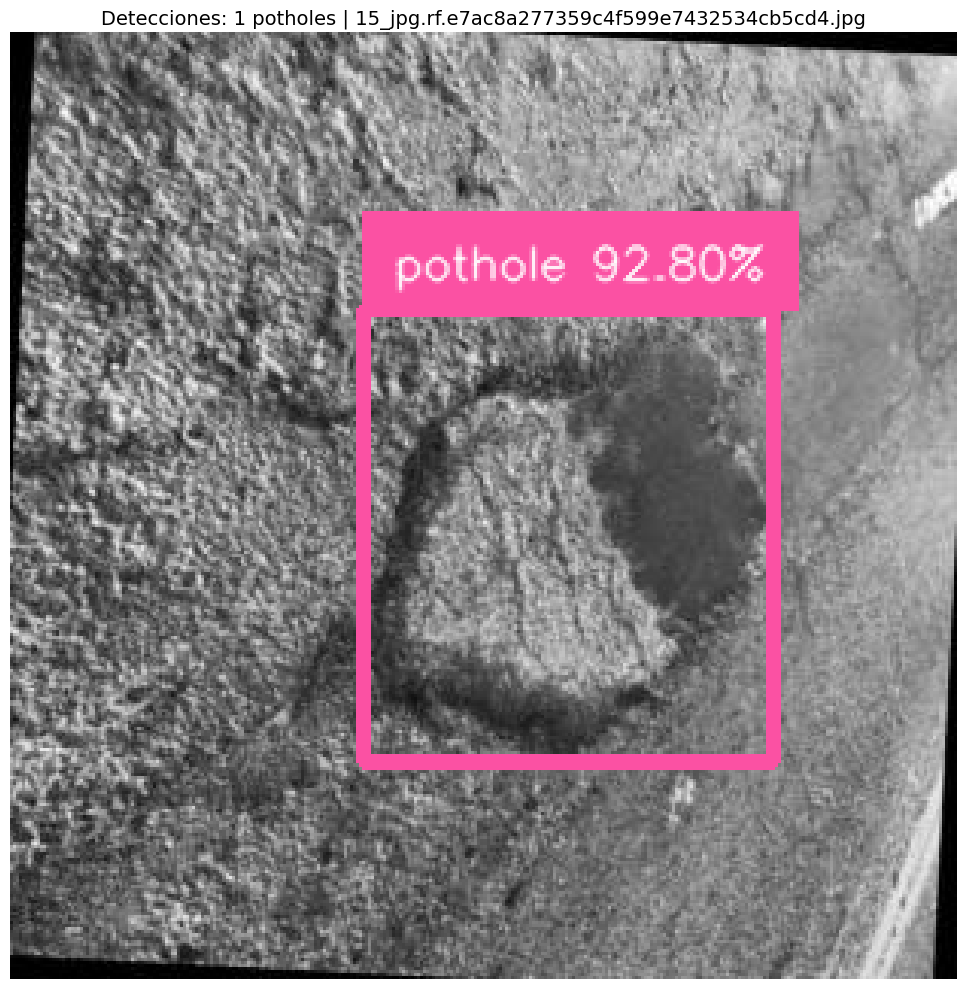


📷 Procesando [21/5]: 16_jpg.rf.8405a532d33916aca33eb19e3c6b59a6.jpg
🕳️ Potholes detectados: 7
  1. Confianza: 92.75%
  2. Confianza: 92.12%
  3. Confianza: 88.85%
  4. Confianza: 88.73%
  5. Confianza: 87.93%
  6. Confianza: 84.43%
  7. Confianza: 83.97%


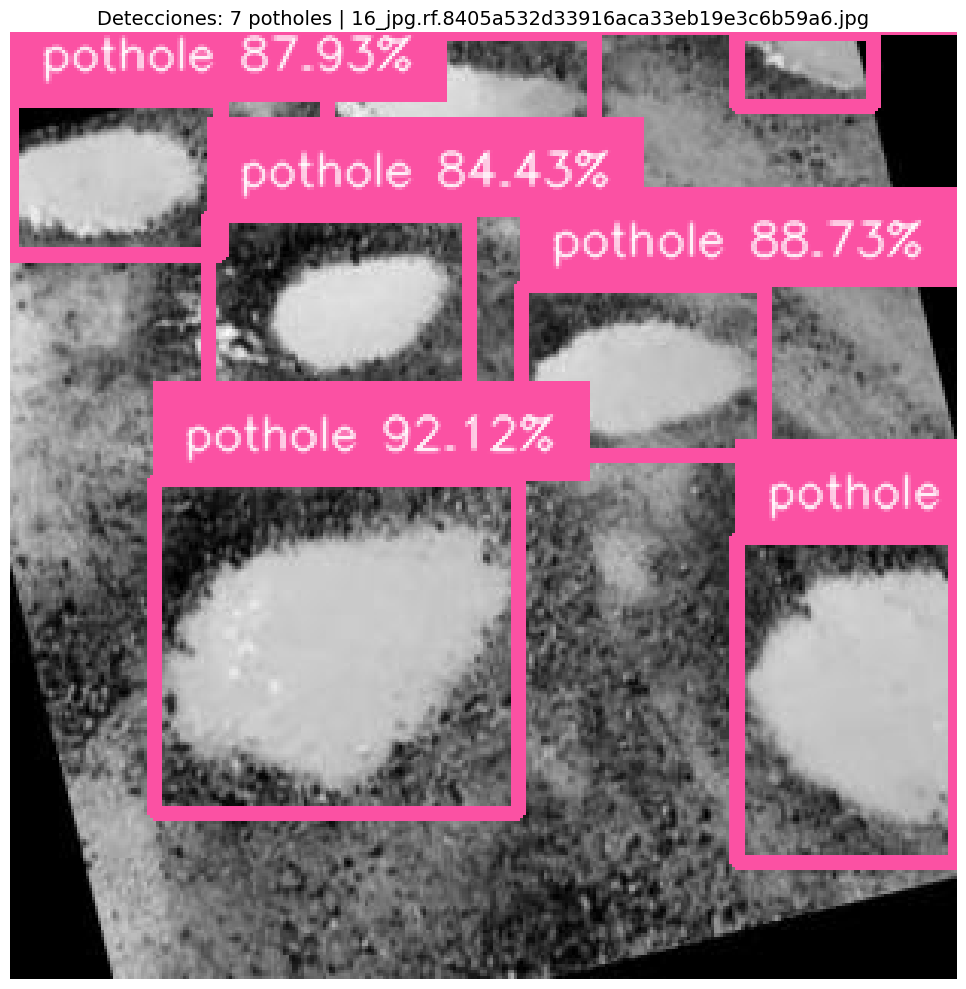


📷 Procesando [22/5]: 1_jpg.rf.de8343bc648c20226330f684c8eba2f6.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 86.99%
  2. Confianza: 86.05%


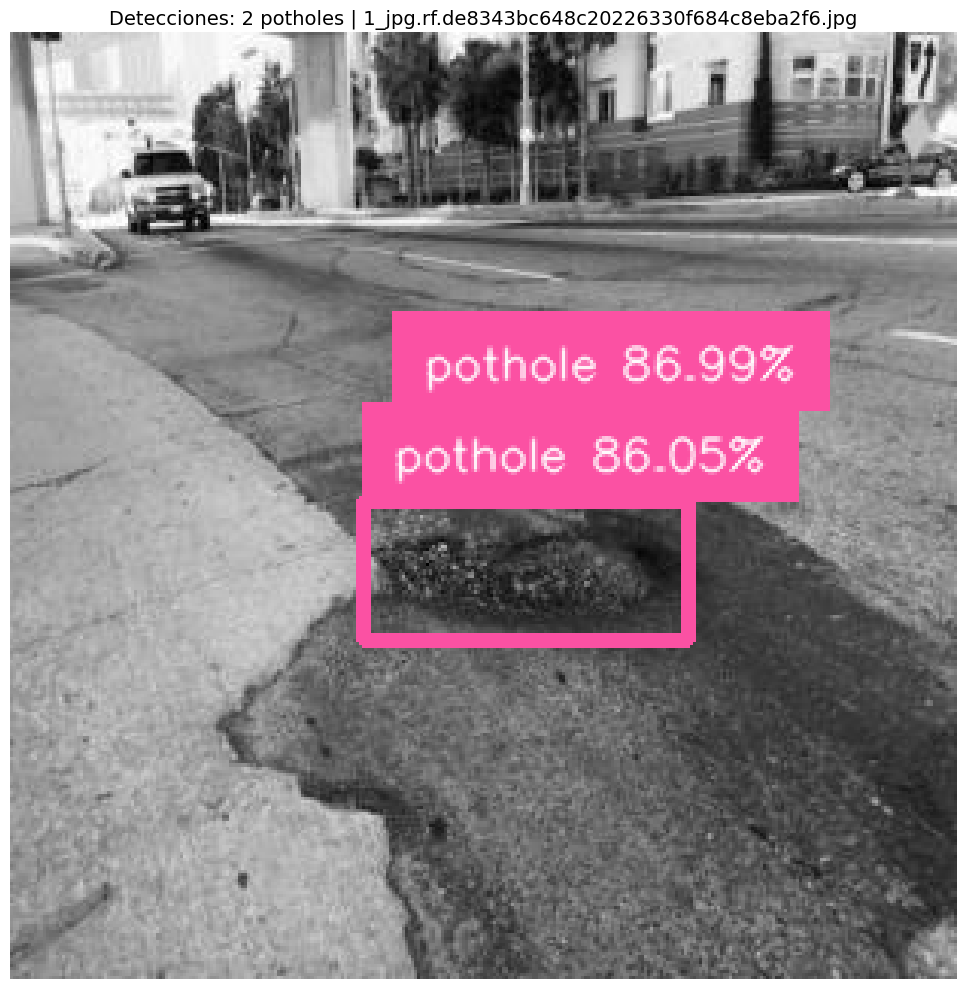


📷 Procesando [23/5]: 1_PNG_jpg.rf.6d5e22fdb7dfd682648e2d903e11c5ba.jpg
🕳️ Potholes detectados: 0


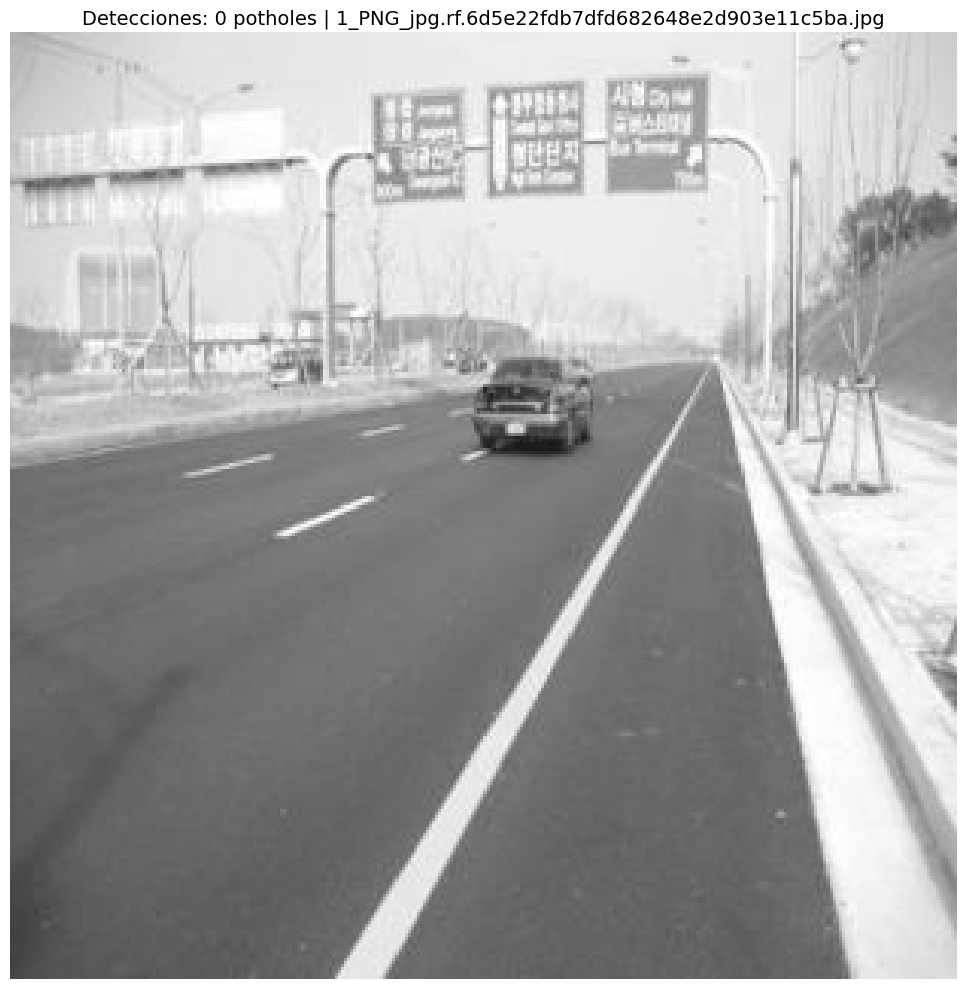


📷 Procesando [24/5]: 20_jpg.rf.2da59ce21d7040b15bb5bd8f6a202651.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 87.00%


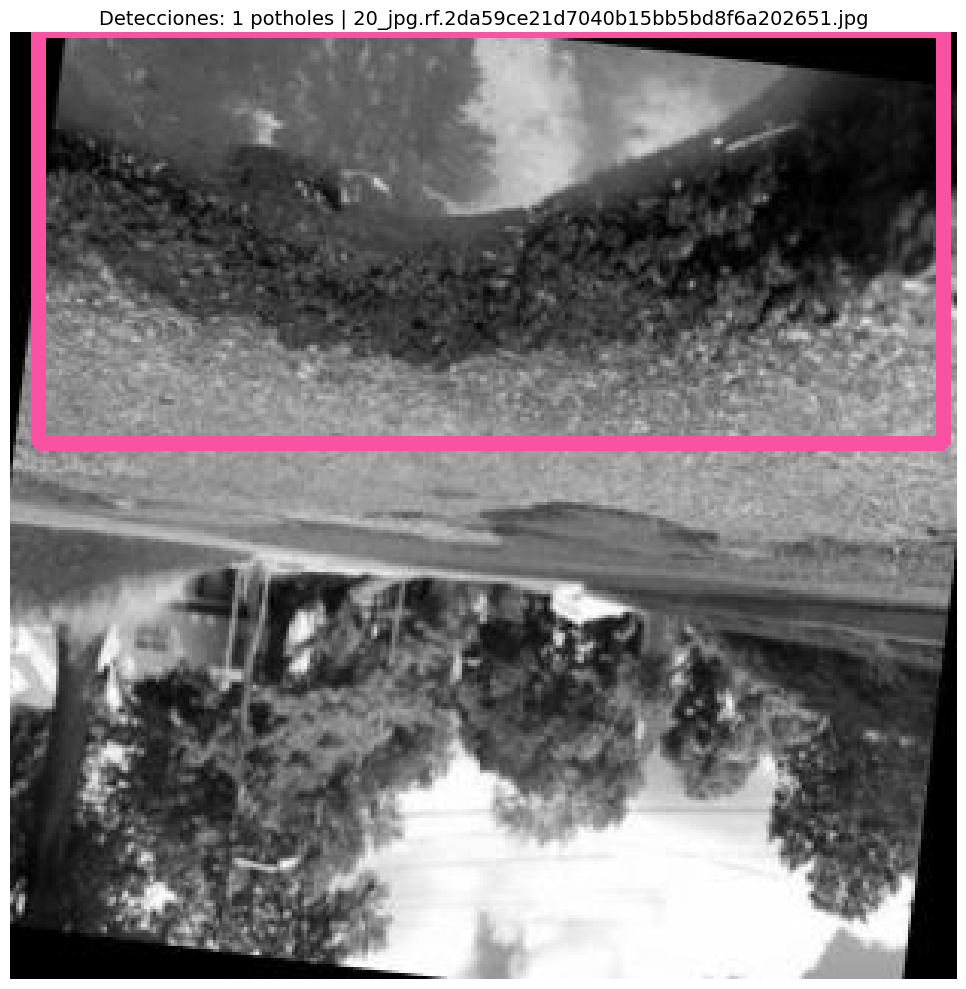


📷 Procesando [25/5]: 28_jpg.rf.2cddd4b41270b4908891fcbc49aa12f5.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 95.90%


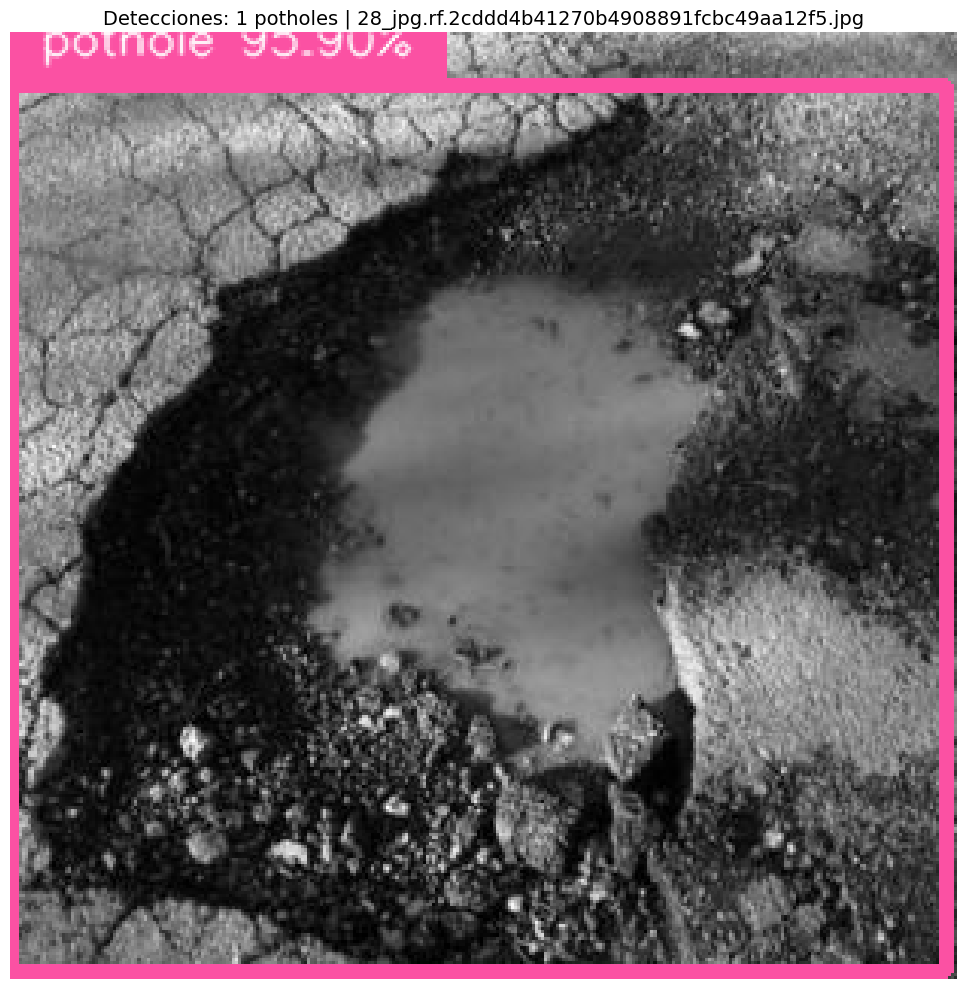


📷 Procesando [26/5]: 28_jpg.rf.ecfa379e3cb19fbc557255e555268879.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 95.63%


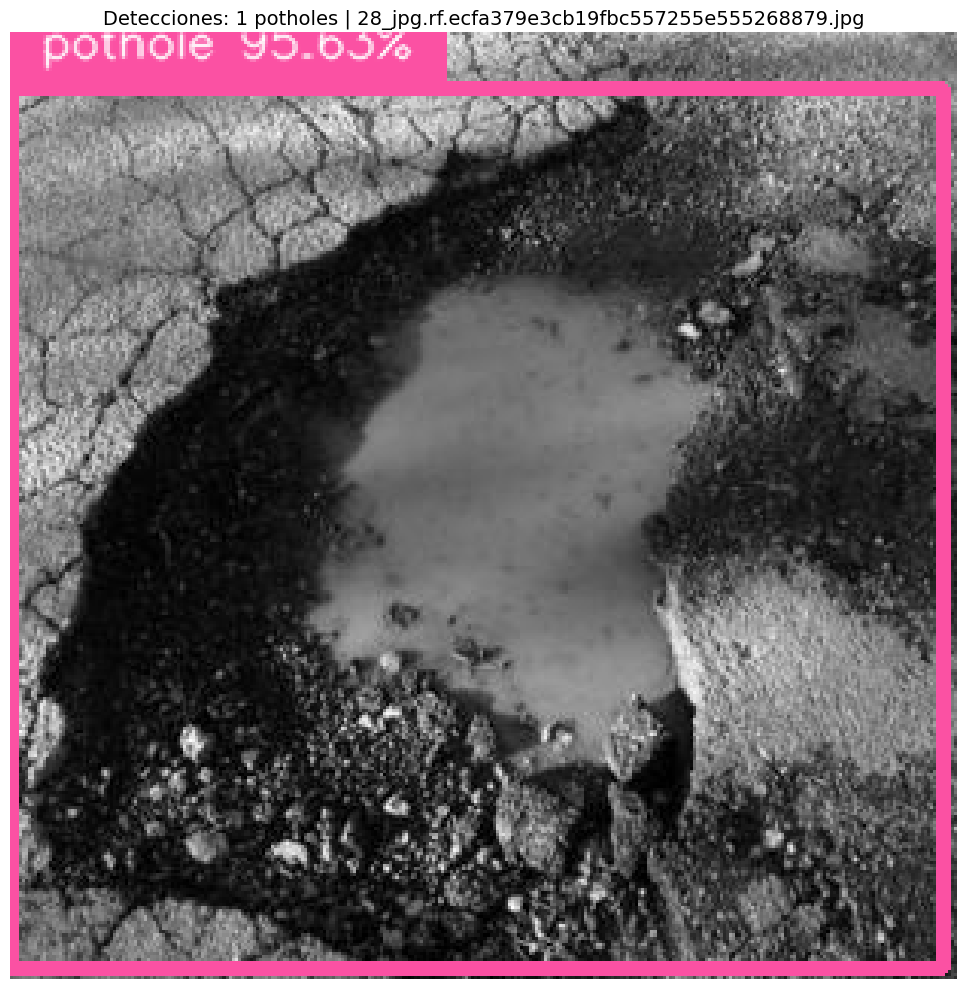


📷 Procesando [27/5]: 2_jpg.rf.76b54b55ede5b4d455adea46df4b8774.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.92%


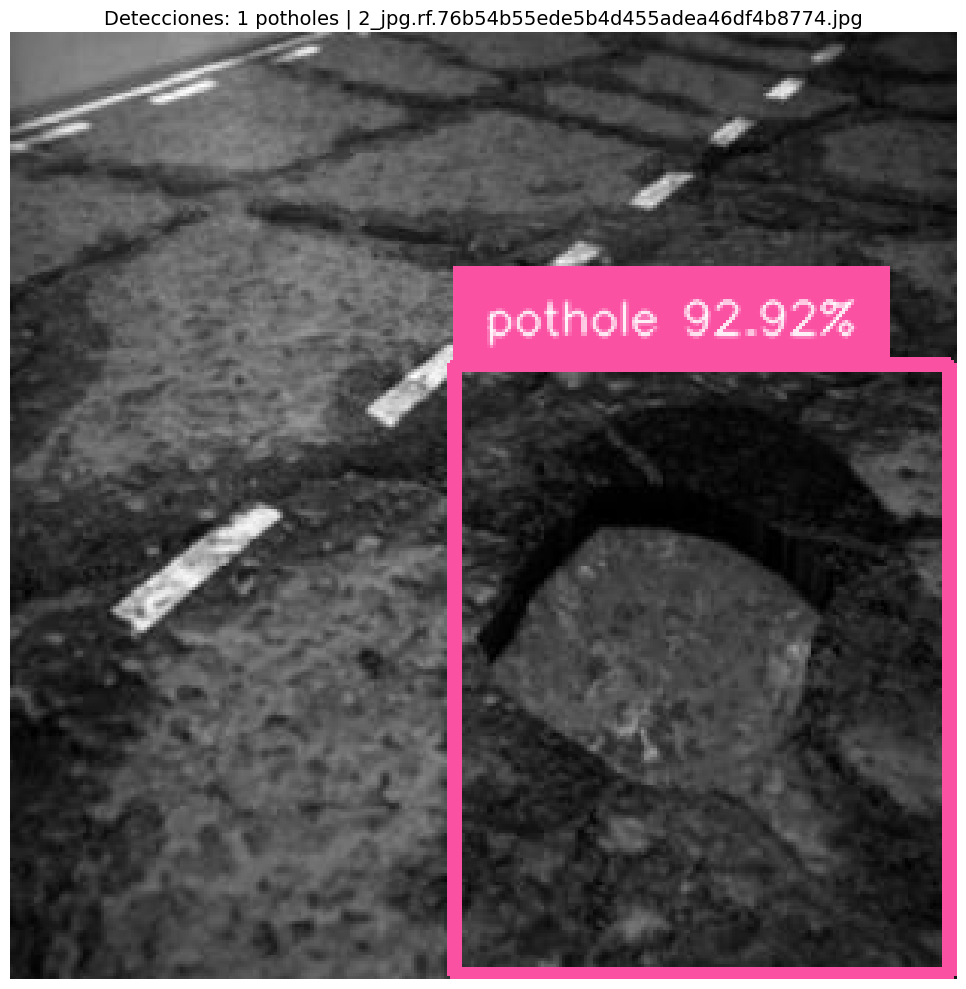


📷 Procesando [28/5]: 30_jpg.rf.05747c0c51d303915fb31dd74d4f230e.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 56.46%
  2. Confianza: 54.96%


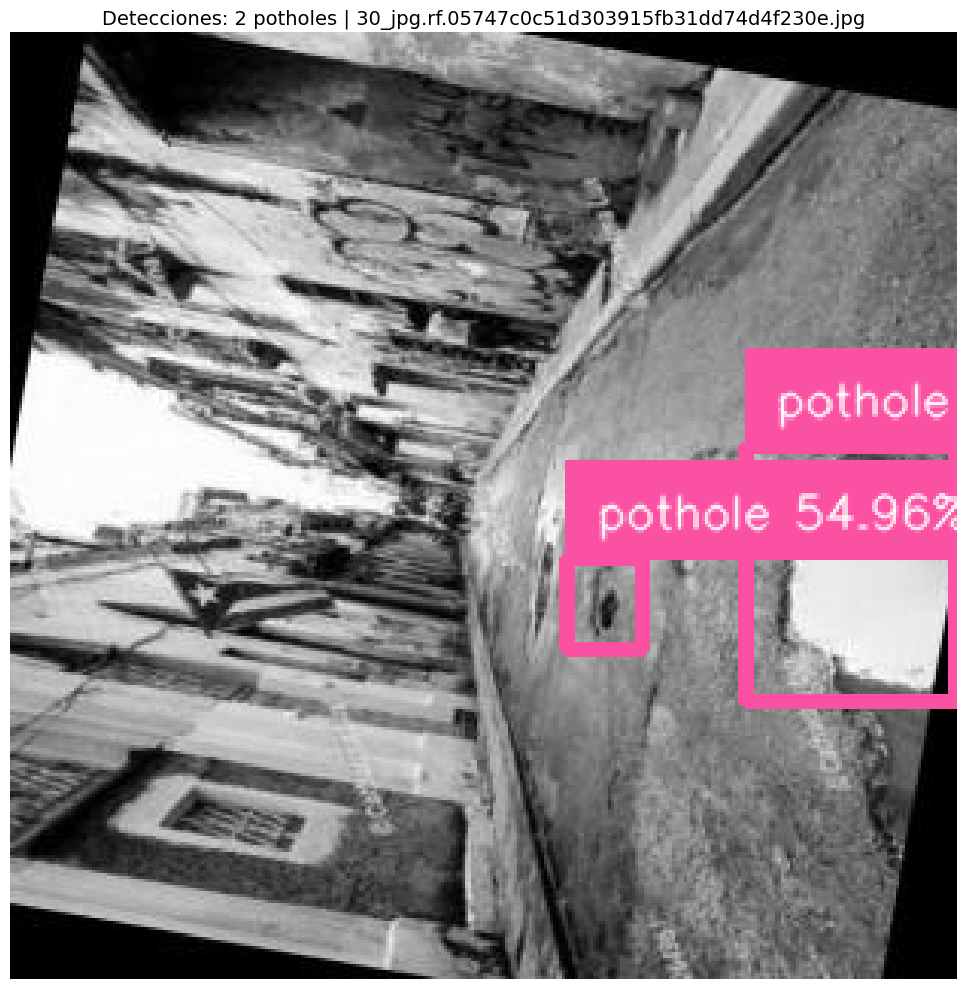


📷 Procesando [29/5]: 346641_357385_4719_jpg.rf.951375ed28d3a5379a2710478348c30b.jpg
🕳️ Potholes detectados: 0


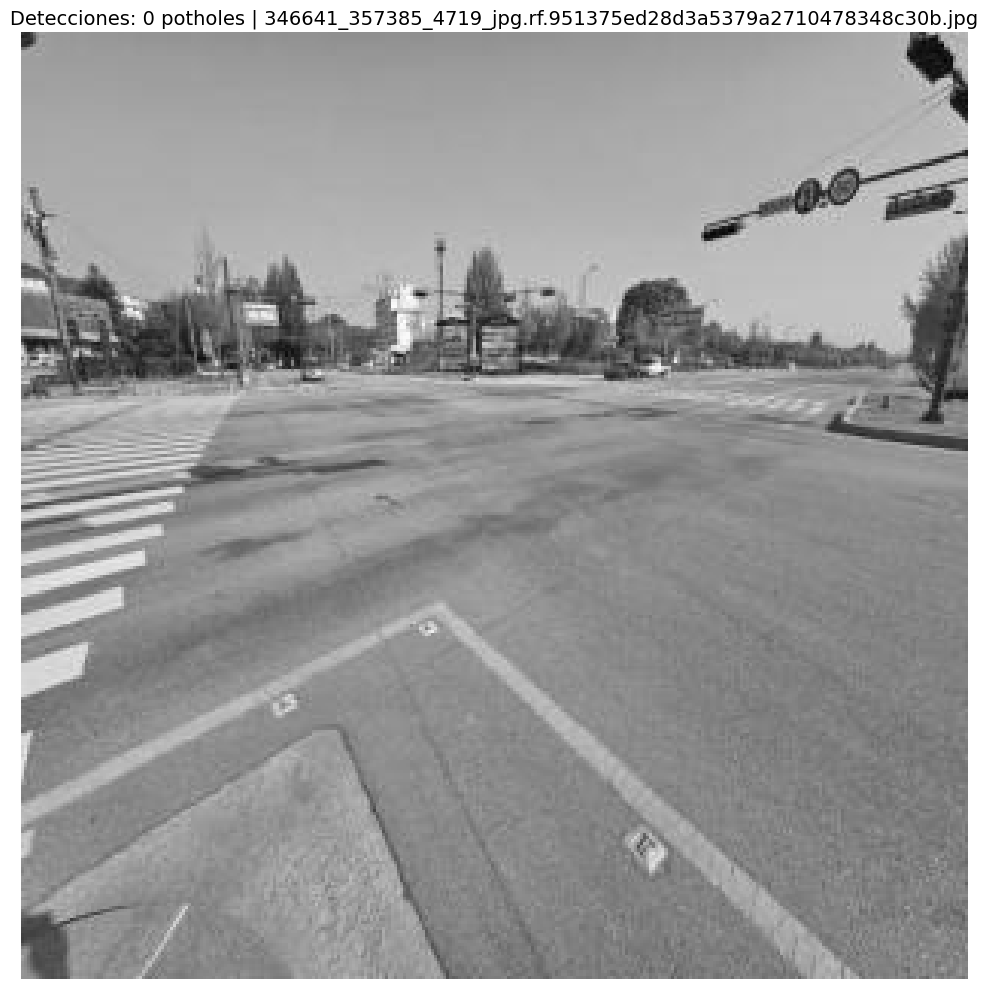


📷 Procesando [30/5]: 3_jpg.rf.bbd102ec97952f4b2838609aefcab1ce.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.65%


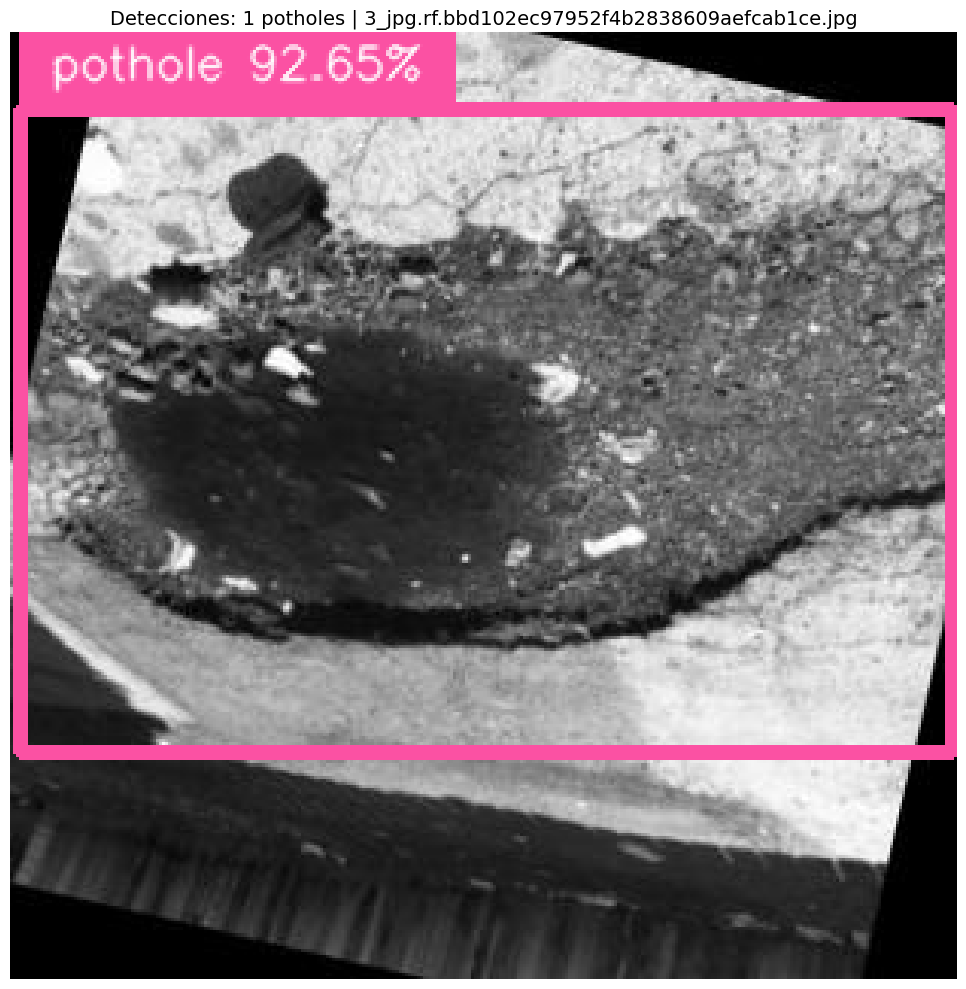


📷 Procesando [31/5]: 6_jpg.rf.9248ed2e8a8cf1fe18b3549ee2937b53.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 91.67%


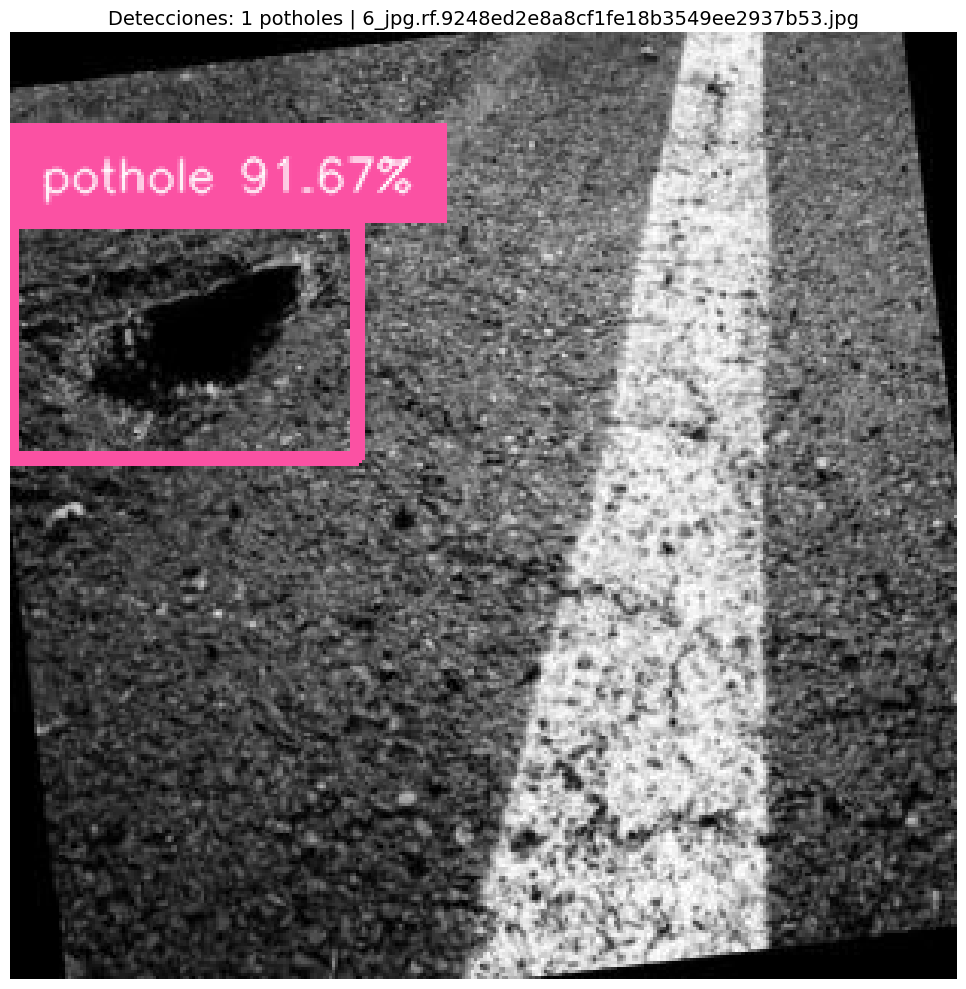


📷 Procesando [32/5]: 8_jpg.rf.8c9240ea63b367072e82f5143b2cbeee.jpg
🕳️ Potholes detectados: 5
  1. Confianza: 90.85%
  2. Confianza: 90.69%
  3. Confianza: 89.68%
  4. Confianza: 86.86%
  5. Confianza: 86.38%


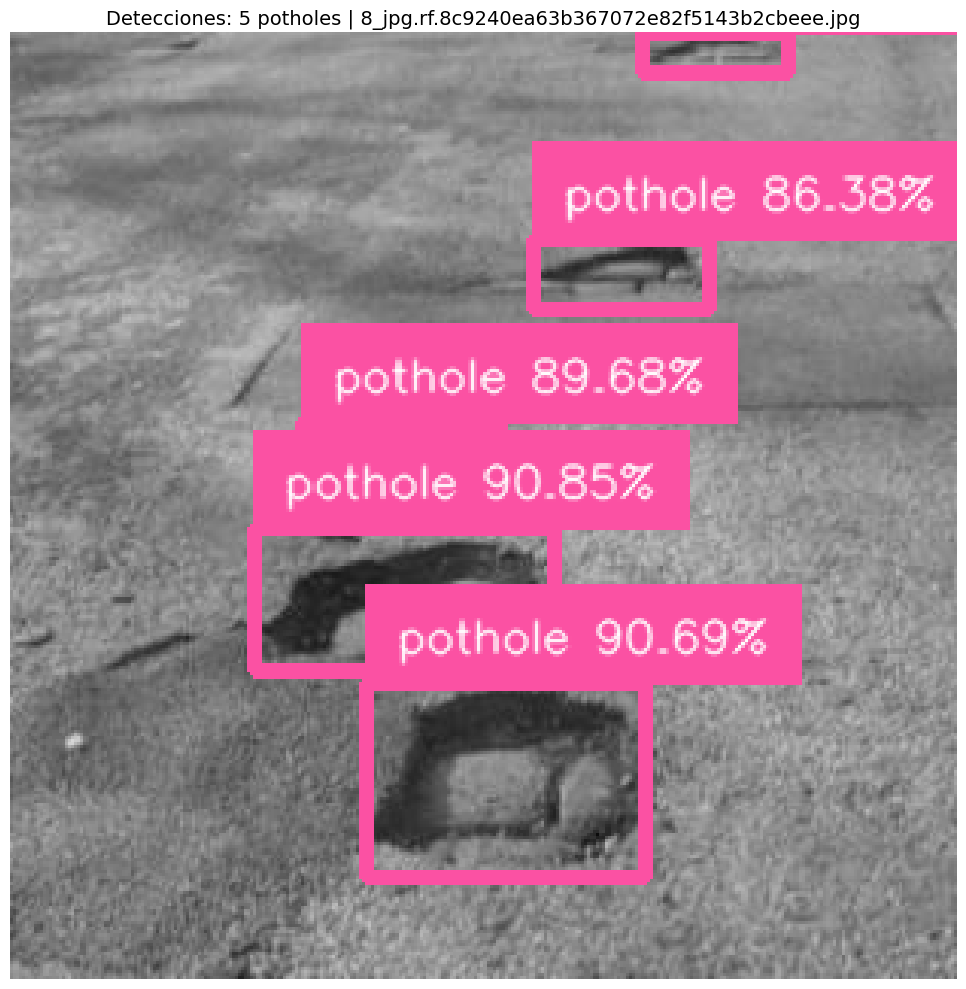


📷 Procesando [33/5]: 9_jpg.rf.dca6c59b8a1f7bf31cc824087c39bdf7.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 89.17%
  2. Confianza: 87.34%
  3. Confianza: 81.26%
  4. Confianza: 53.71%


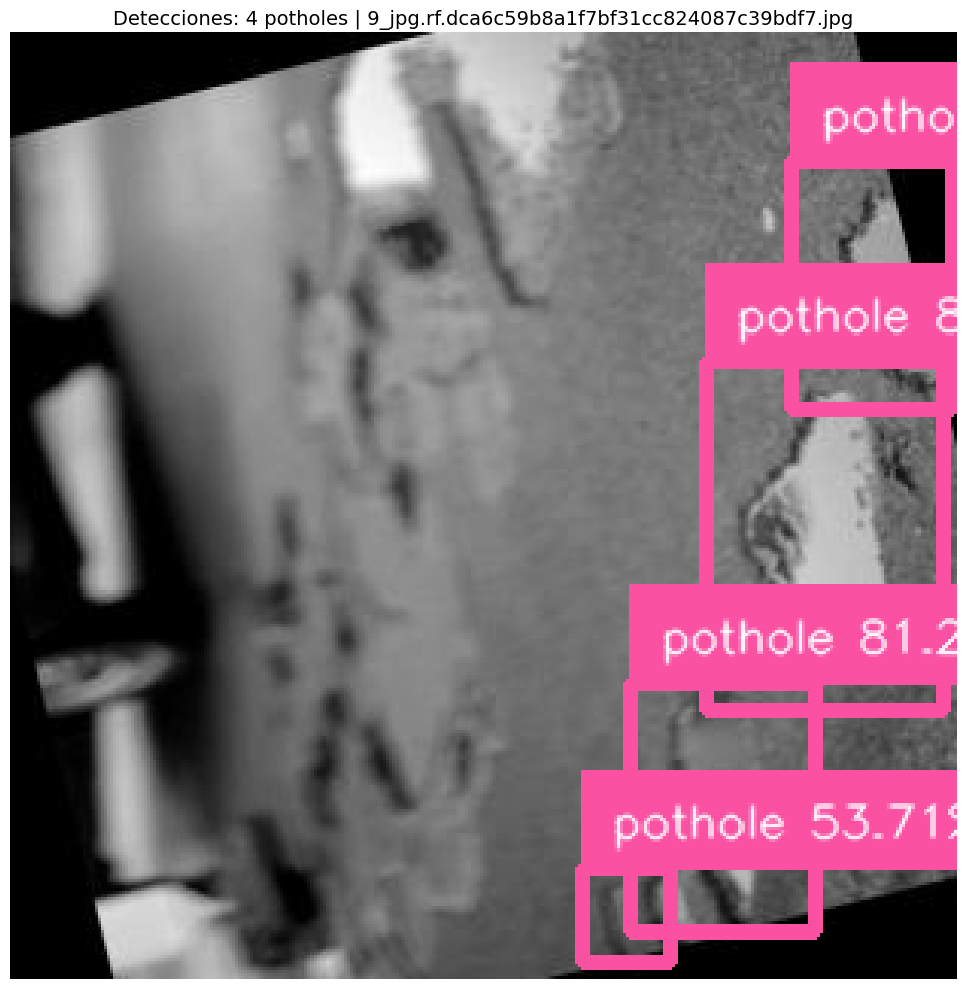


📷 Procesando [34/5]: download-8-_jpeg_jpg.rf.c061f2e3cffa0a2b8fd6424ac34ee031.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.50%


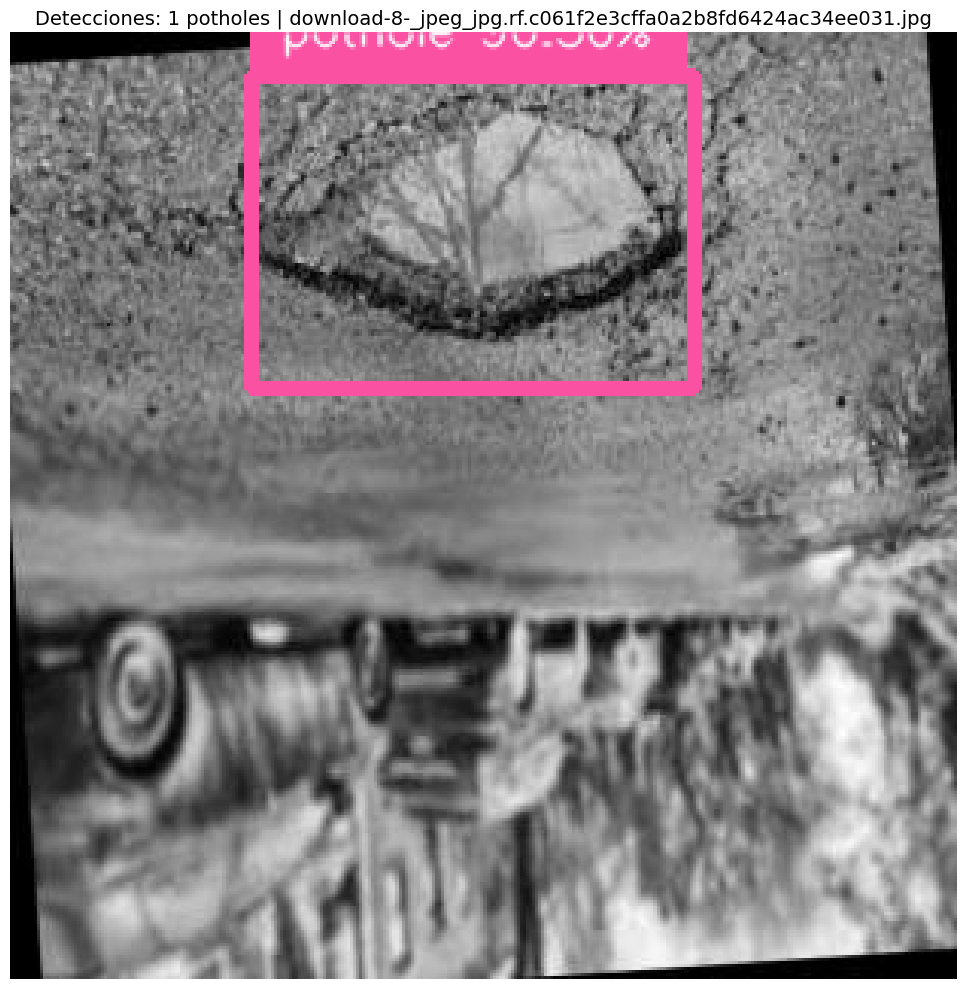


📷 Procesando [35/5]: download_jpeg_jpg.rf.0f83b9914e4670bde92a9bb7bd1831bf.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.07%


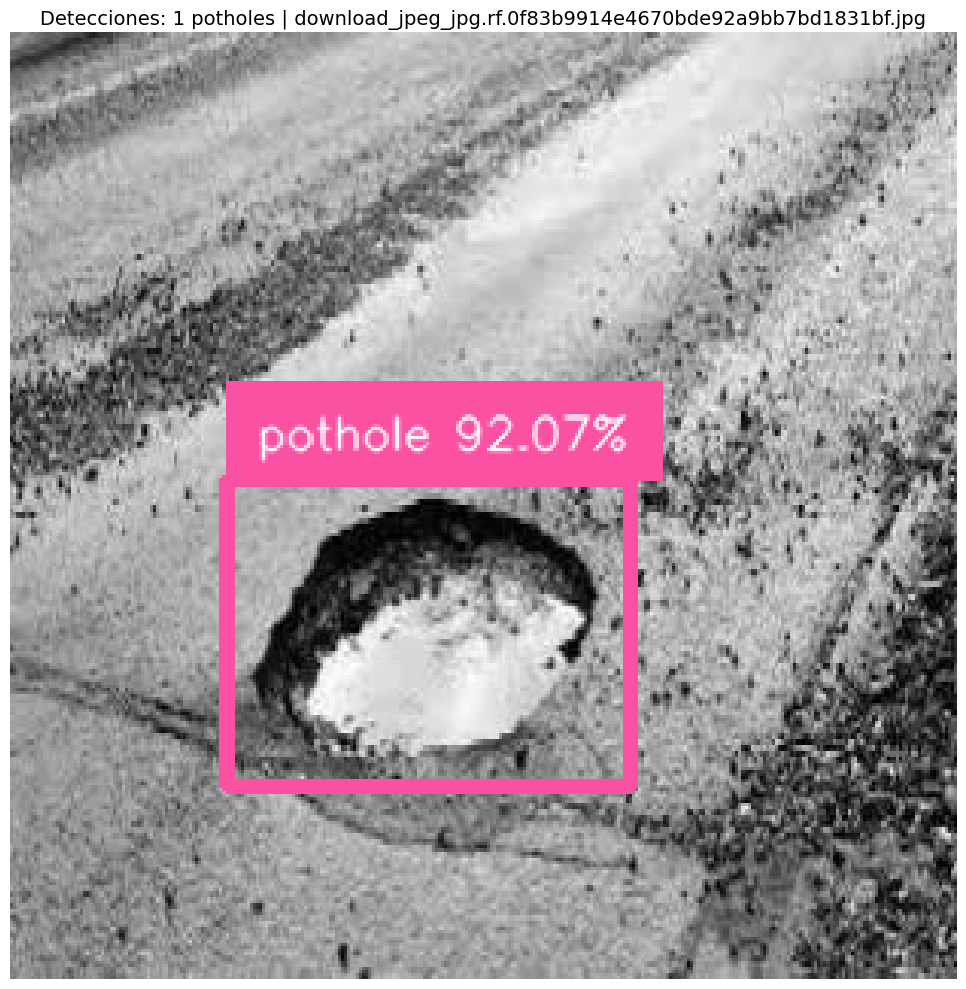


📷 Procesando [36/5]: dry00057_jpg.rf.054ffa8dbea6796798af0603c6ae9658.jpg
🕳️ Potholes detectados: 0


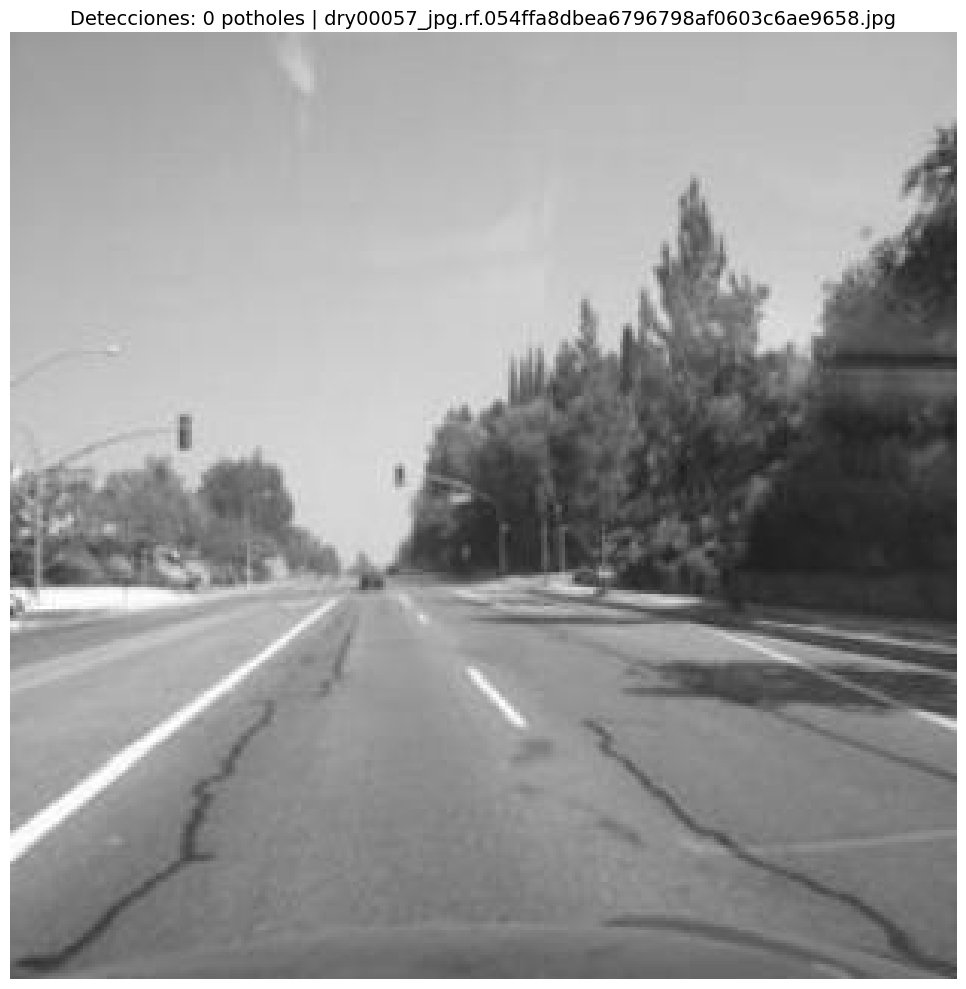


📷 Procesando [37/5]: dry00077_jpg.rf.afec777c57a171b1ee55e87b7c4d29b7.jpg
🕳️ Potholes detectados: 0


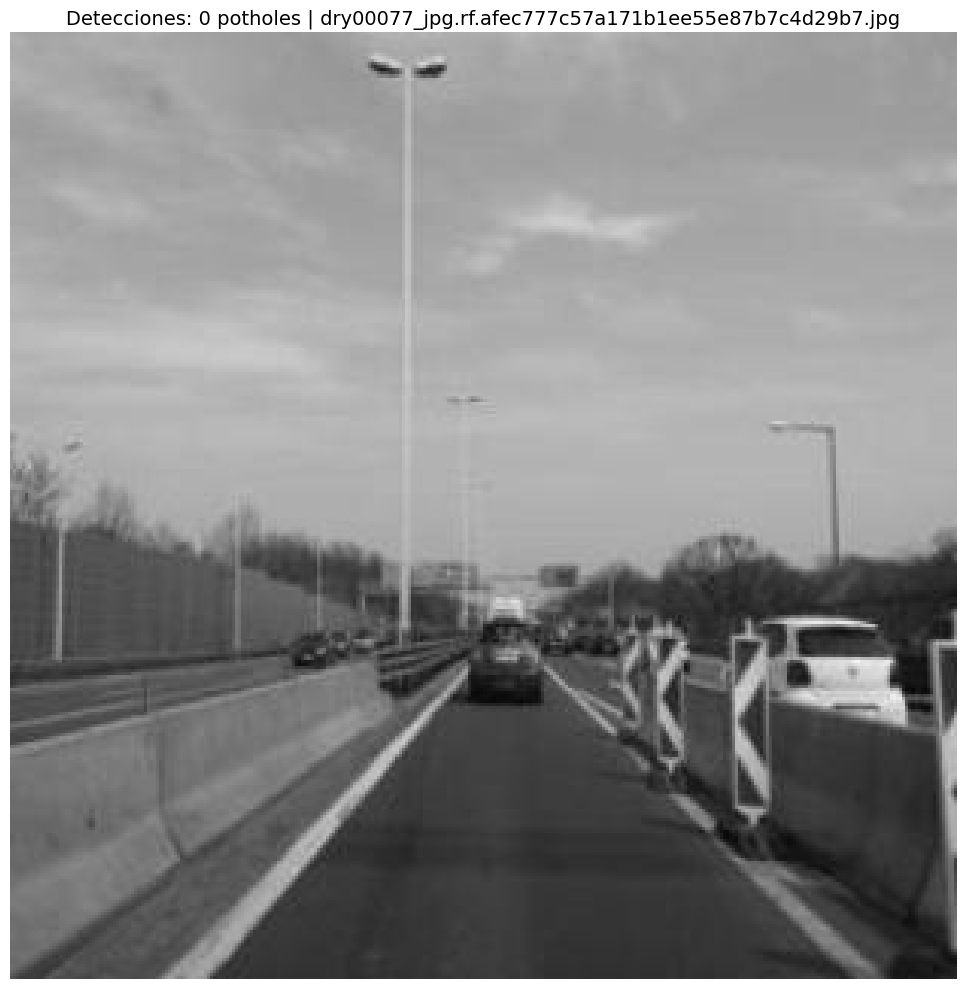


📷 Procesando [38/5]: dry00082_jpg.rf.ace534dca219789945005a59fd1a1ef1.jpg
🕳️ Potholes detectados: 0


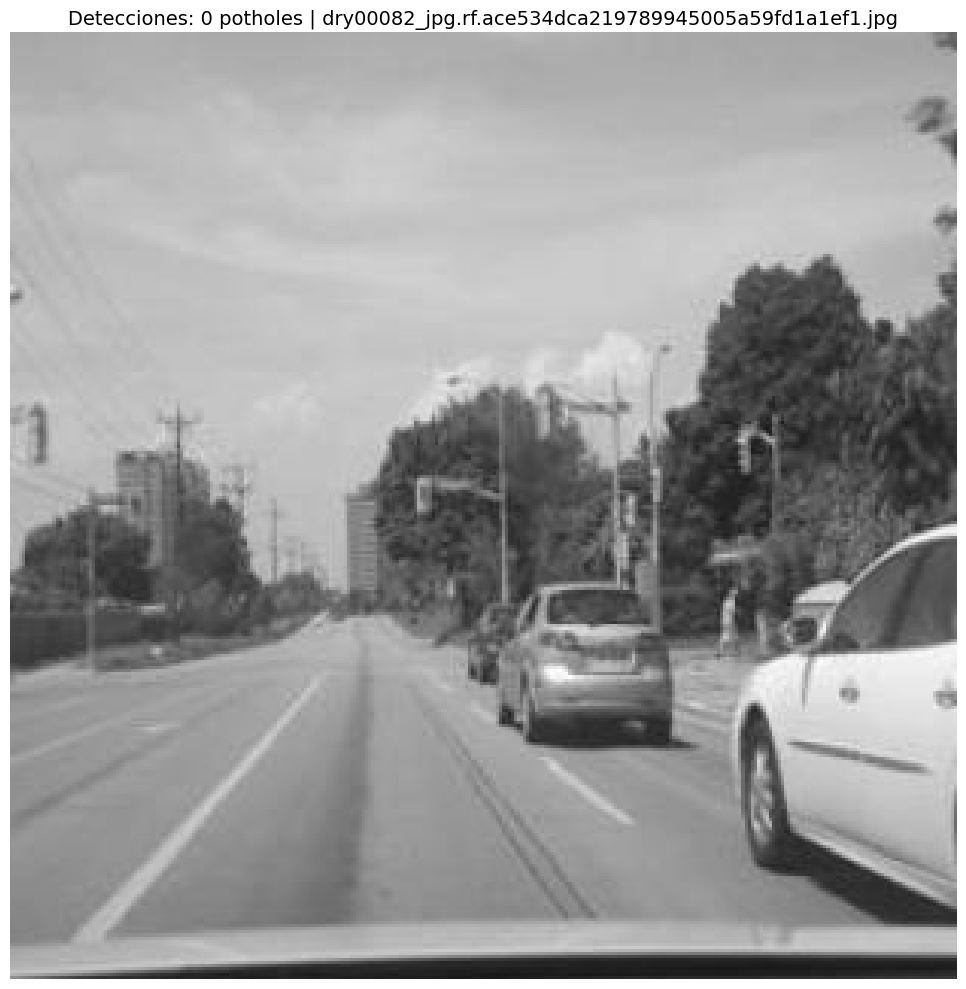


📷 Procesando [39/5]: dry00114_jpg.rf.2146da5db2b461be4f49d942ef0bd060.jpg
🕳️ Potholes detectados: 0


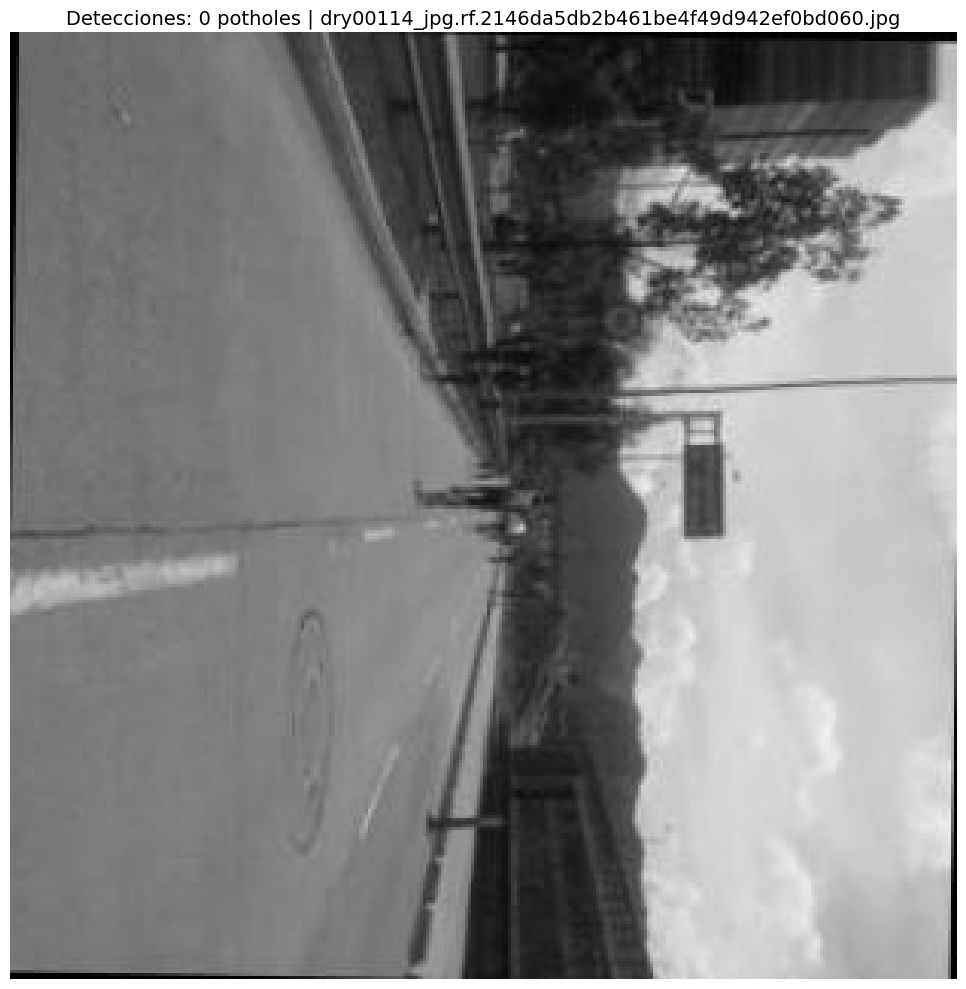


📷 Procesando [40/5]: dry00155_jpg.rf.8cf1c3f224f045105d34290c653abba0.jpg
🕳️ Potholes detectados: 0


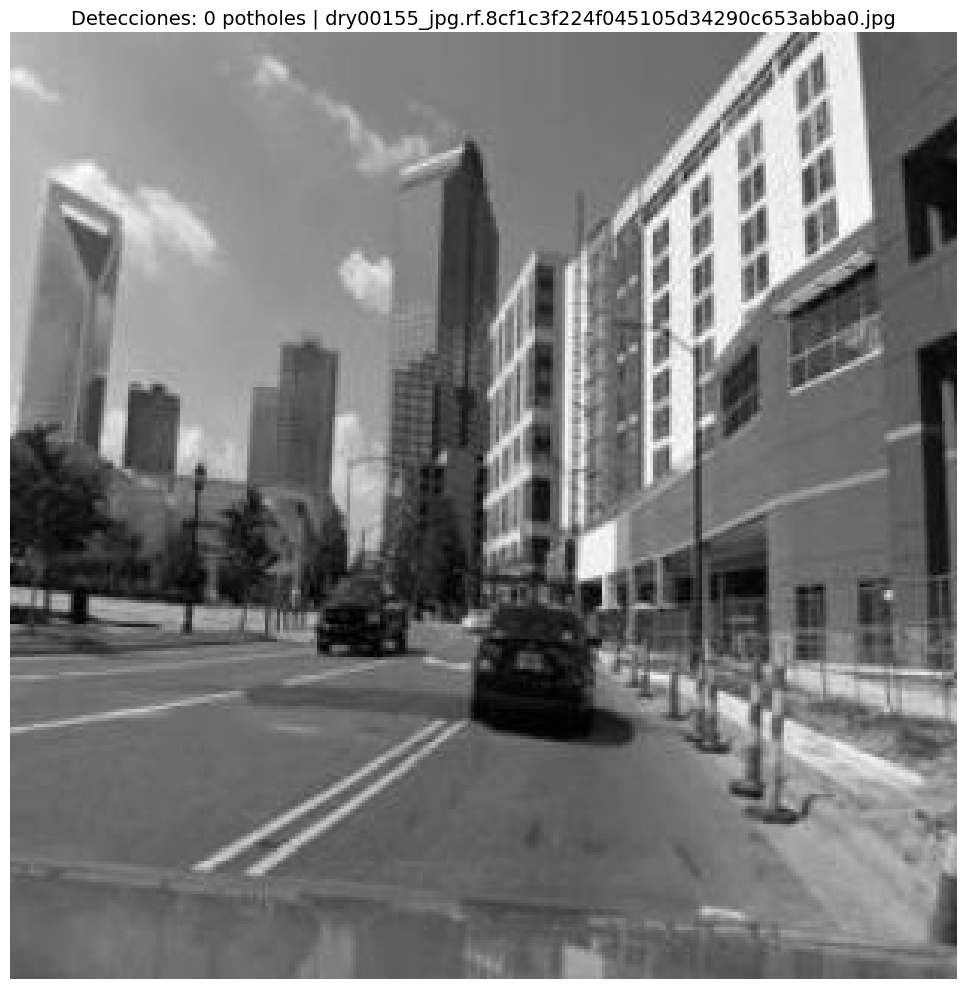


📷 Procesando [41/5]: f56589dc-7d3c-4b36-8487-3e6c3859c722_jpg.rf.5cdeb4ea4ec5e144d5d2ee4576abb2be.jpg
🕳️ Potholes detectados: 0


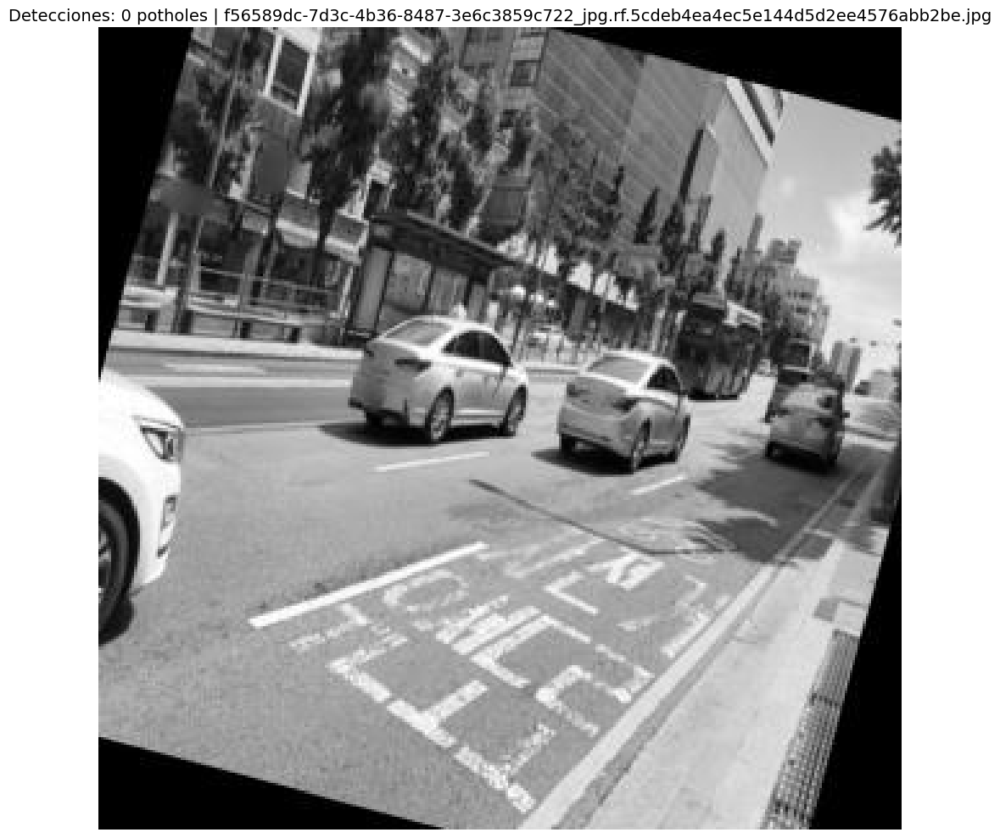


📷 Procesando [42/5]: images-17-_jpeg_jpg.rf.b2b21da620ce0b54428b05b602645ff5.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.77%


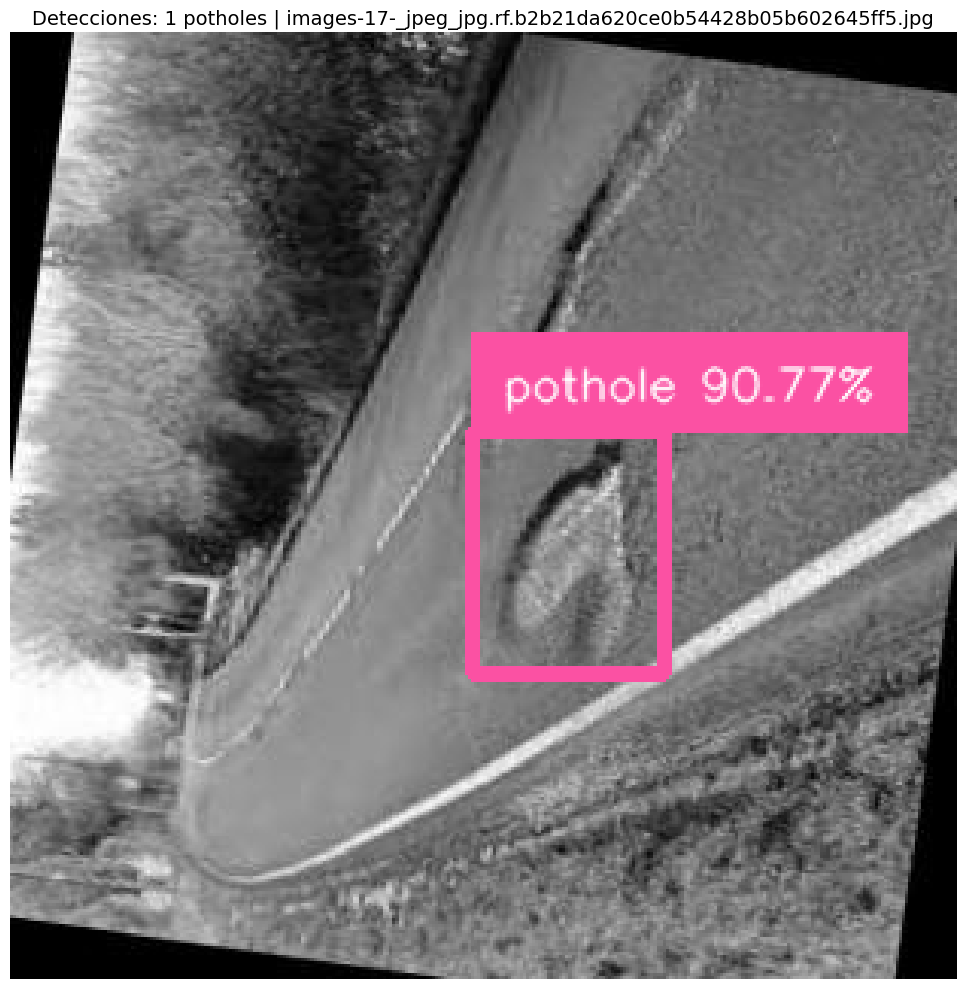


📷 Procesando [43/5]: images-18-_jpeg_jpg.rf.3a9e74bd3522264b1d886df5a4c09499.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 86.14%
  2. Confianza: 85.98%
  3. Confianza: 83.22%


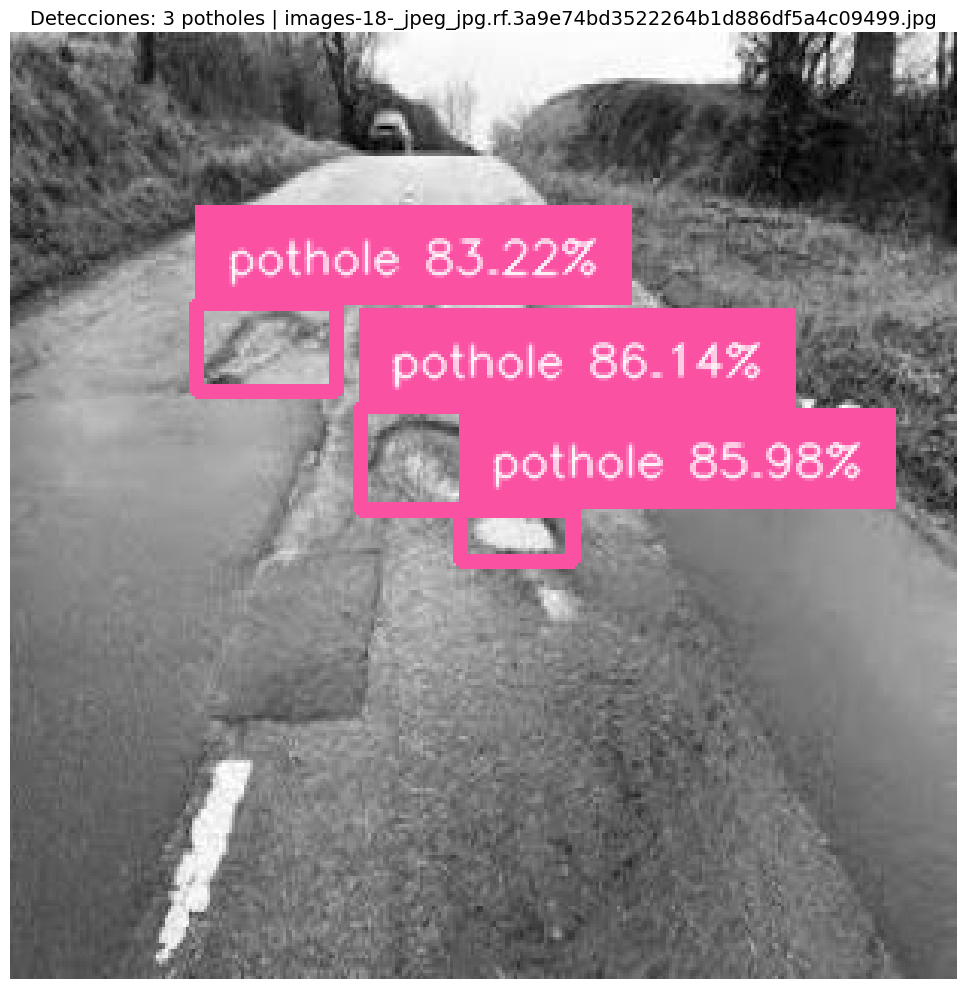


📷 Procesando [44/5]: images-20-_jpeg_jpg.rf.6c810df86a136cb8ee7865a5cf2fb9ec.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.29%


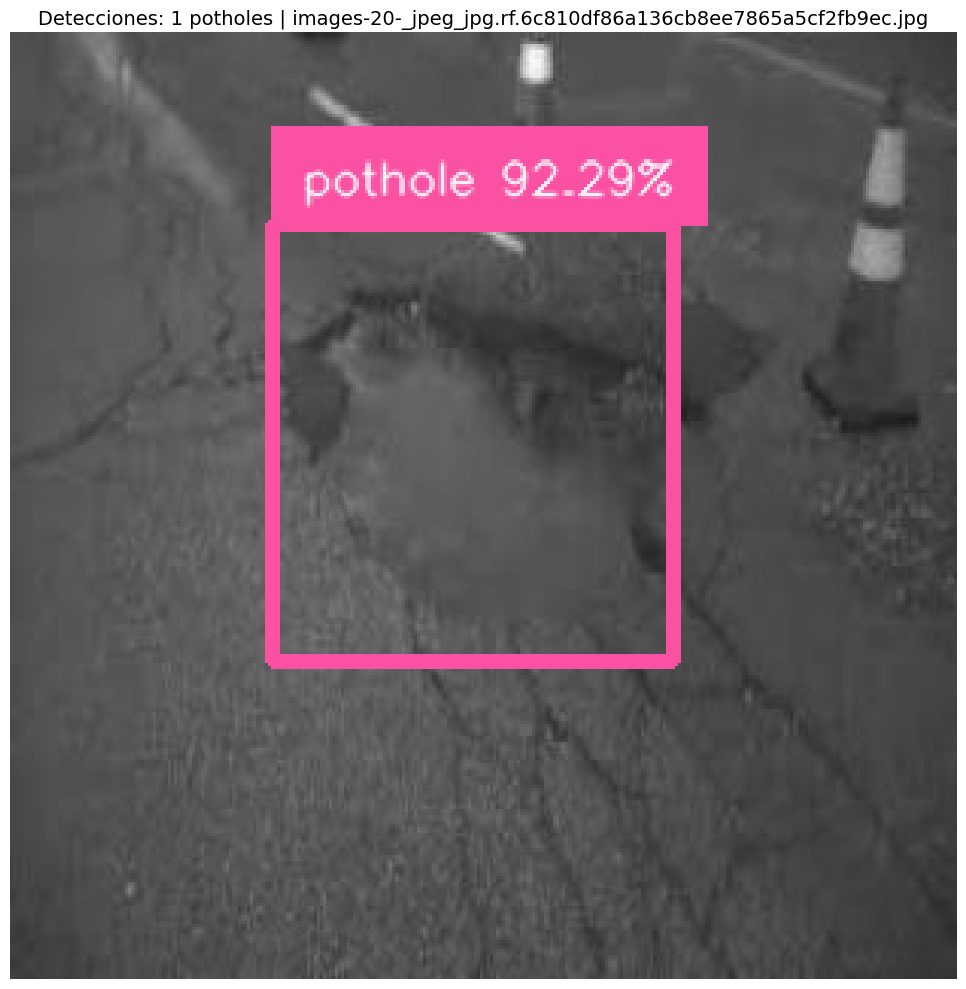


📷 Procesando [45/5]: images-24-_jpeg_jpg.rf.3261599549109823ef5a6508a5ccb5c0.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.08%


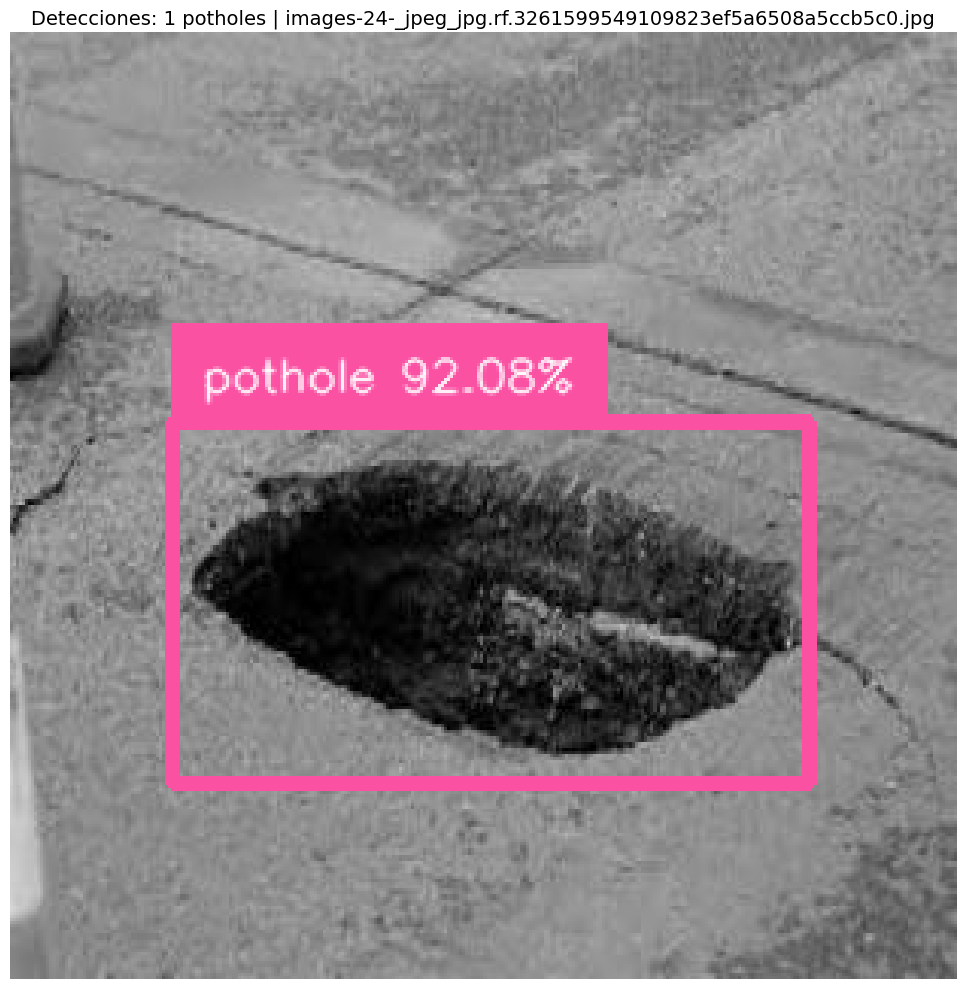


📷 Procesando [46/5]: images-31-_jpeg_jpg.rf.7e46d7111c3f64ee5aadde2c25c46d06.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 92.47%
  2. Confianza: 76.05%


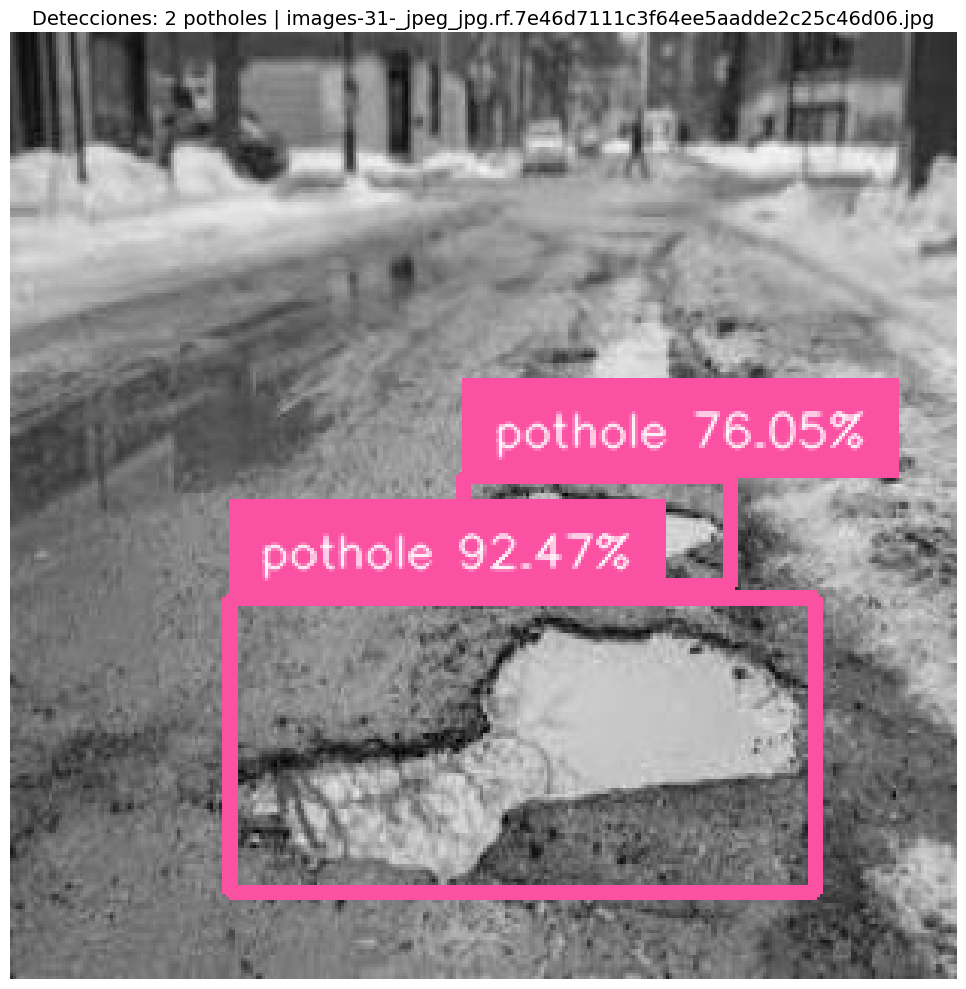


📷 Procesando [47/5]: images-5-_jpeg_jpg.rf.7206dbee1373548d5491d75ab48a9356.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 94.09%


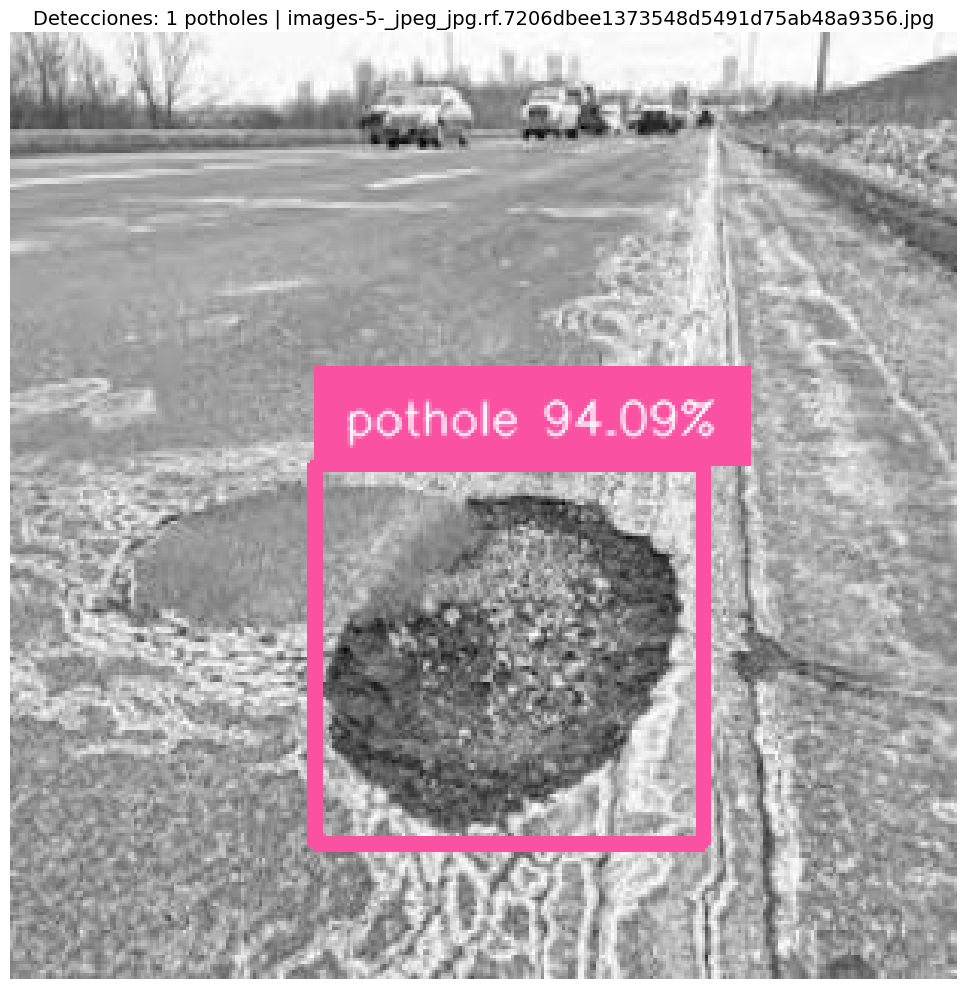


📷 Procesando [48/5]: images-5-_jpeg_jpg.rf.fde2fdaa0f7f342084f33886df56d098.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 94.13%


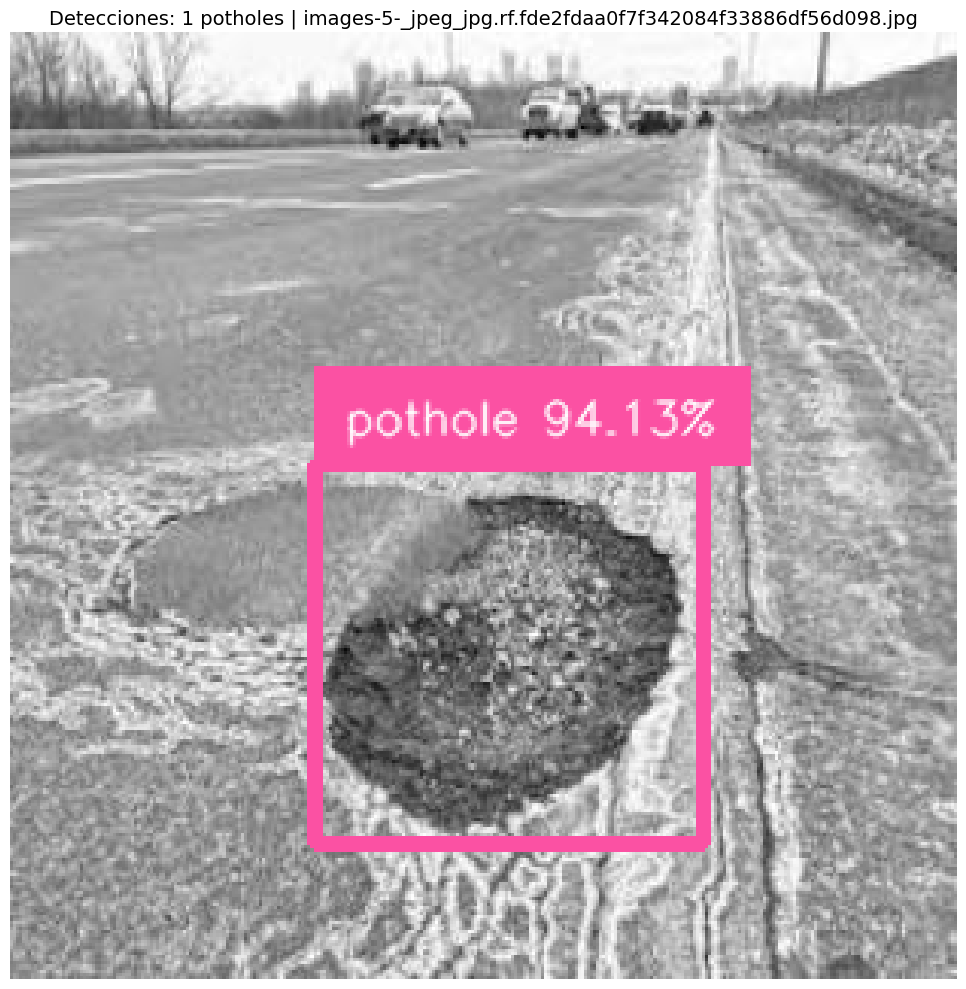


📷 Procesando [49/5]: images173_jpg.rf.9f6596acfc29ad7caa96ab1c700960b6.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 92.90%
  2. Confianza: 90.73%
  3. Confianza: 81.55%


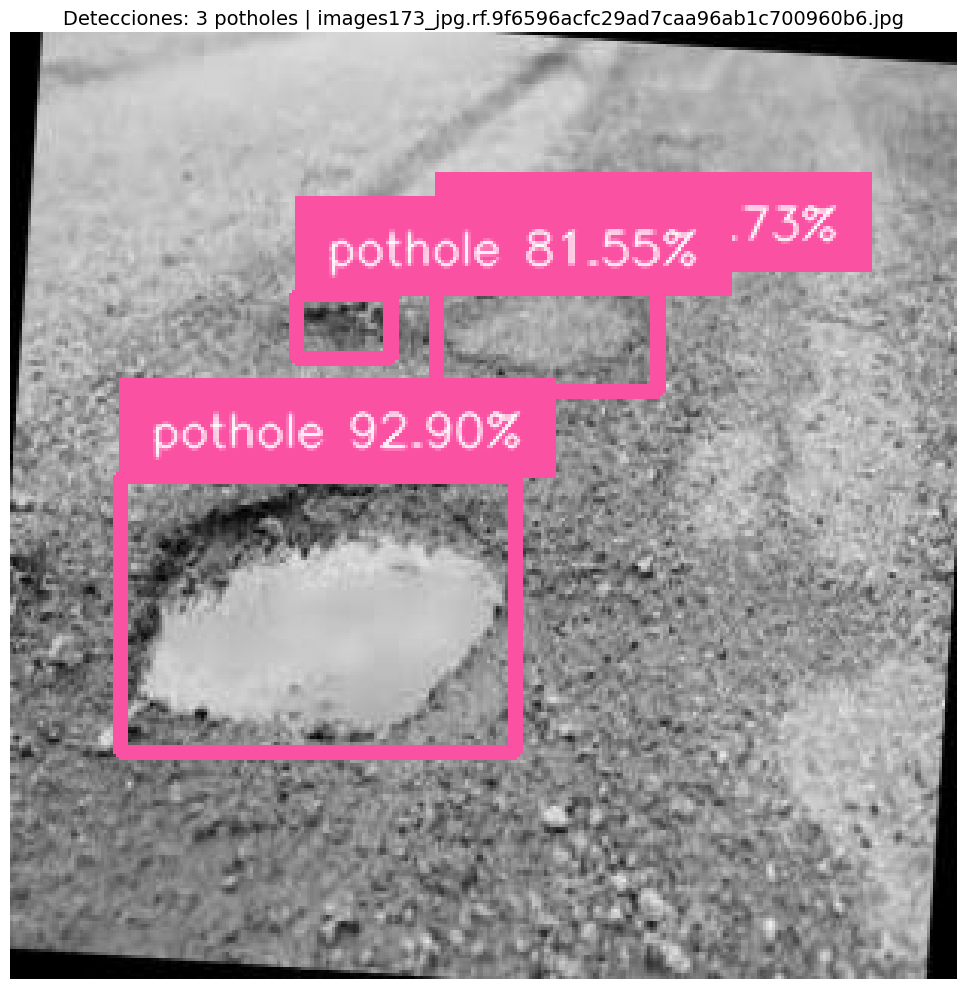


📷 Procesando [50/5]: images175_jpg.rf.bfebff12b9a8f548cc83400b59a99429.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 88.28%
  2. Confianza: 88.17%
  3. Confianza: 85.21%
  4. Confianza: 79.96%


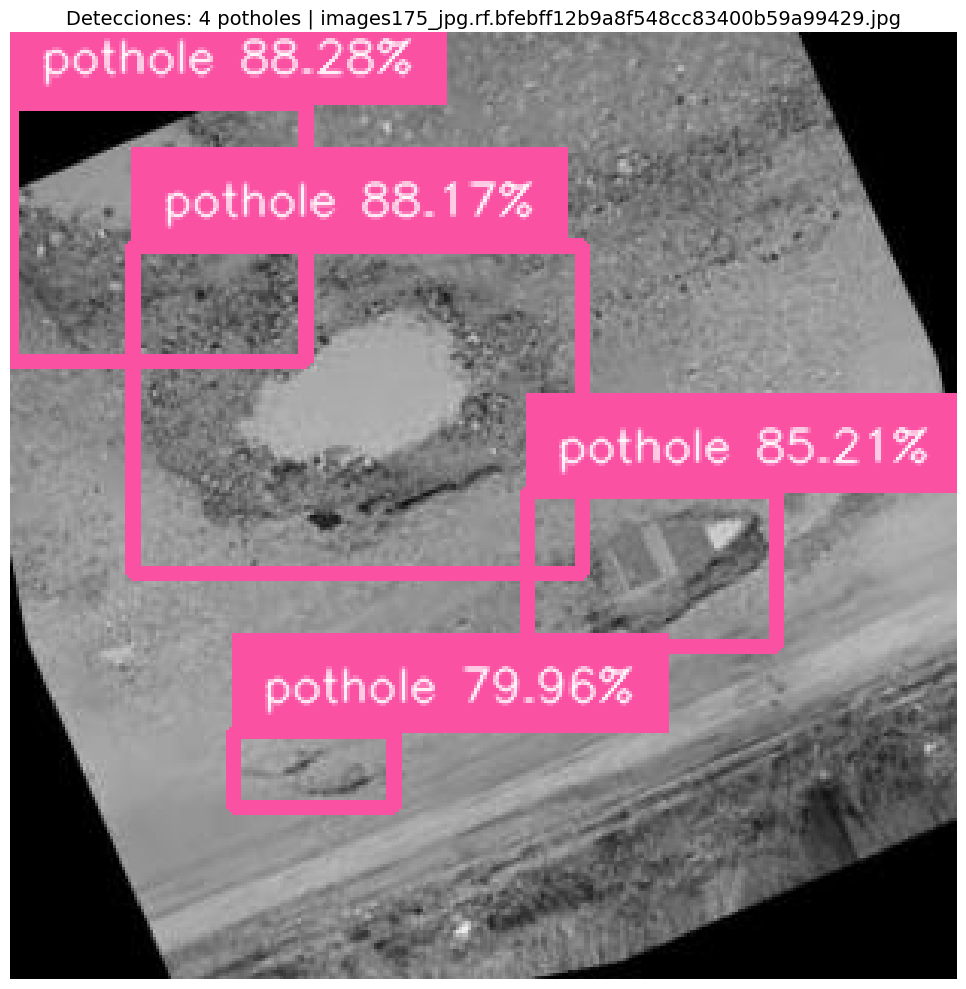


📷 Procesando [51/5]: images175_jpg.rf.c80477e2e4e38a90342eb0e5959847e5.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 85.40%
  2. Confianza: 84.53%
  3. Confianza: 83.22%


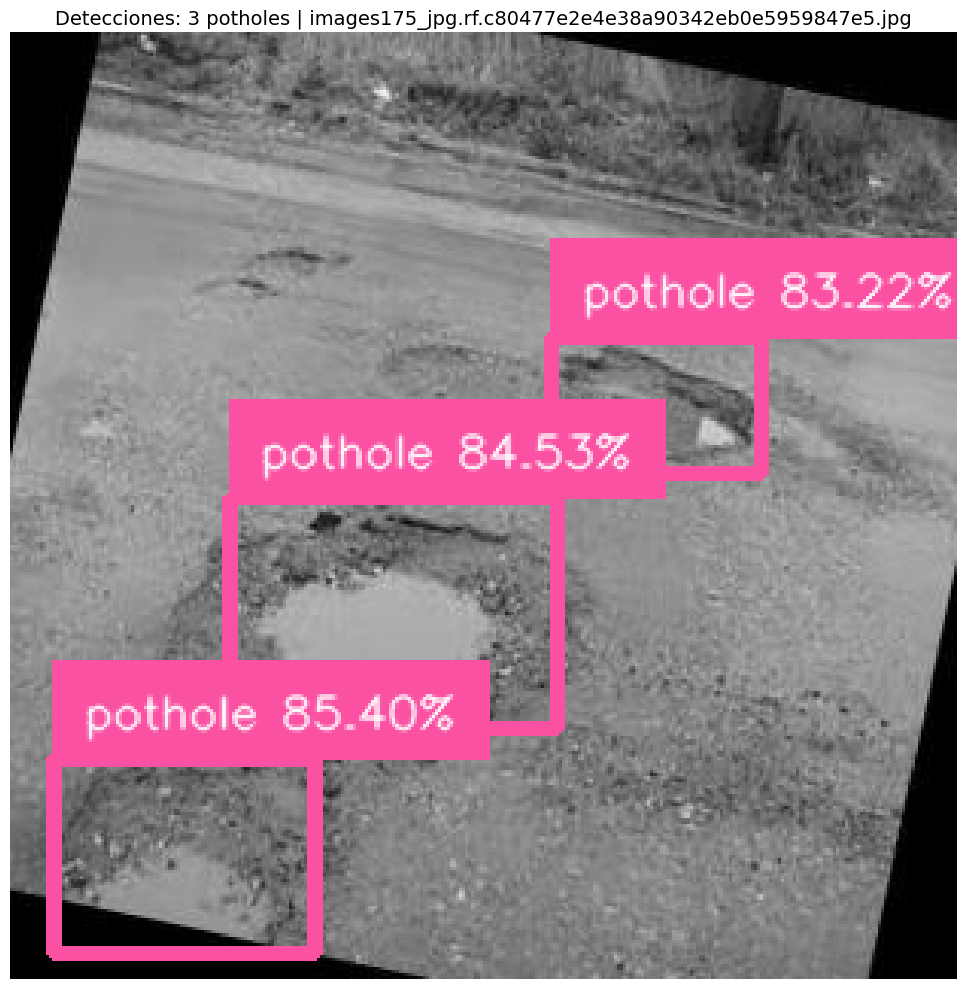


📷 Procesando [52/5]: images179_jpg.rf.8addd3e0929f67d09cb2671a7b82c469.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 85.46%


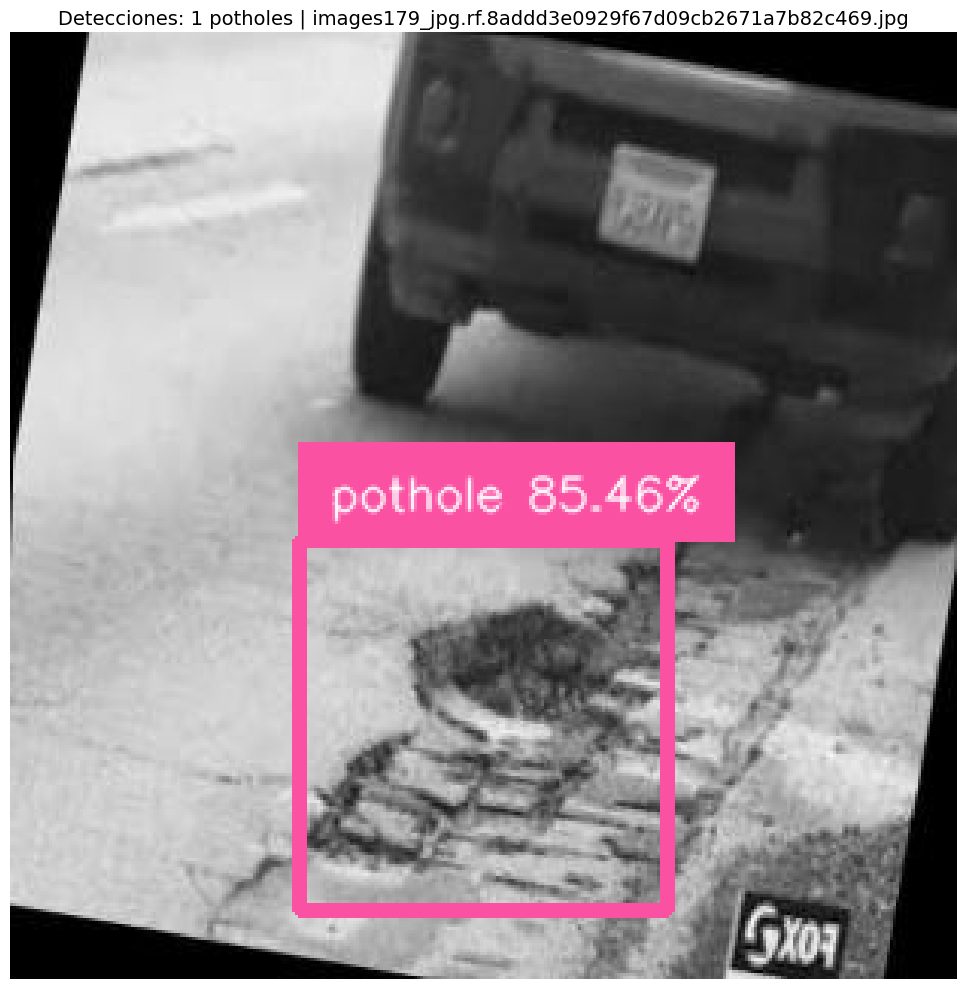


📷 Procesando [53/5]: images179_jpg.rf.f8bd599ecff1913b229d4e72958c0978.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.58%


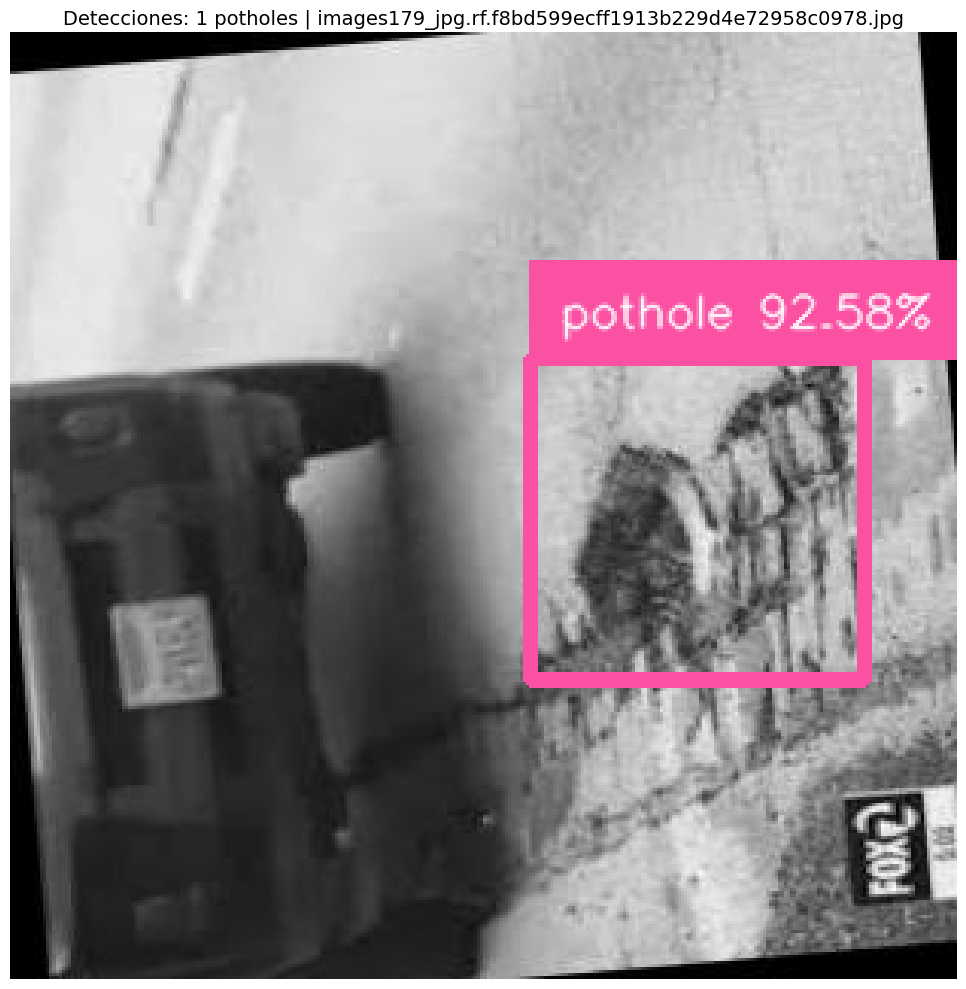


📷 Procesando [54/5]: images180_jpg.rf.80d4c962e4222f0b481bffca9672ff85.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 82.38%
  2. Confianza: 79.00%
  3. Confianza: 77.72%
  4. Confianza: 68.20%


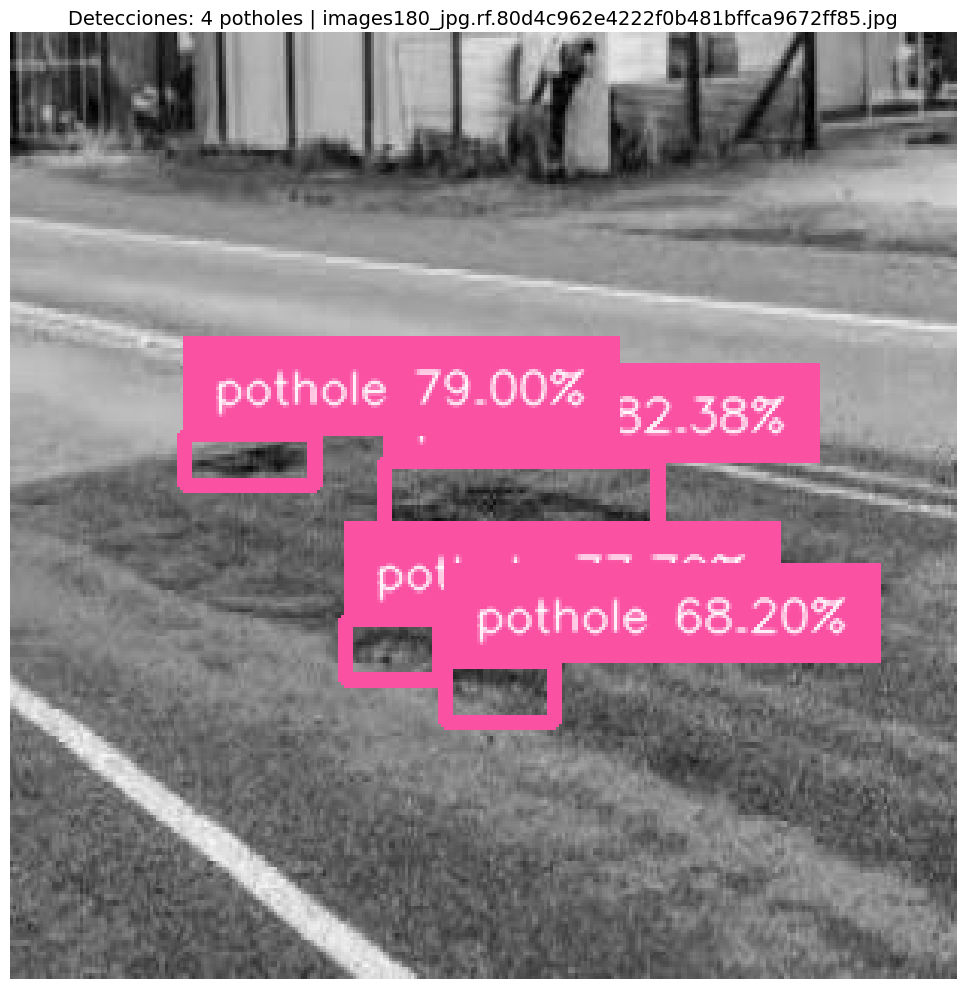


📷 Procesando [55/5]: images199_jpg.rf.0e6425cd5d682e2e994d65583497694f.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.10%


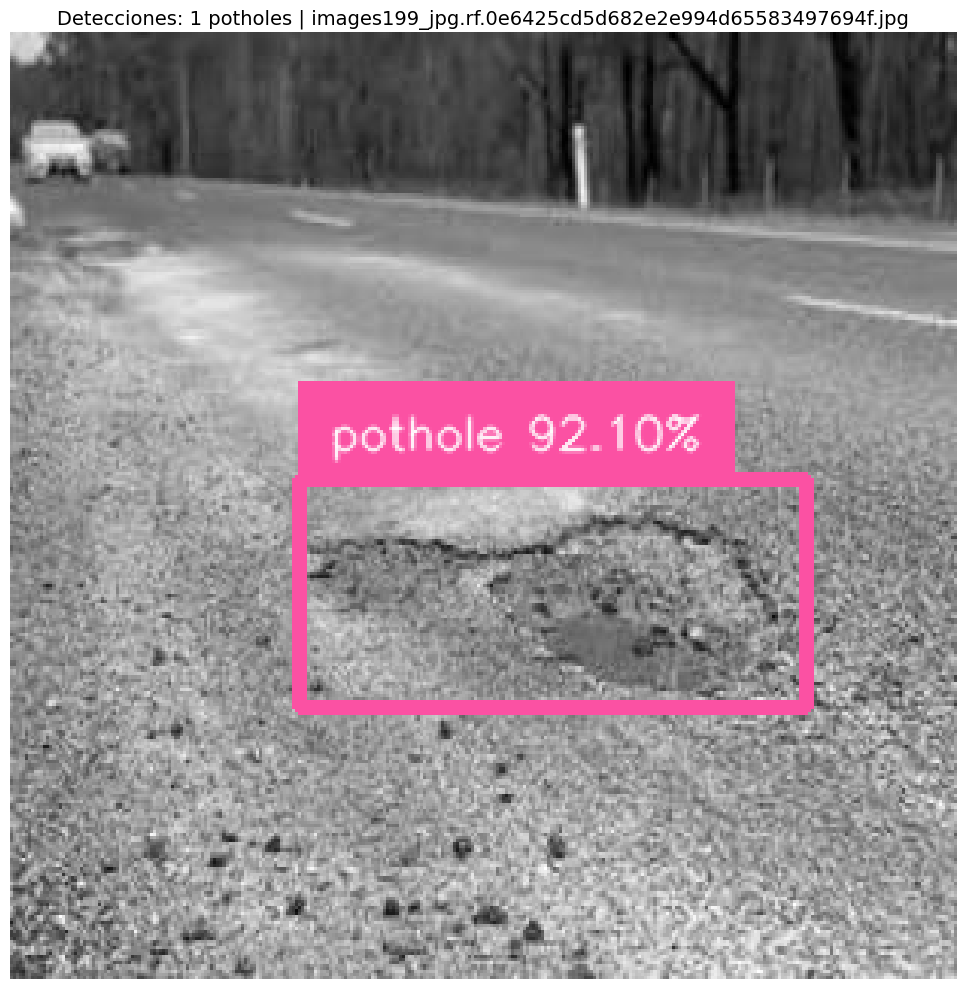


📷 Procesando [56/5]: images207_jpg.rf.bfbab50151b2bbf316e5b1e94c976e8c.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.73%


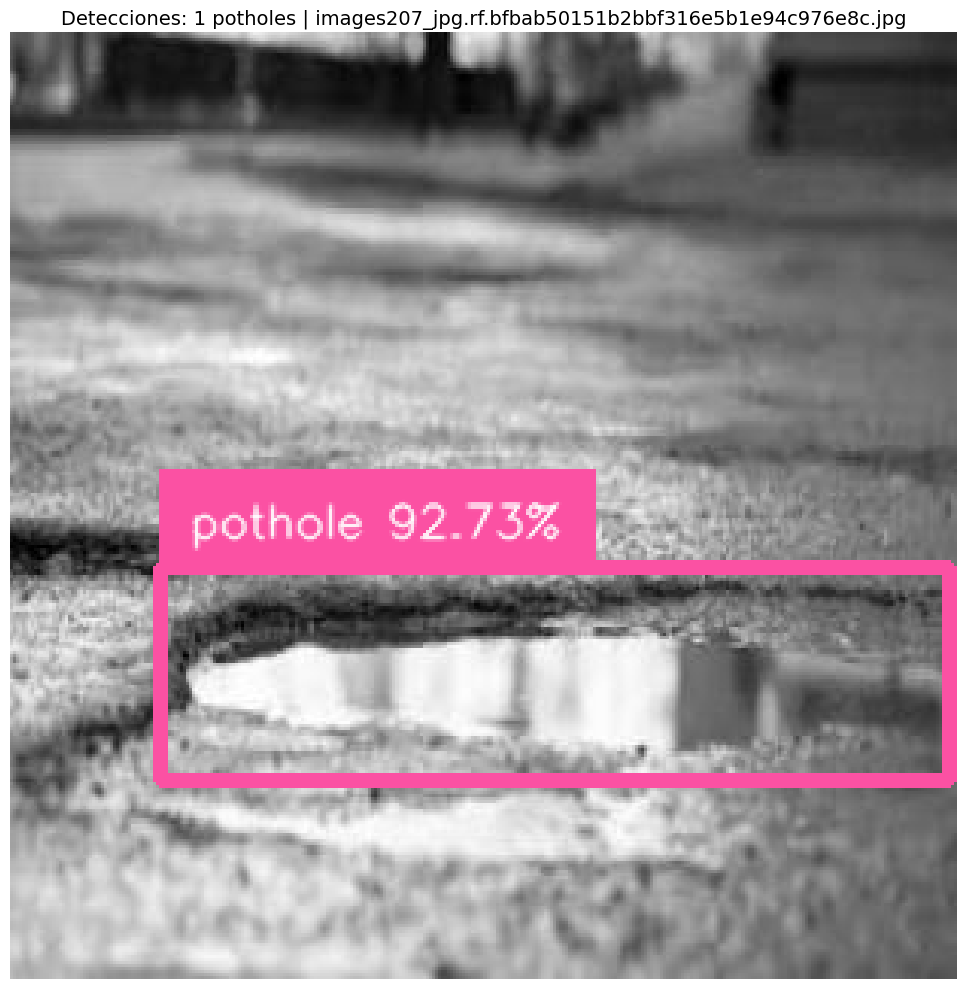


📷 Procesando [57/5]: images211_jpg.rf.4f0d004ddbdcc30196d2592af79328dc.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.72%


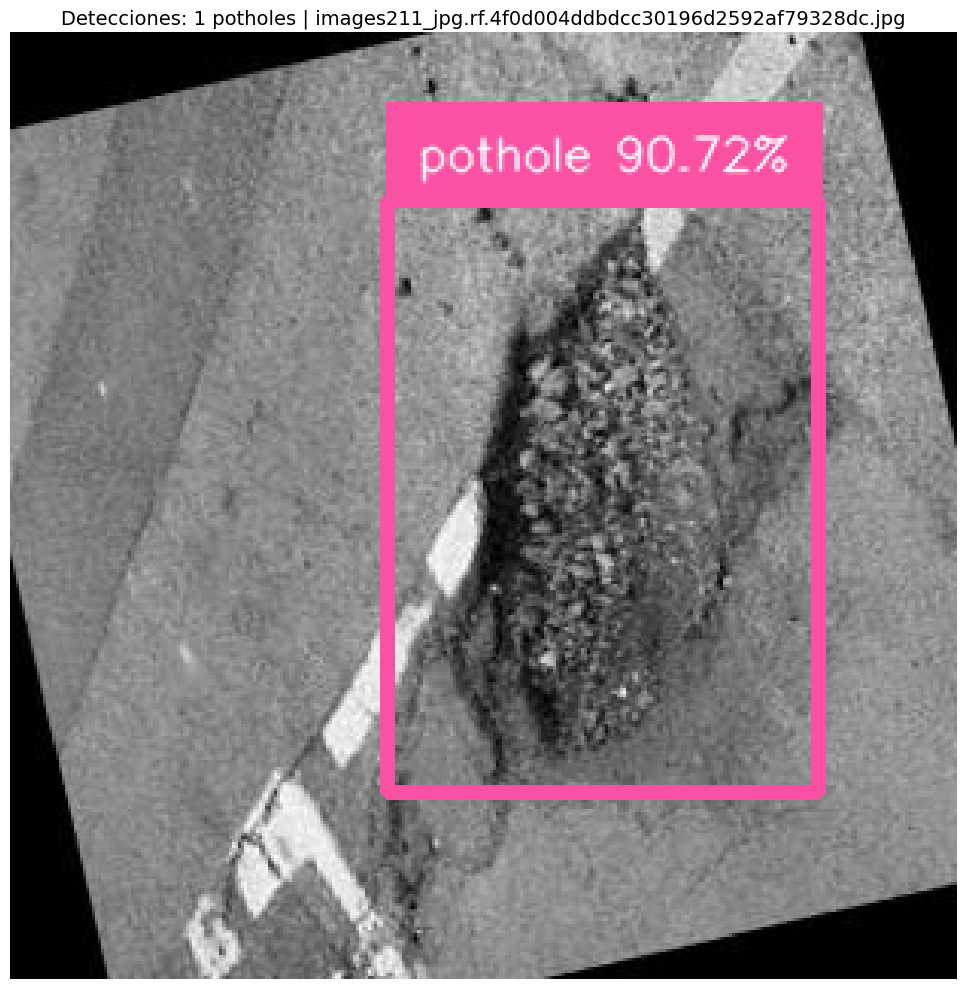


📷 Procesando [58/5]: images212_jpg.rf.9c09d718555c80a7f6160b04a1d731ce.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 91.19%


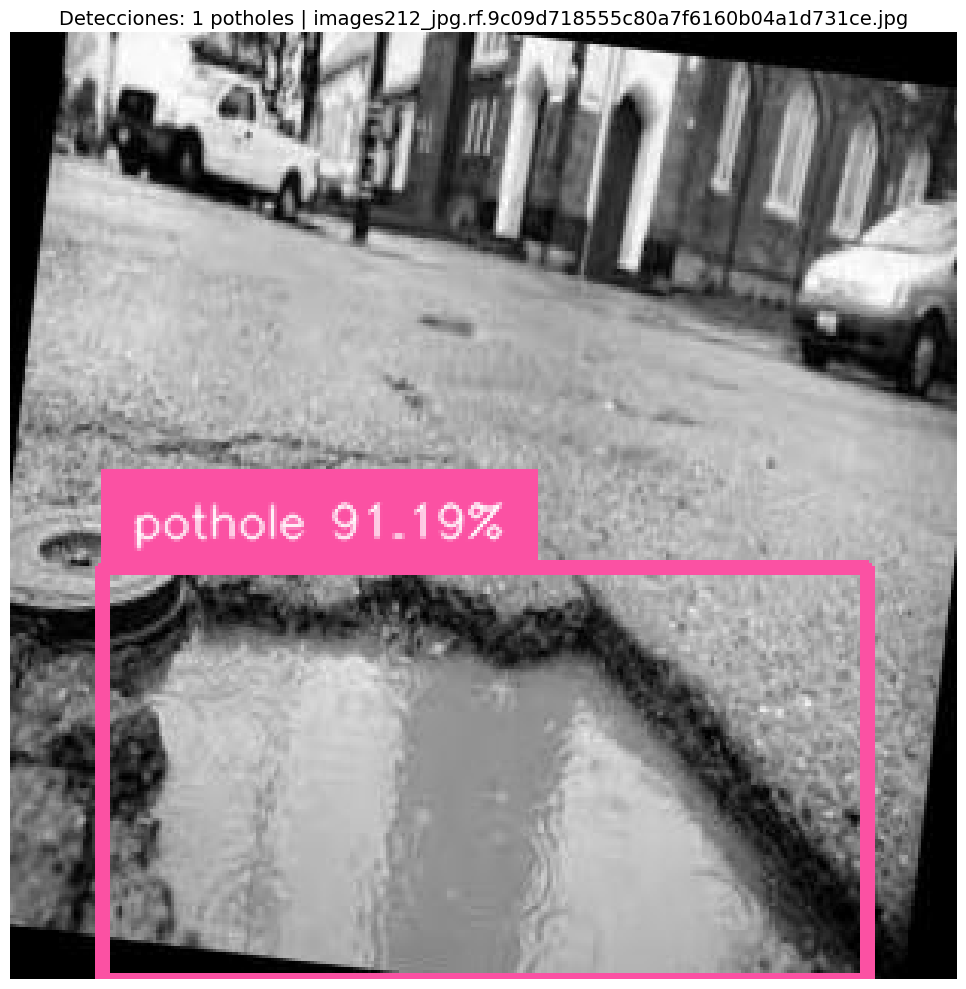


📷 Procesando [59/5]: images220_jpg.rf.dca45216e61465770f071d59038f3930.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 94.04%


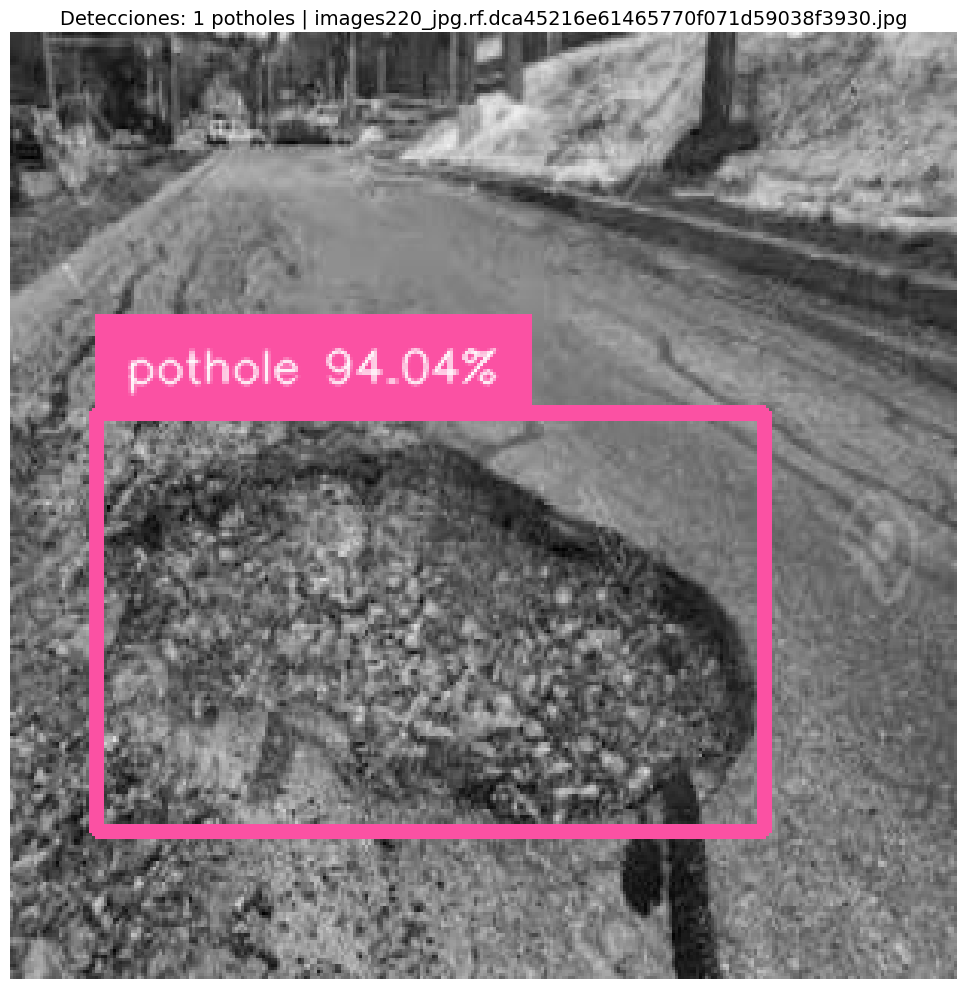


📷 Procesando [60/5]: images224_jpg.rf.b57435c6926a6951a9a83d2c4d06a642.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 91.83%


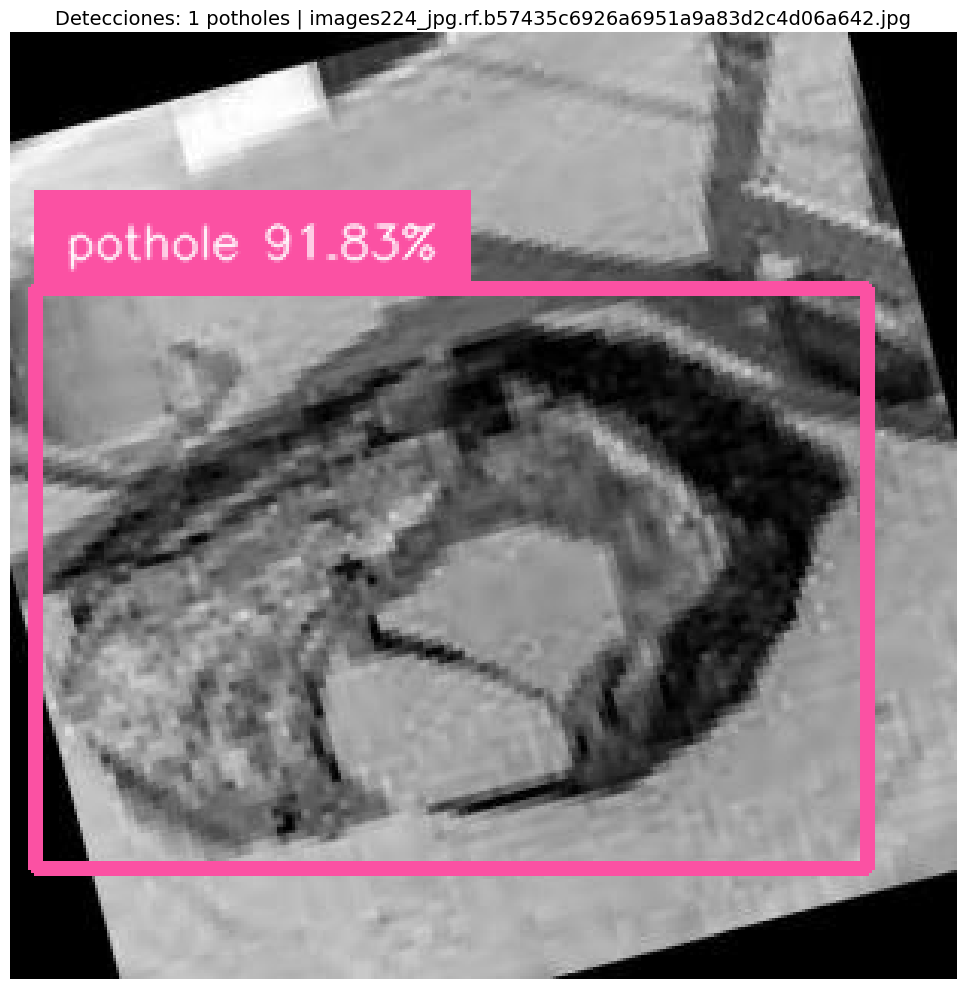


📷 Procesando [61/5]: images228_jpg.rf.8ef0fd934aab92d66fbef892bb18c742.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 93.15%


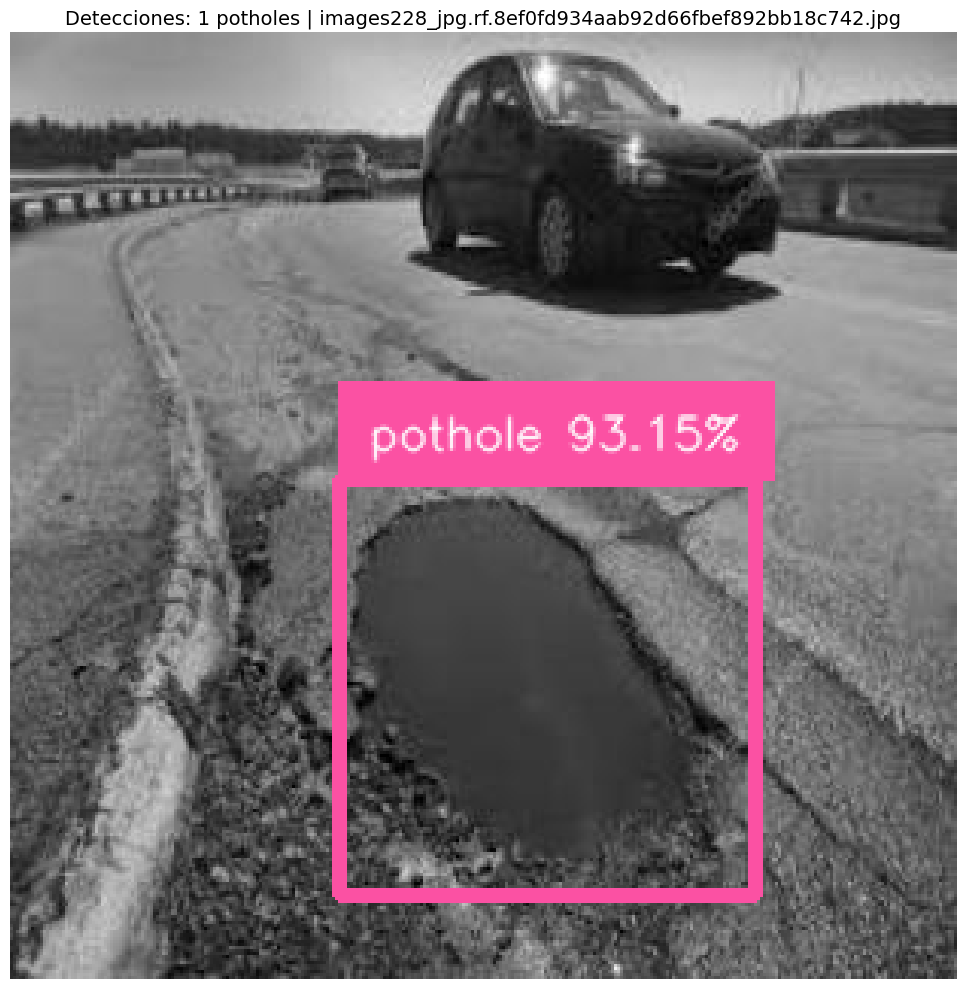


📷 Procesando [62/5]: images238_jpg.rf.0130f72019227b782c1fc3194bdbd93b.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 88.66%
  2. Confianza: 83.23%


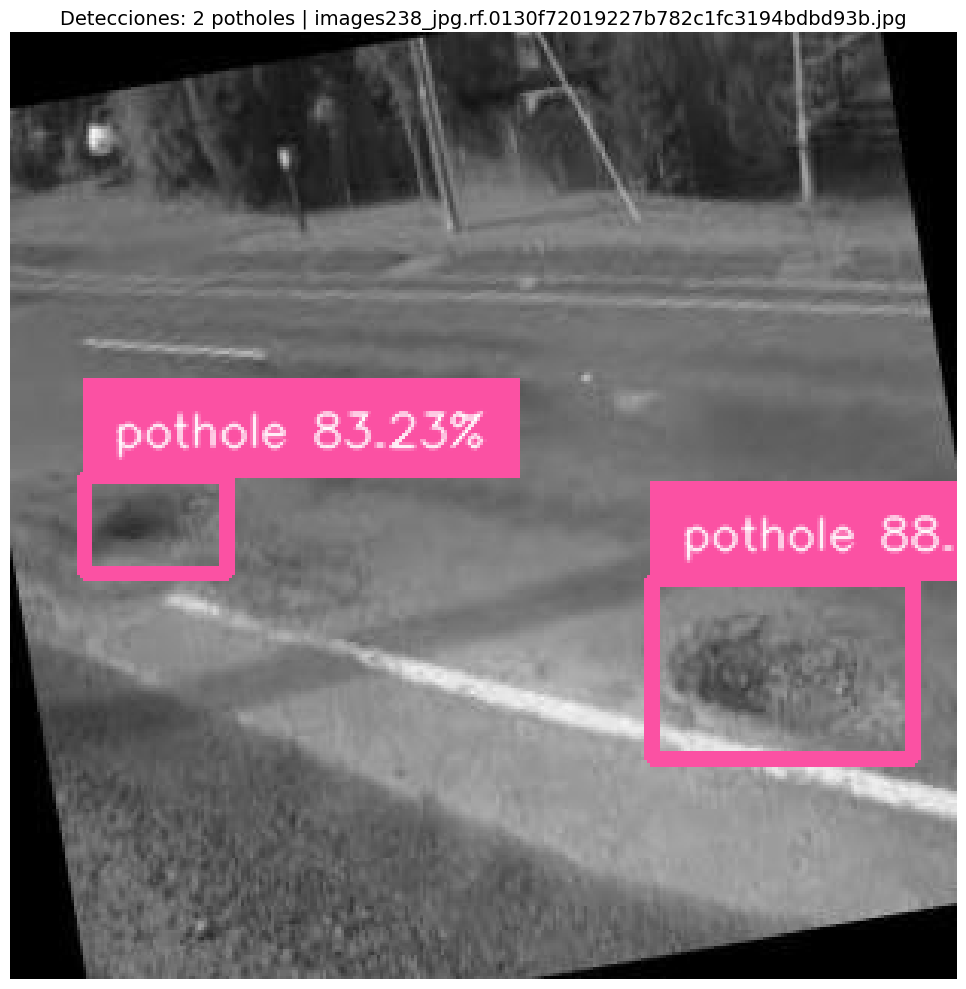


📷 Procesando [63/5]: images252_jpg.rf.57c858cdcb083229b4b25e025c997669.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 88.04%


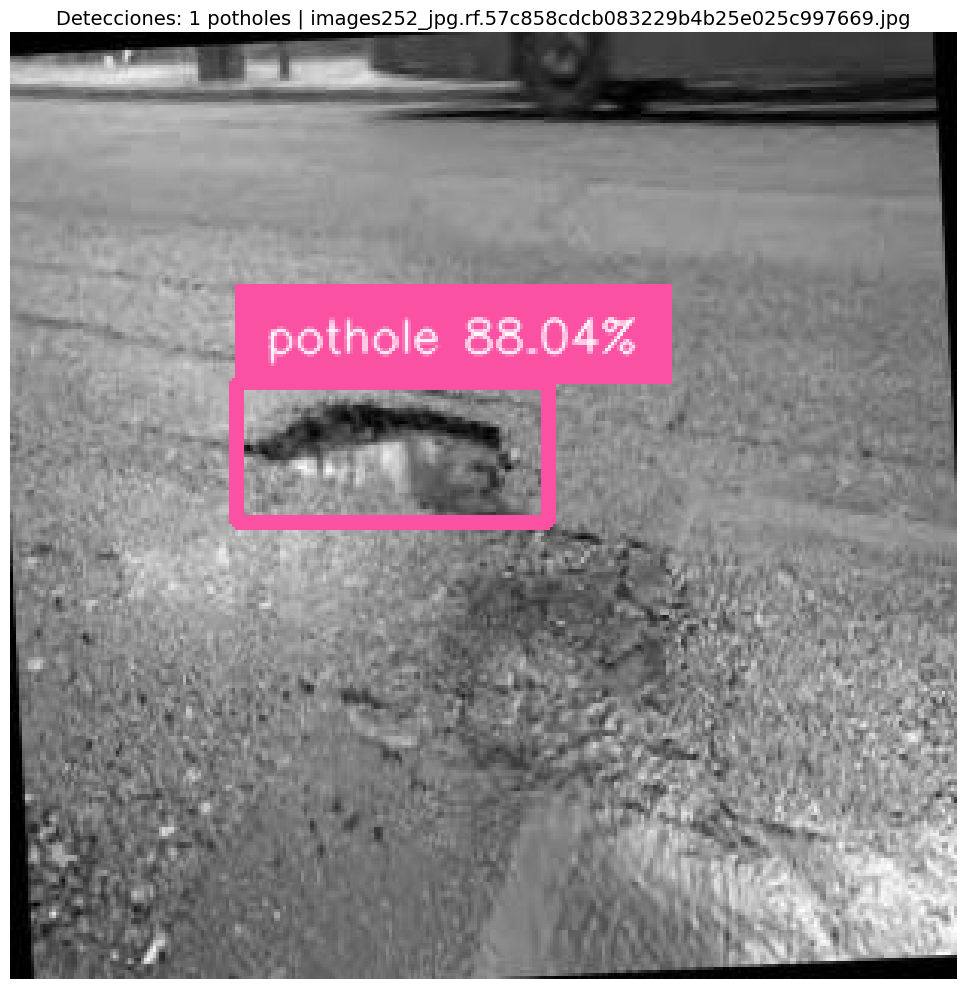


📷 Procesando [64/5]: images256_jpg.rf.61d1cd9e42f12f56401c373cd65b3717.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 76.18%


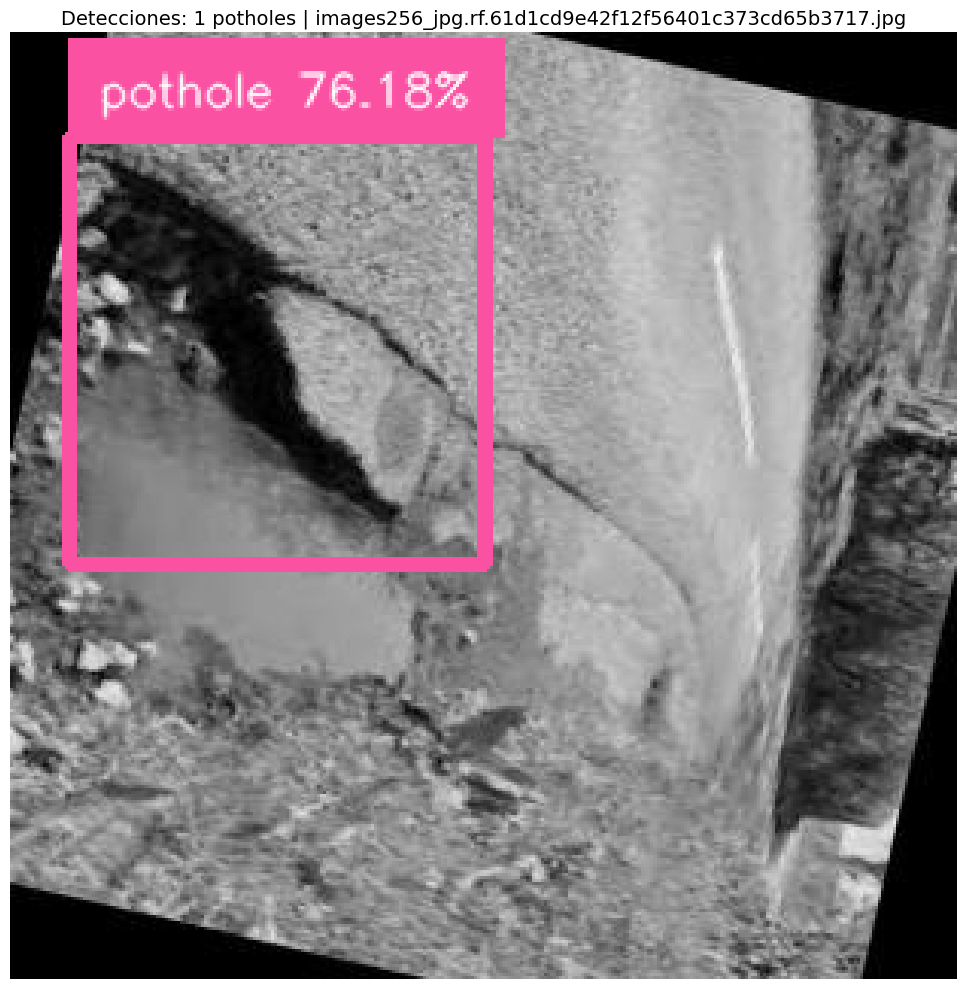


📷 Procesando [65/5]: images276_jpg.rf.b1674444b526df05010d7a31a45ad5a2.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 91.26%
  2. Confianza: 88.05%
  3. Confianza: 86.81%


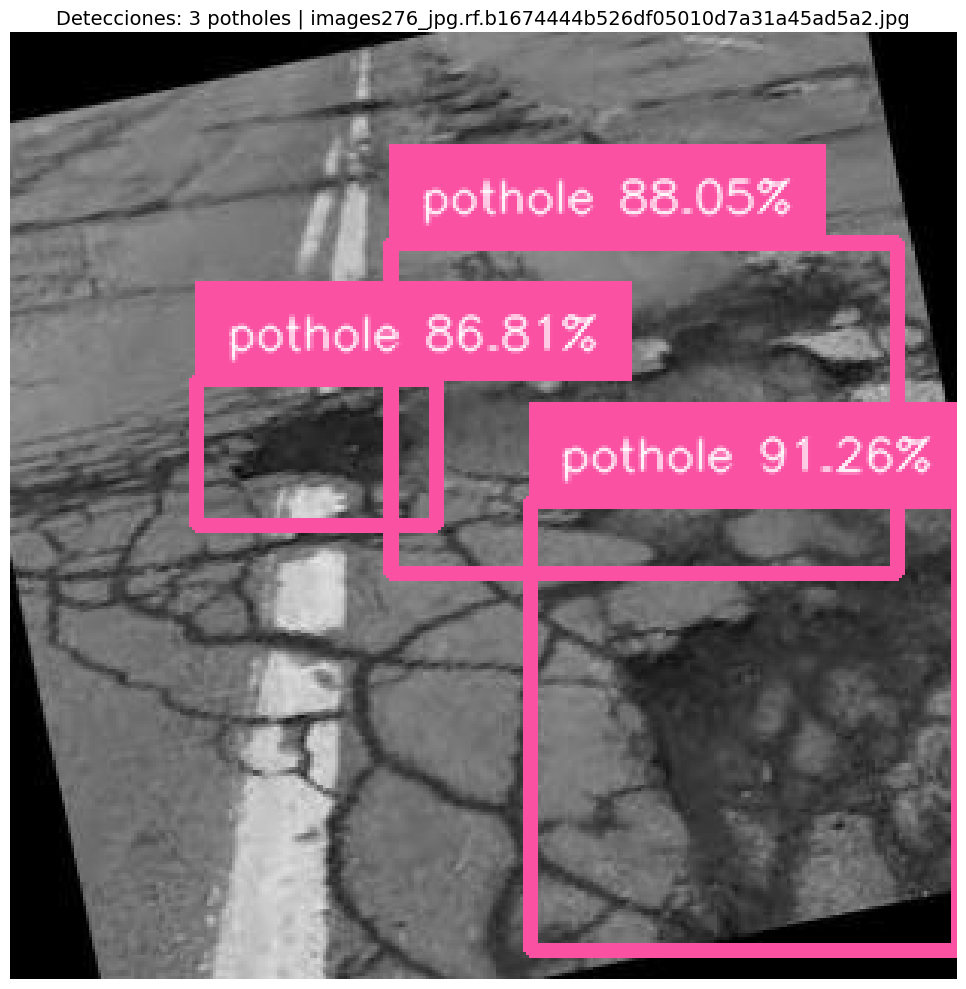


📷 Procesando [66/5]: images_jpeg_jpg.rf.aabf9d93132d69ecad82c6ae0007aeb6.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 92.78%
  2. Confianza: 90.56%


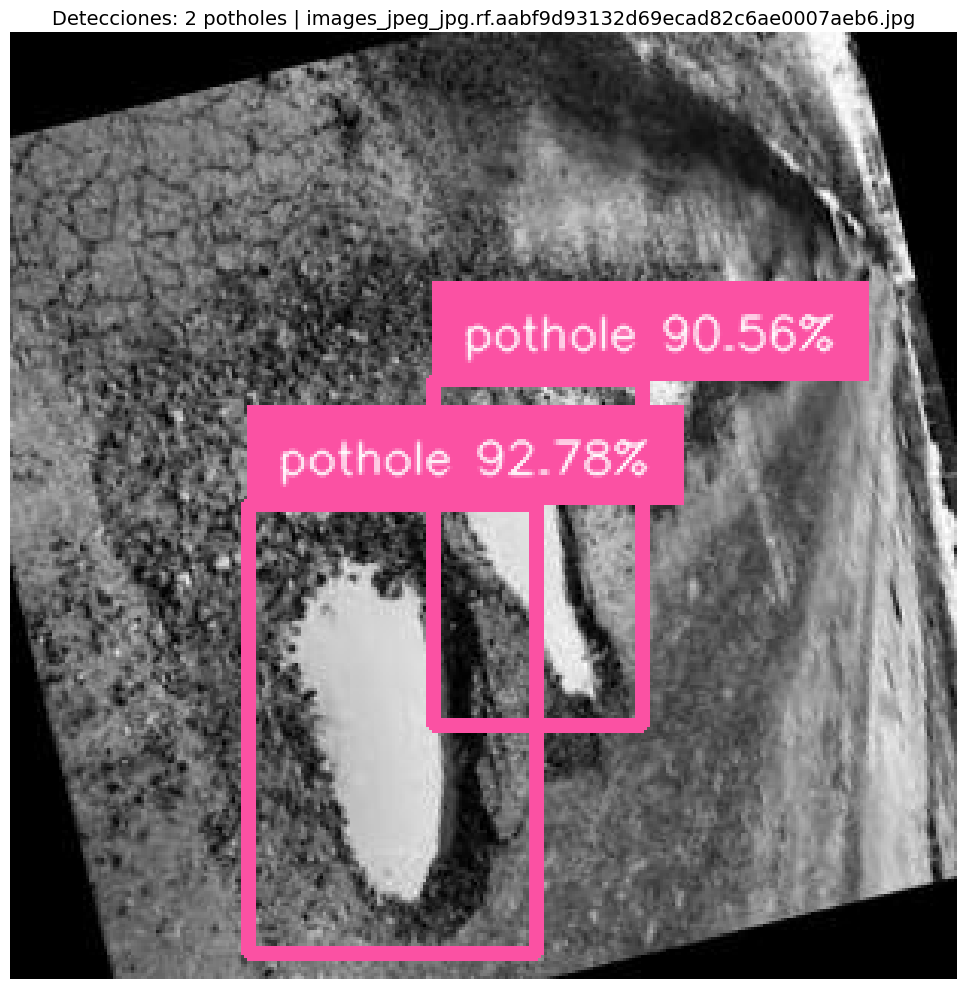


📷 Procesando [67/5]: L20131009-22007195220i1_jpg.rf.de11bd6237411353638d56ba614a6dc1.jpg
🕳️ Potholes detectados: 0


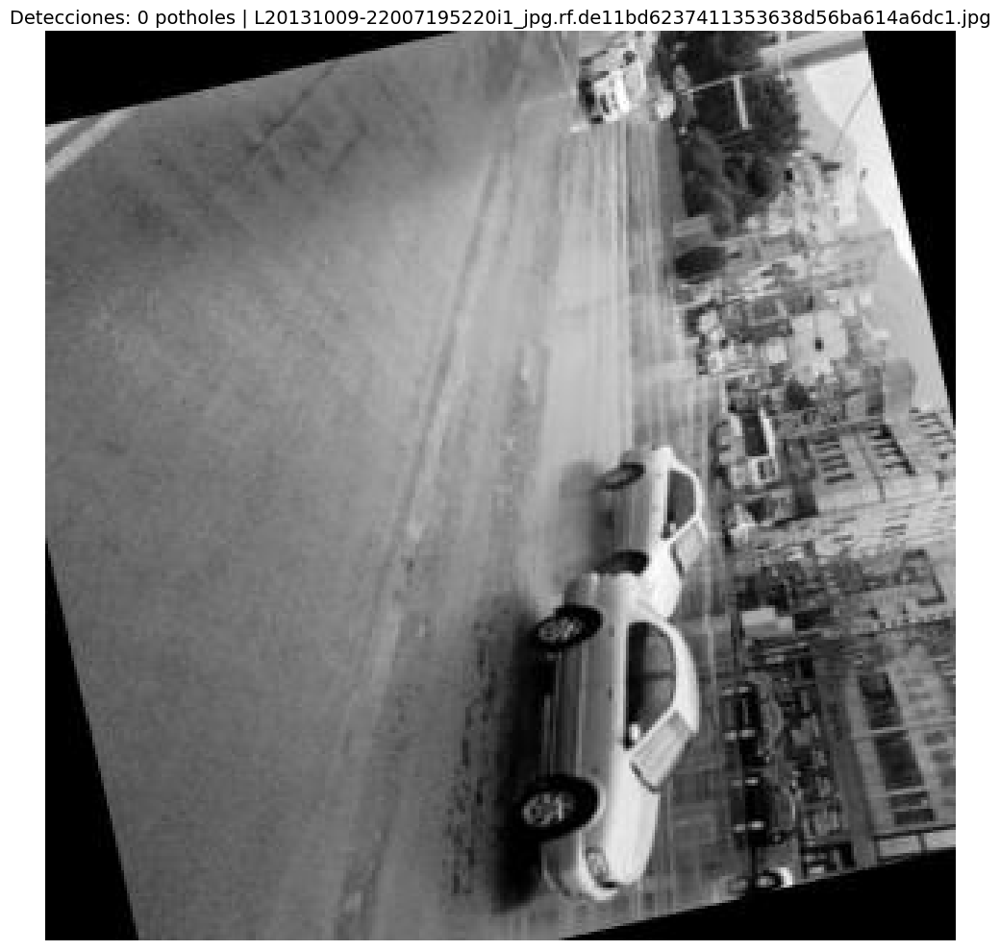


📷 Procesando [68/5]: pothole2_jpg.rf.7f0233e403cdb236aa957bdf5418b28f.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.32%


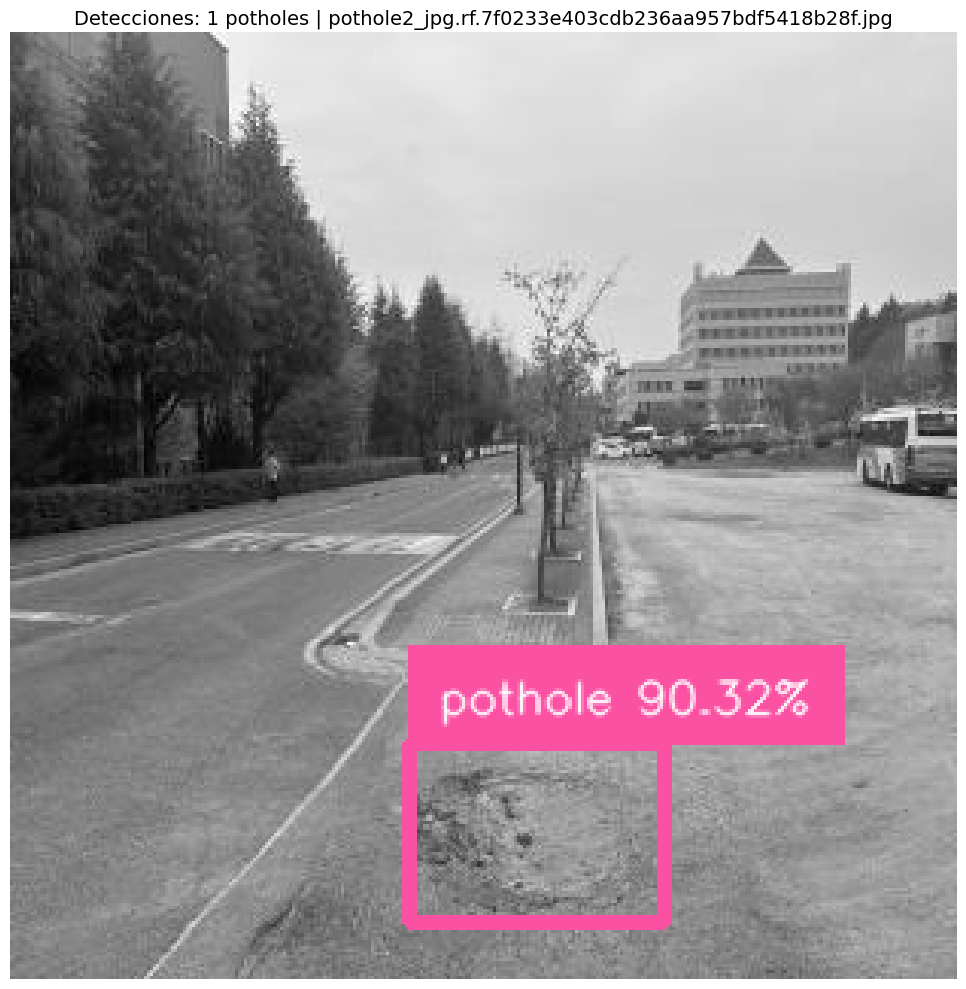


📷 Procesando [69/5]: pothole4_jpg.rf.d86c114f05e4298d5260ac607fc9d5be.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.07%


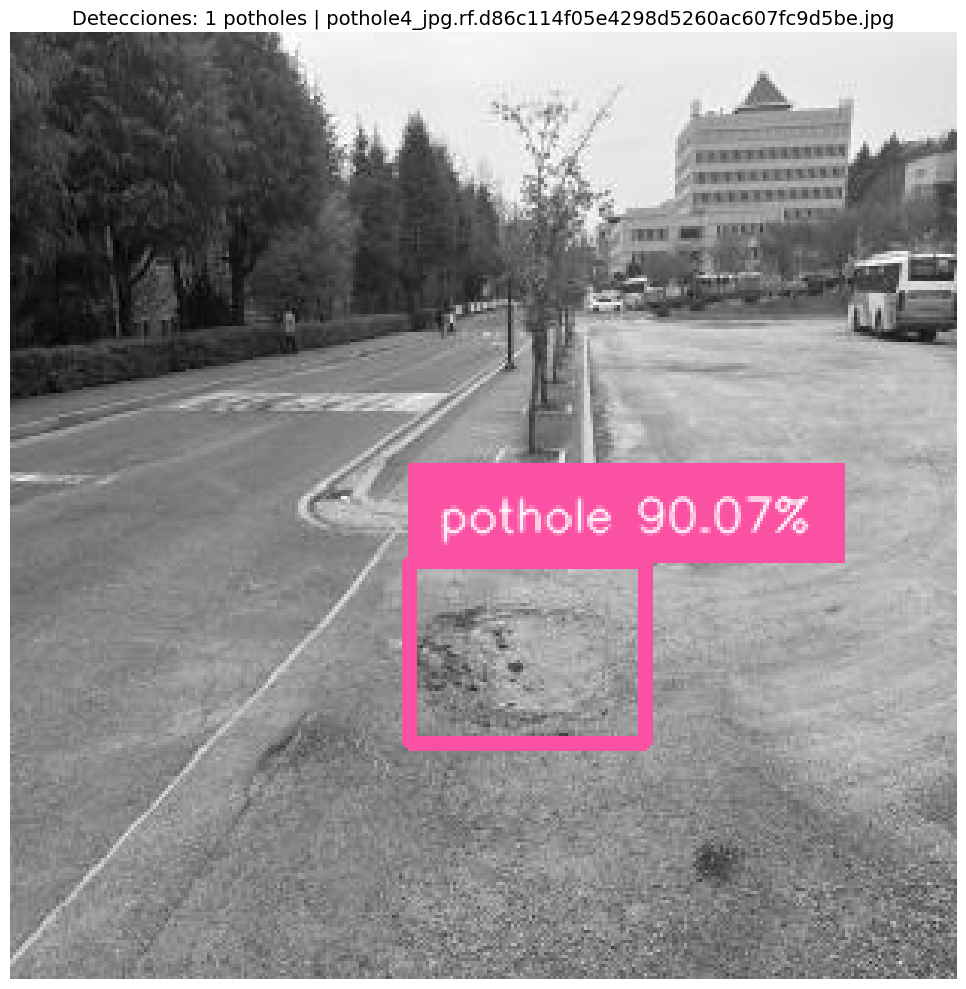


📷 Procesando [70/5]: pothole_day14_jpg.rf.632073e5dbeeb038a1056b83153ac386.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.18%


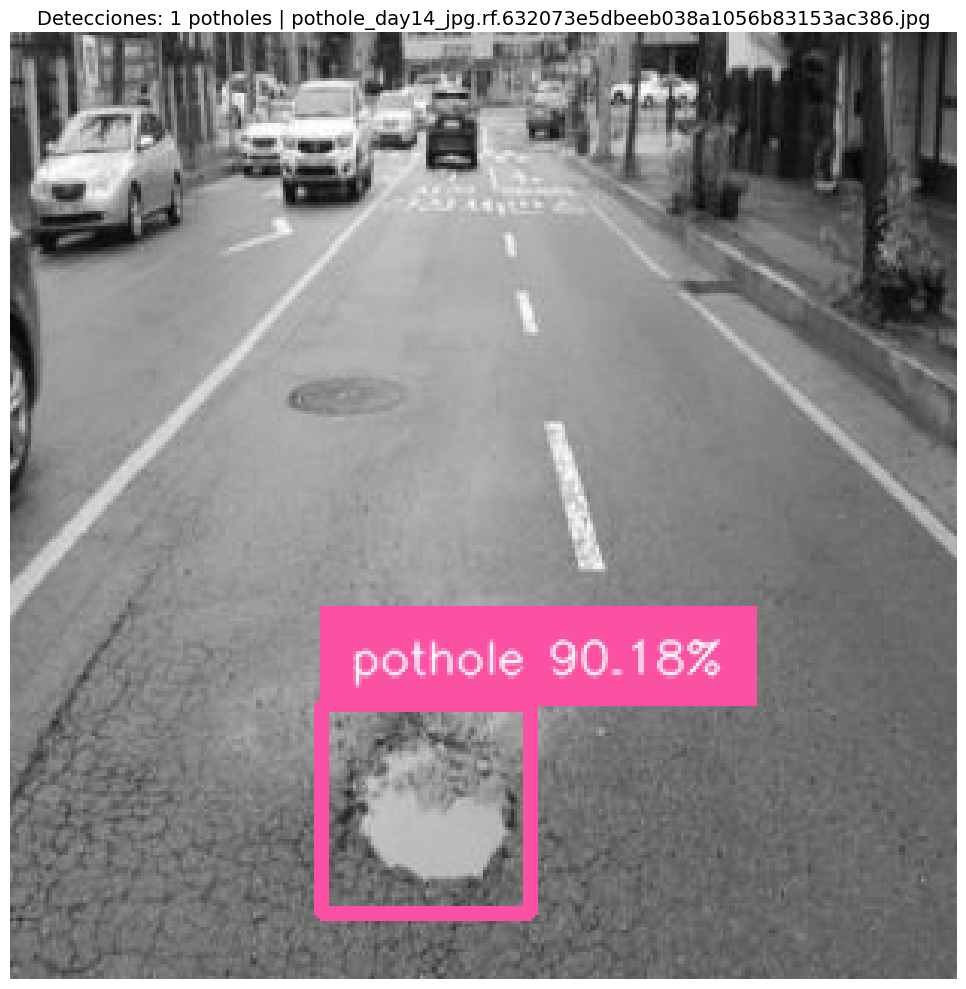


📷 Procesando [71/5]: pothole_day14_jpg.rf.f3e8167855cbbf3eb6f968c47a3b936c.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.84%


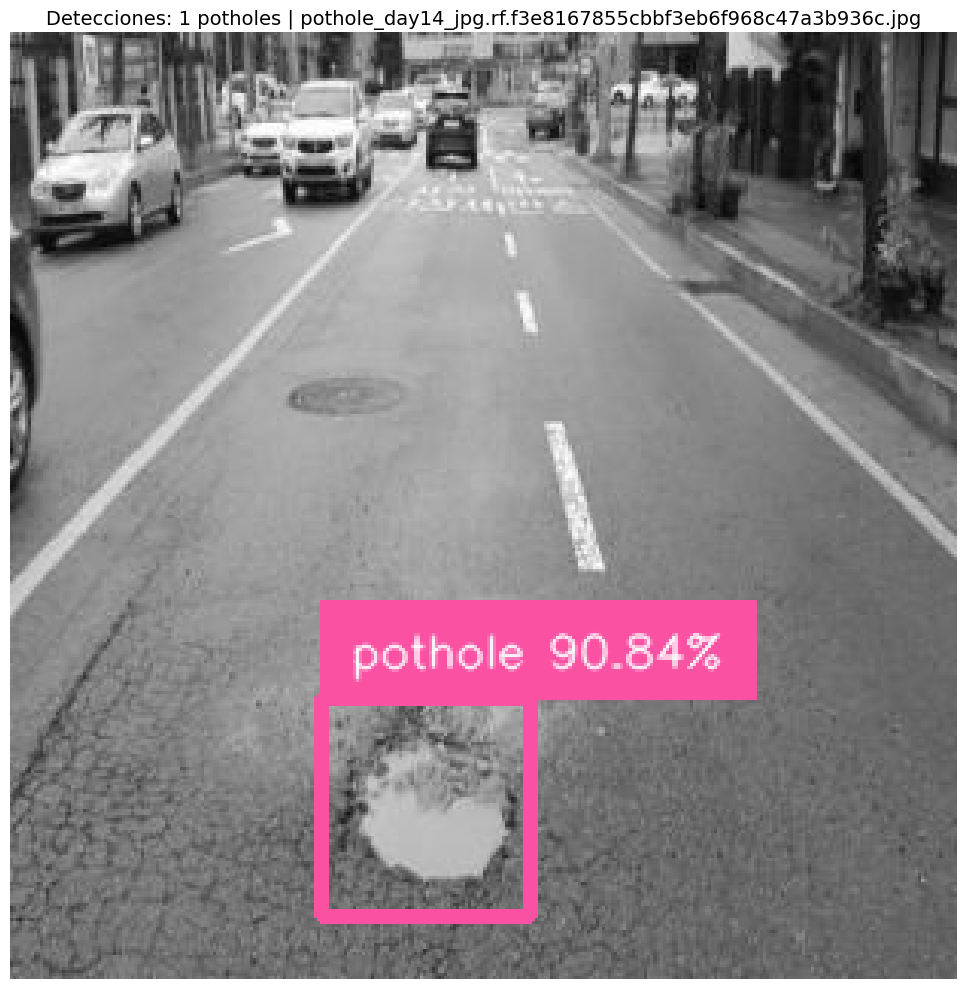


📷 Procesando [72/5]: pothole_day34_jpg.rf.932c9d9d1e9cd9b83e7a9663546a23e2.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 93.37%


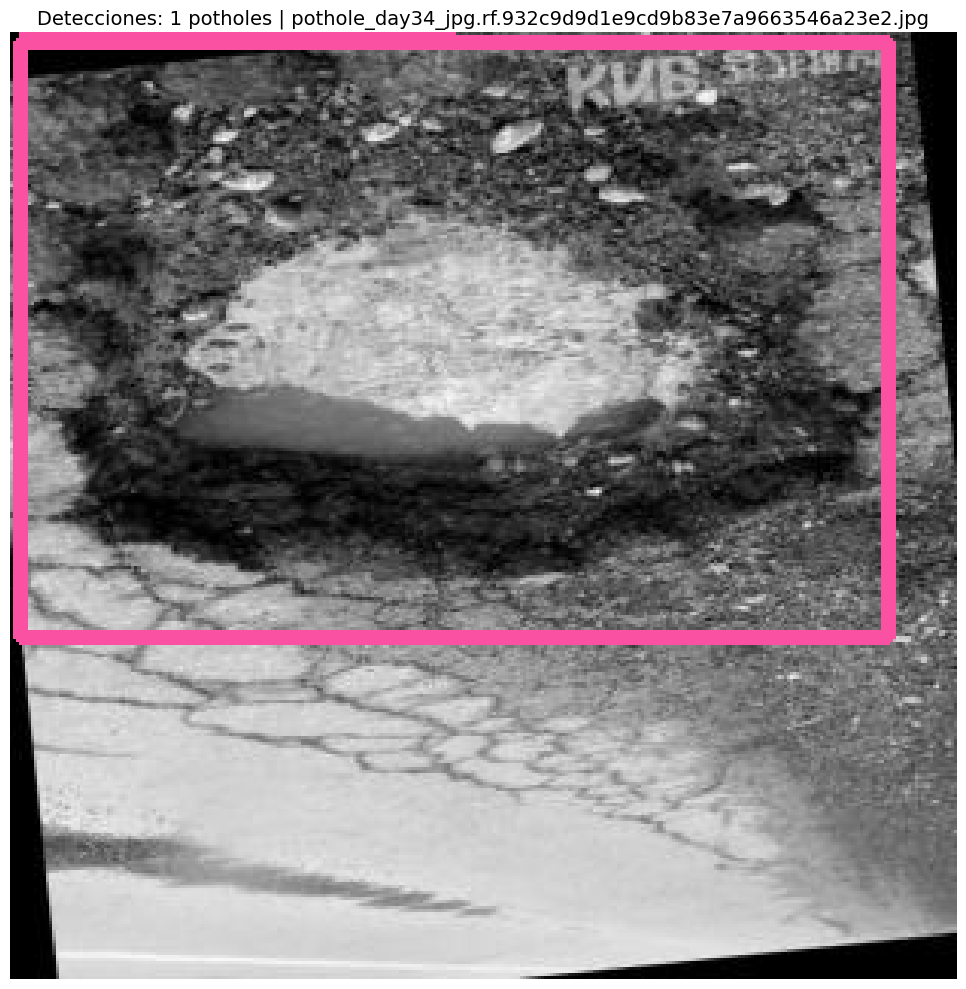


📷 Procesando [73/5]: pothole_day38_jpg.rf.8fce1680161aee7a25eb3293ae66c607.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 92.13%
  2. Confianza: 89.62%
  3. Confianza: 85.77%


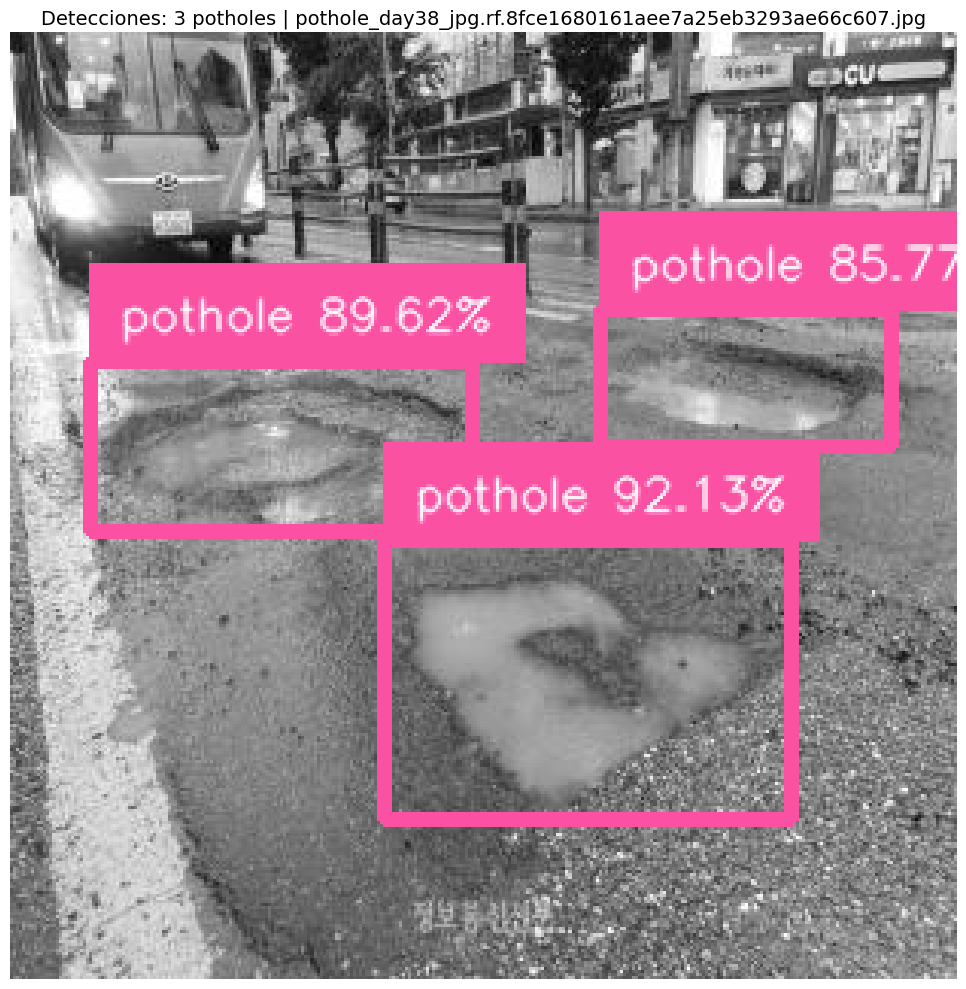


📷 Procesando [74/5]: pothole_day3_jpeg.rf.de228aee9e00c7b521c2ff6d2009ad92.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.04%


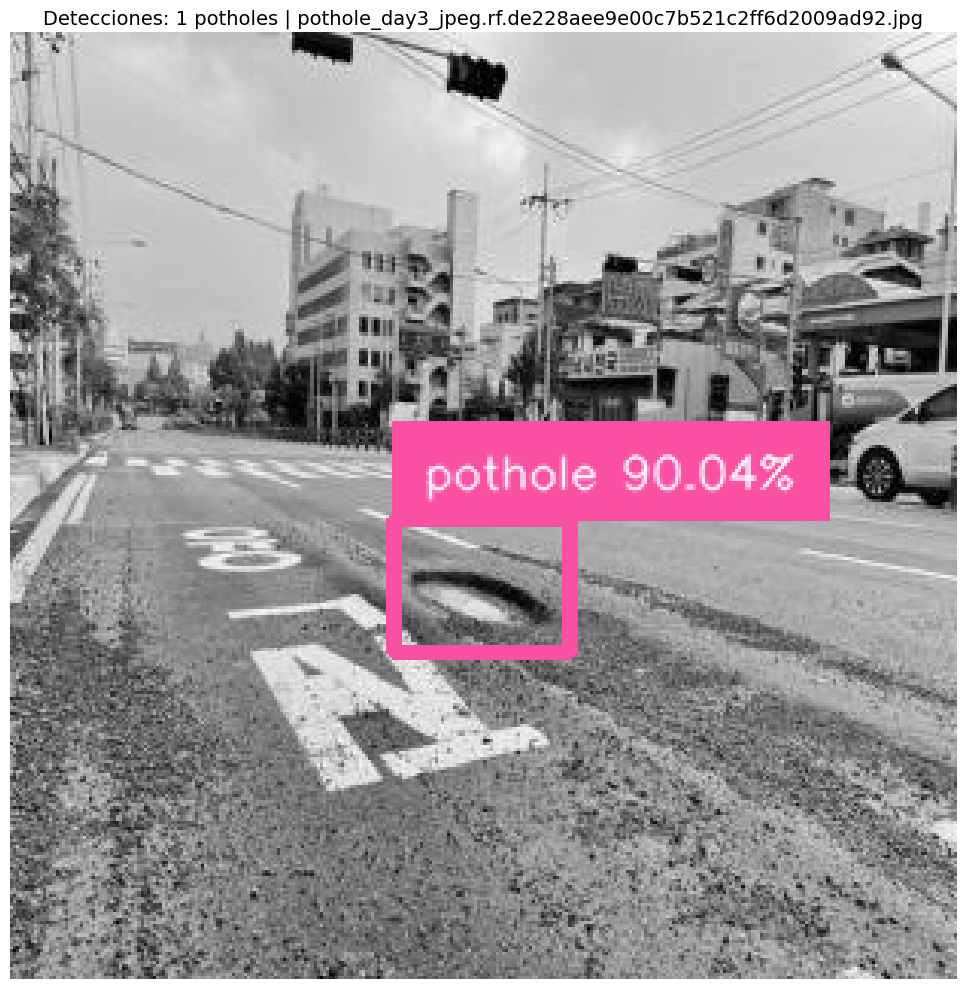


📷 Procesando [75/5]: pothole_day51_jpg.rf.1dc3d537143e8d20eb595a6e45cf3f02.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 88.17%
  2. Confianza: 87.50%
  3. Confianza: 86.57%


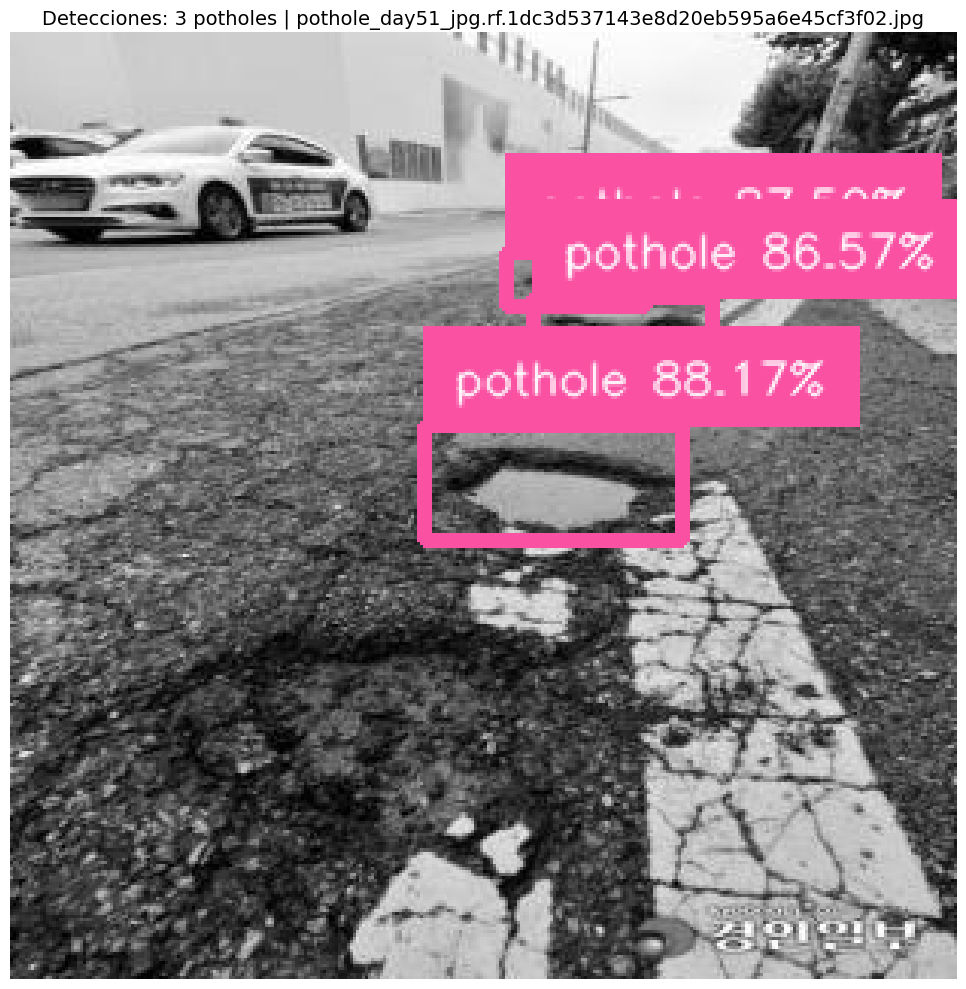


📷 Procesando [76/5]: pothole_day55_webp.rf.a54ad3d3361d789321c49079d05b00b9.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 91.56%
  2. Confianza: 91.46%


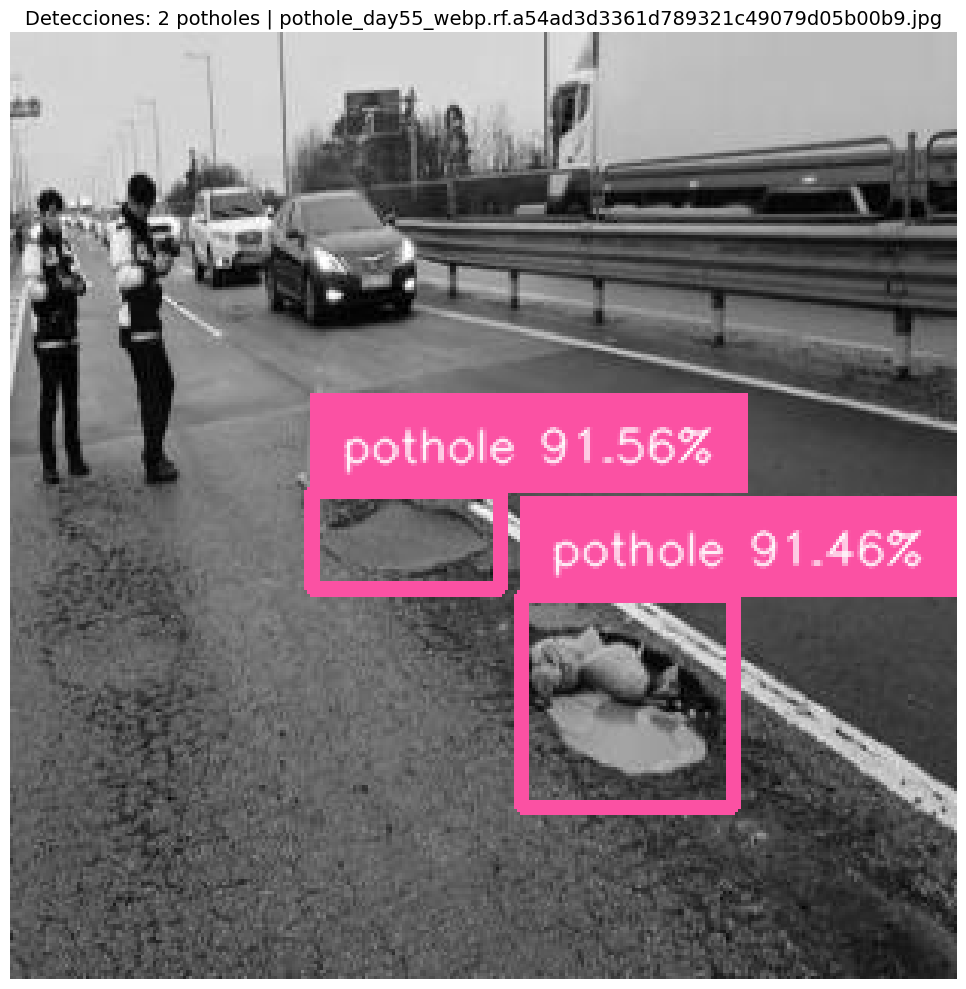


📷 Procesando [77/5]: pothole_day56_jpg.rf.2fdace858c886b98260abe6bc2aad2ab.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 91.55%
  2. Confianza: 87.60%


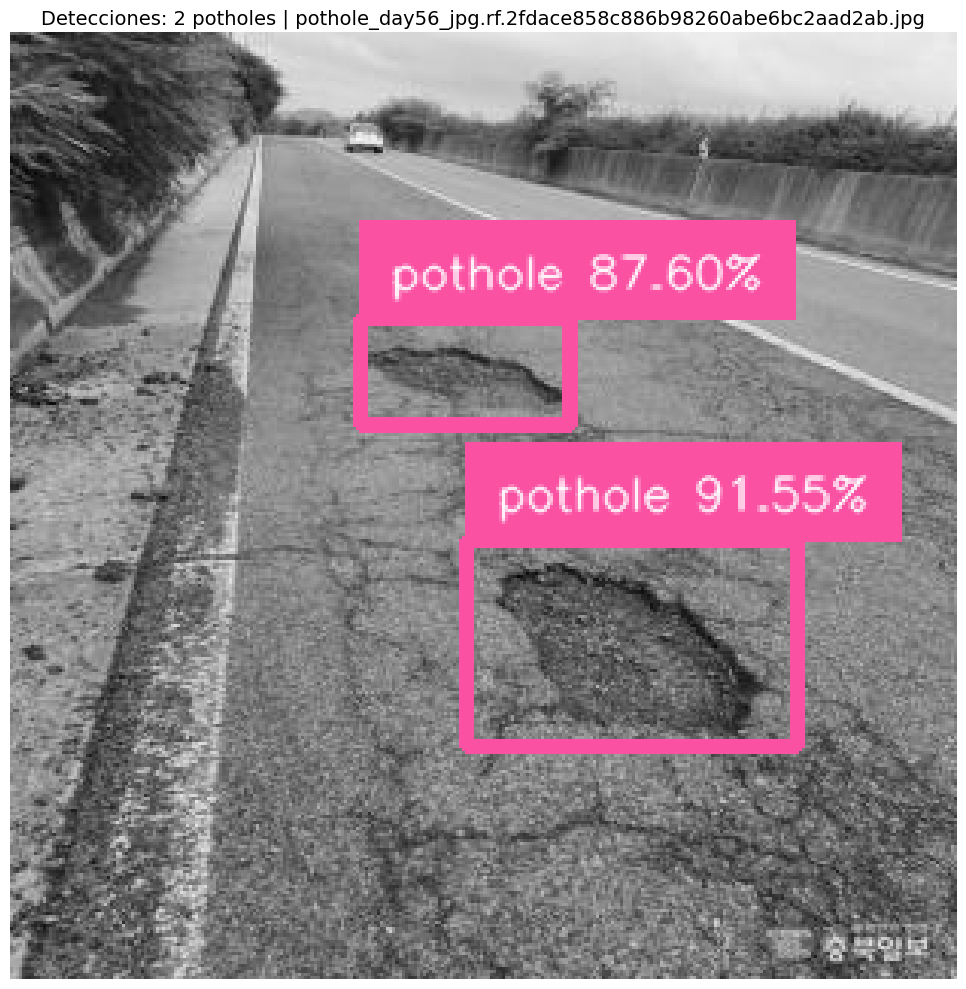


📷 Procesando [78/5]: pothole_day58_jpg.rf.bbe013124a44da8fa5a1257cba0a8847.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.86%


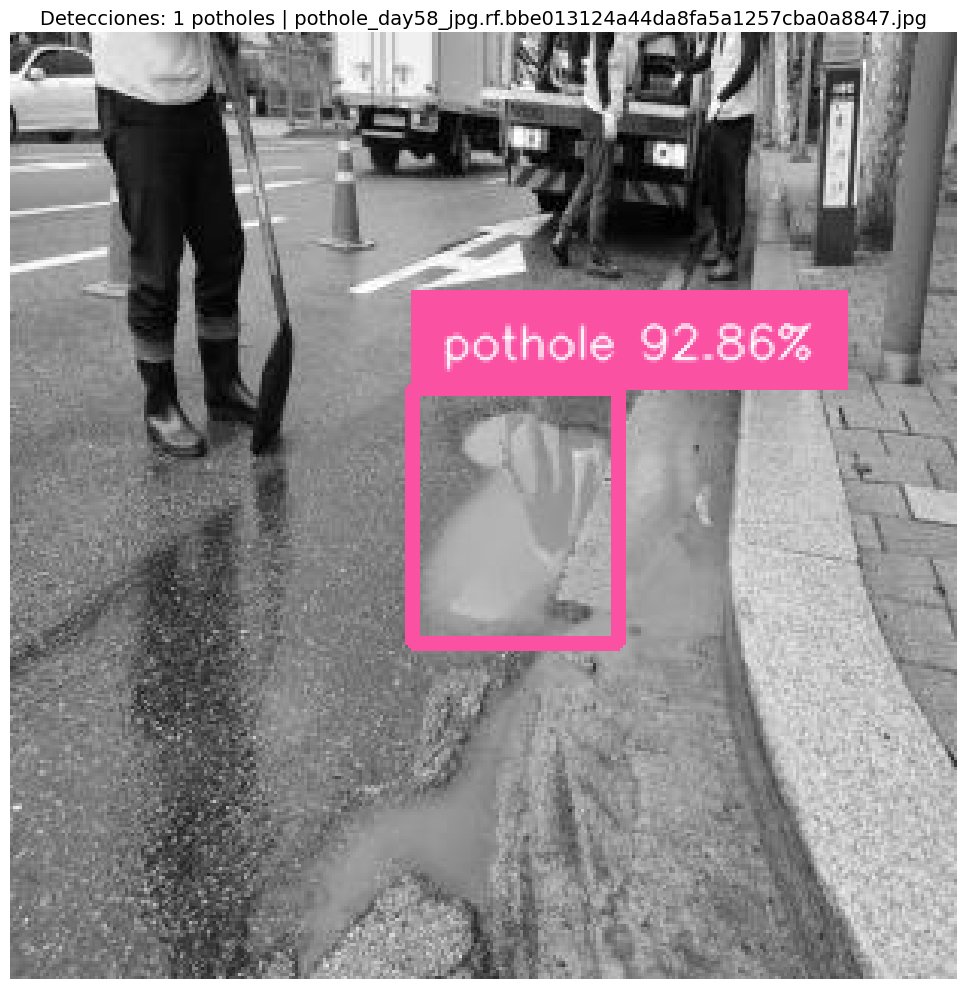


📷 Procesando [79/5]: pothole_day70_jpg.rf.35b16ef50556338c6db09b636d95efd8.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 90.24%
  2. Confianza: 90.06%
  3. Confianza: 89.07%


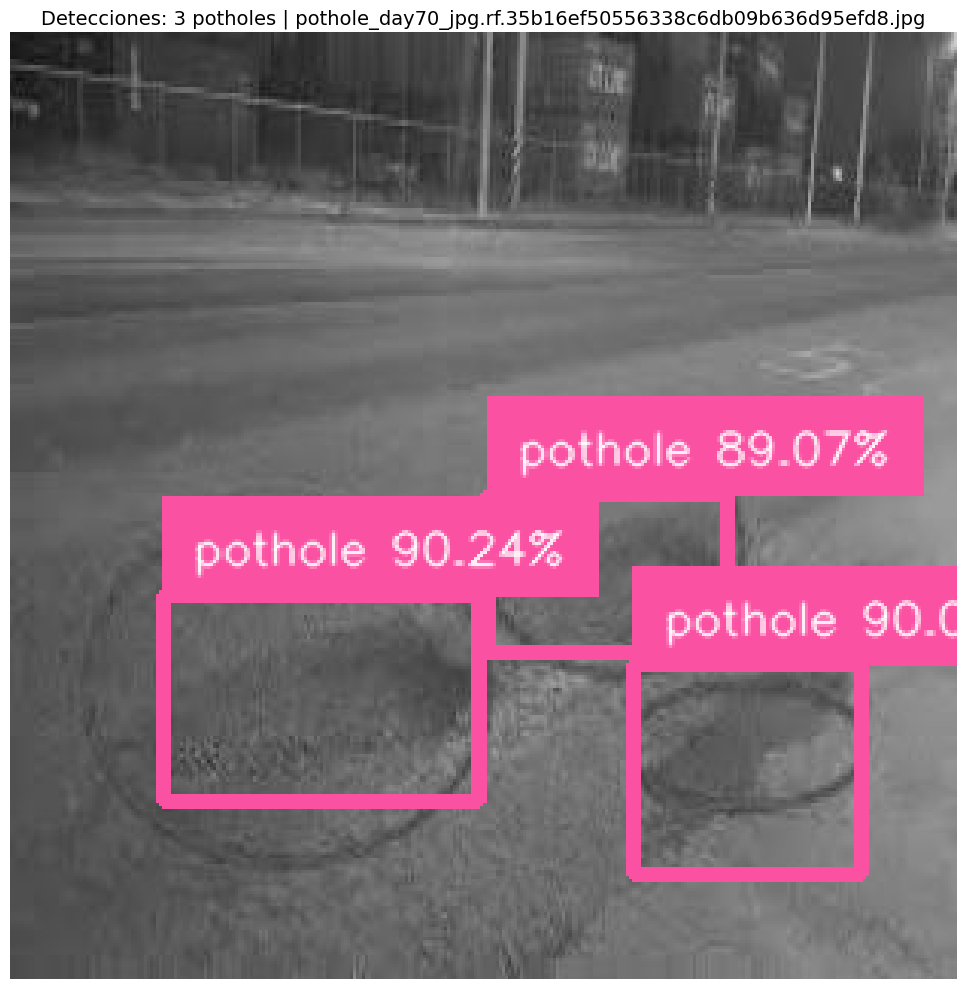


📷 Procesando [80/5]: pothole_night11_jpg.rf.f7bb97a032c9d6c029af864ad3341ce3.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 75.89%
  2. Confianza: 59.45%


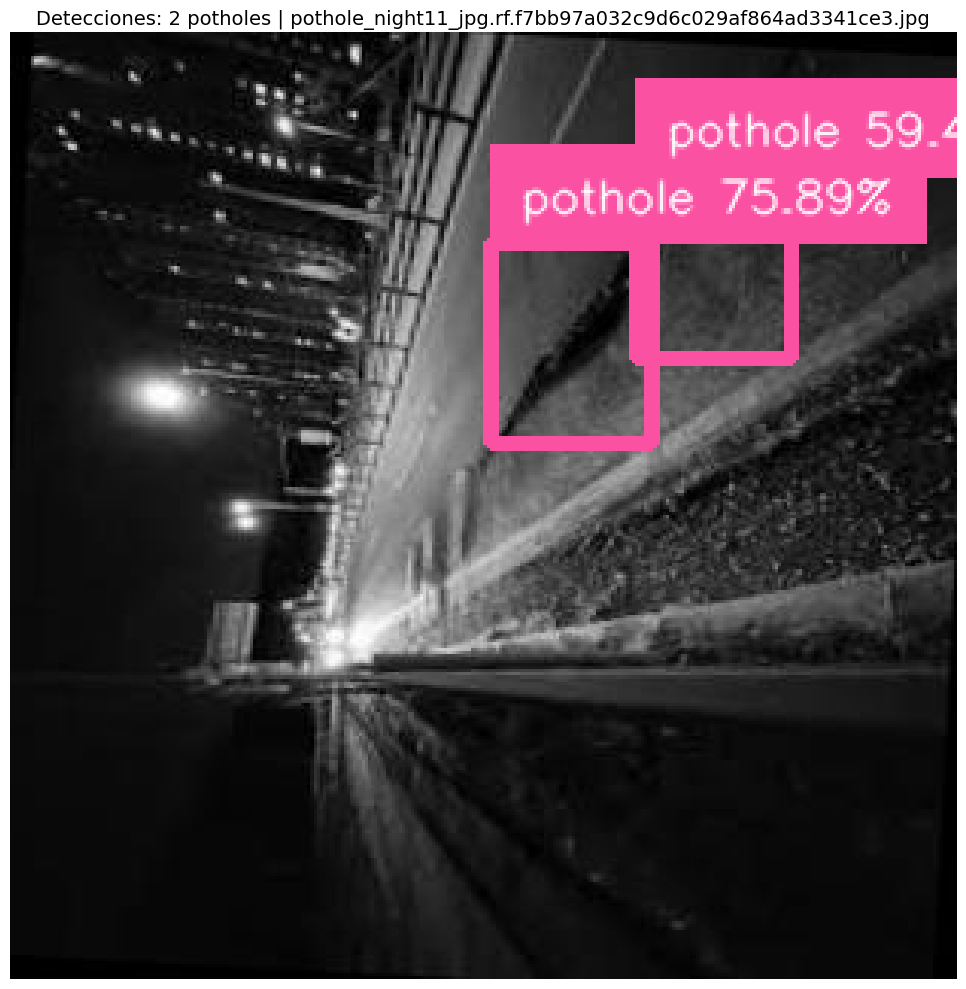


📷 Procesando [81/5]: pothole_night17_png_jpg.rf.766cfc52deb268f74fdcee9f61a38c9c.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 90.10%
  2. Confianza: 87.83%
  3. Confianza: 73.77%


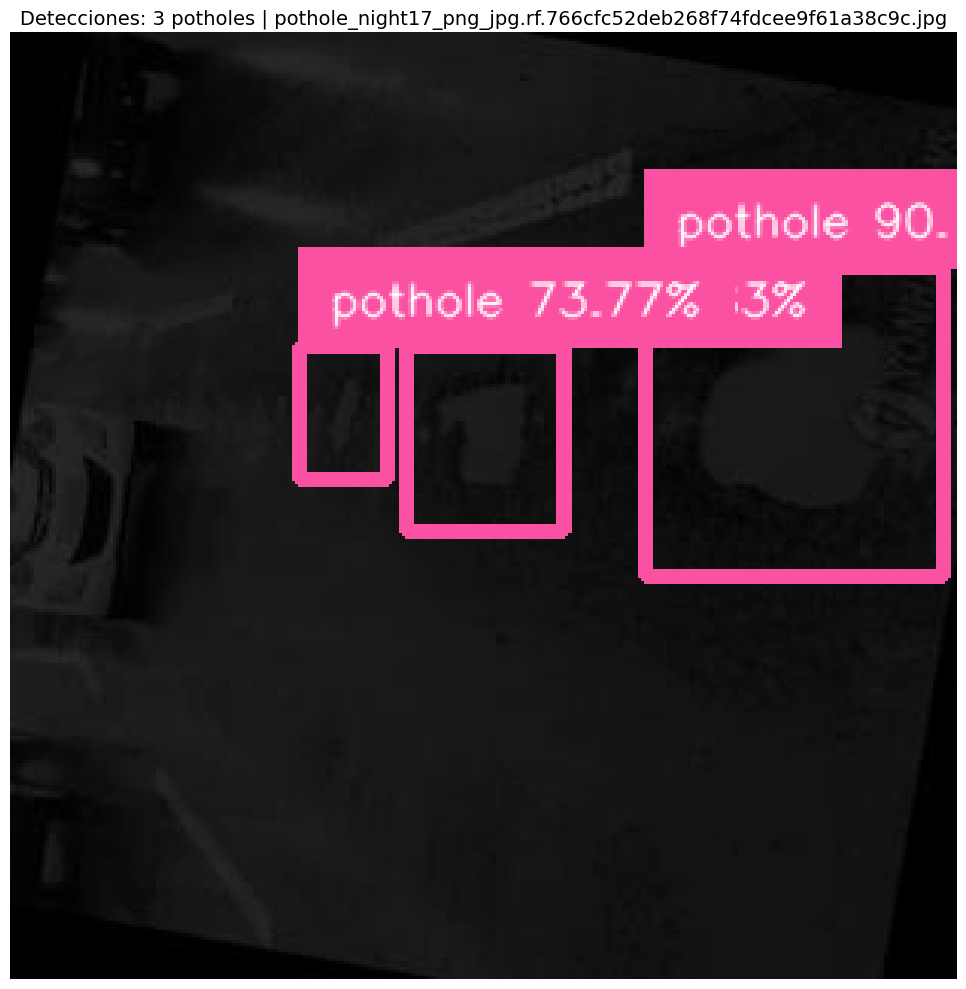


📷 Procesando [82/5]: pothole_night20_png_jpg.rf.c00267acdf666ec713ddb858b5bef75b.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 89.98%


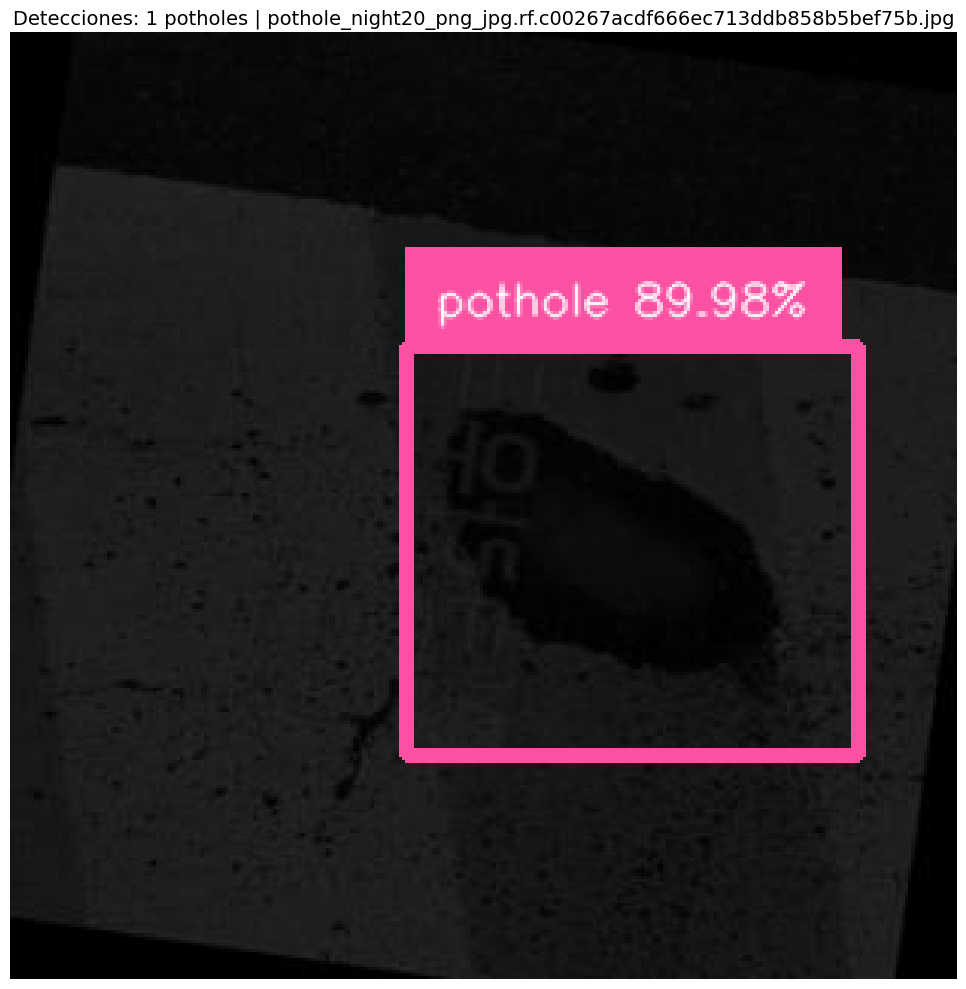


📷 Procesando [83/5]: pothole_night20_png_jpg.rf.f221928b49b66e81c6eedf57531e16e2.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.07%


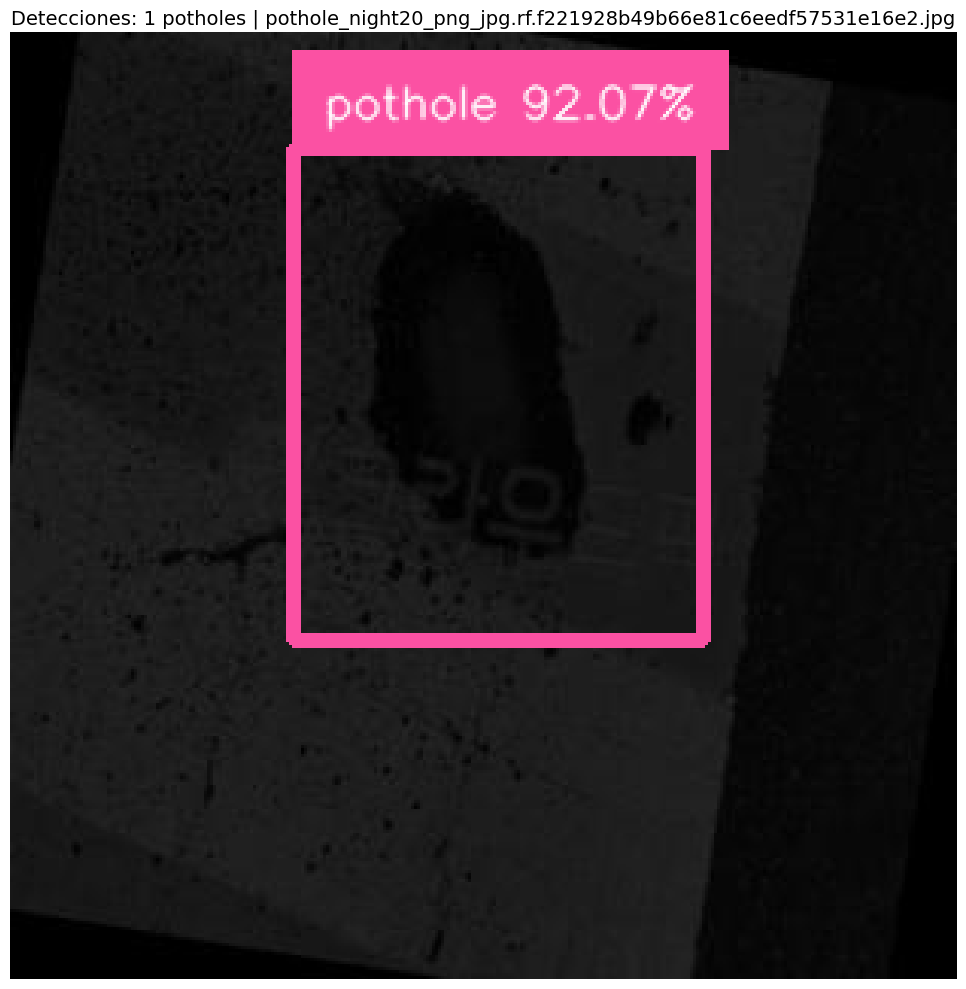


📷 Procesando [84/5]: pothole_night26_png.rf.c6924349feaa0441f3ecbaec6e583f79.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.59%


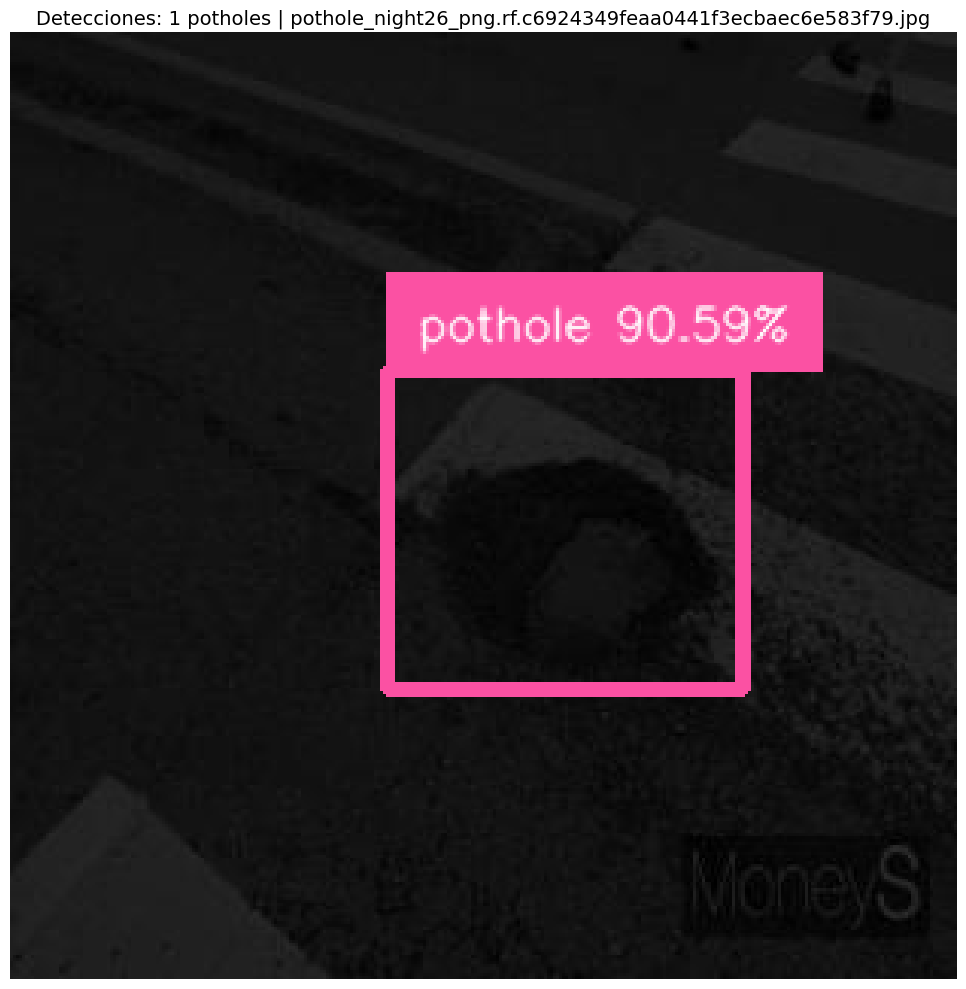


📷 Procesando [85/5]: pothole_night36_png_jpg.rf.7e04e58c769b6730372b764f021e1c9f.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.54%


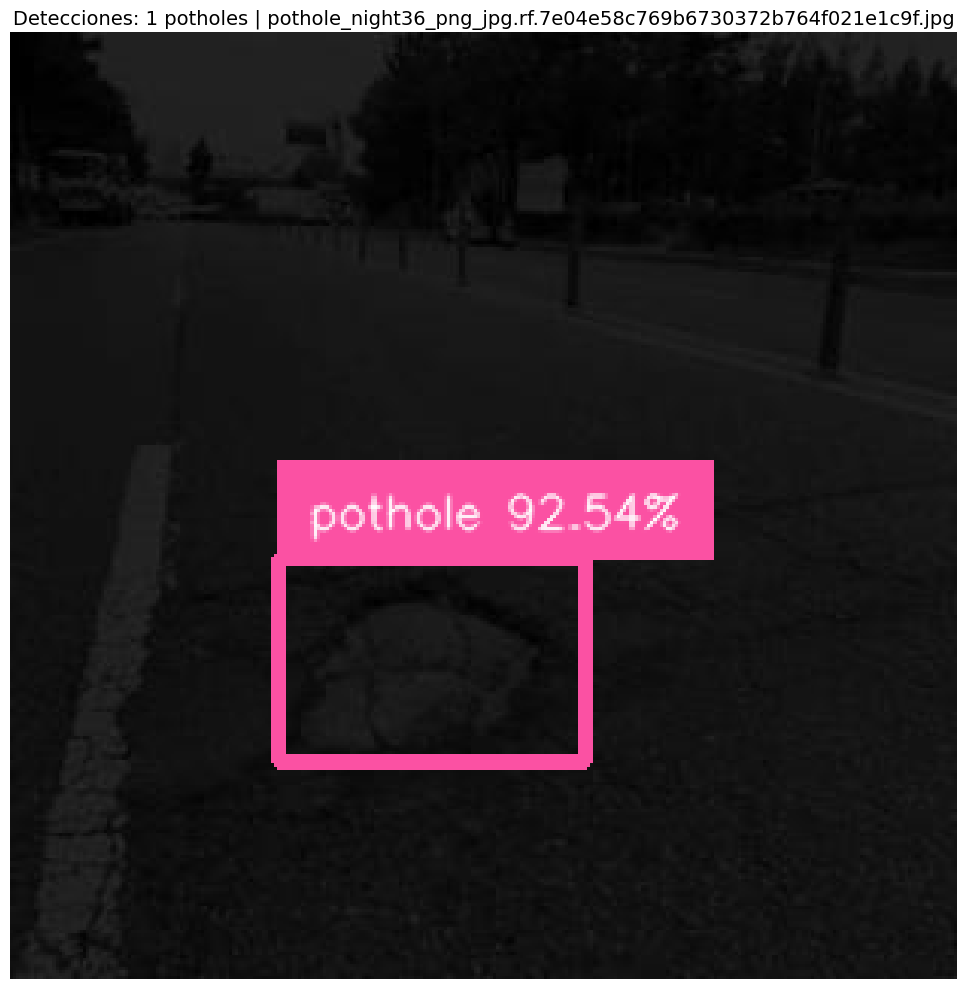


📷 Procesando [86/5]: pothole_night42_png.rf.ec4517caffc5ef255ff46babf65e0f69.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.39%


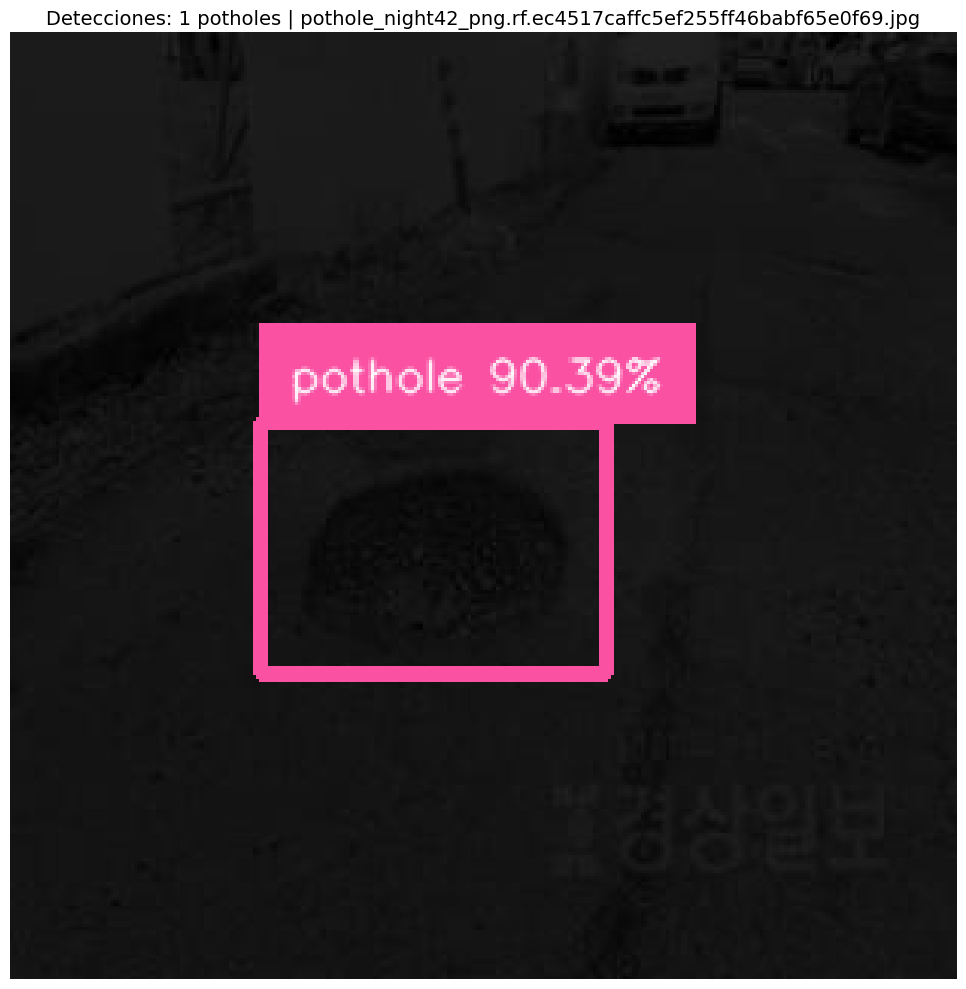


📷 Procesando [87/5]: pothole_night48_png_jpg.rf.02703d7e8faa071c000e65f5c8edfe20.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 87.75%
  2. Confianza: 50.15%


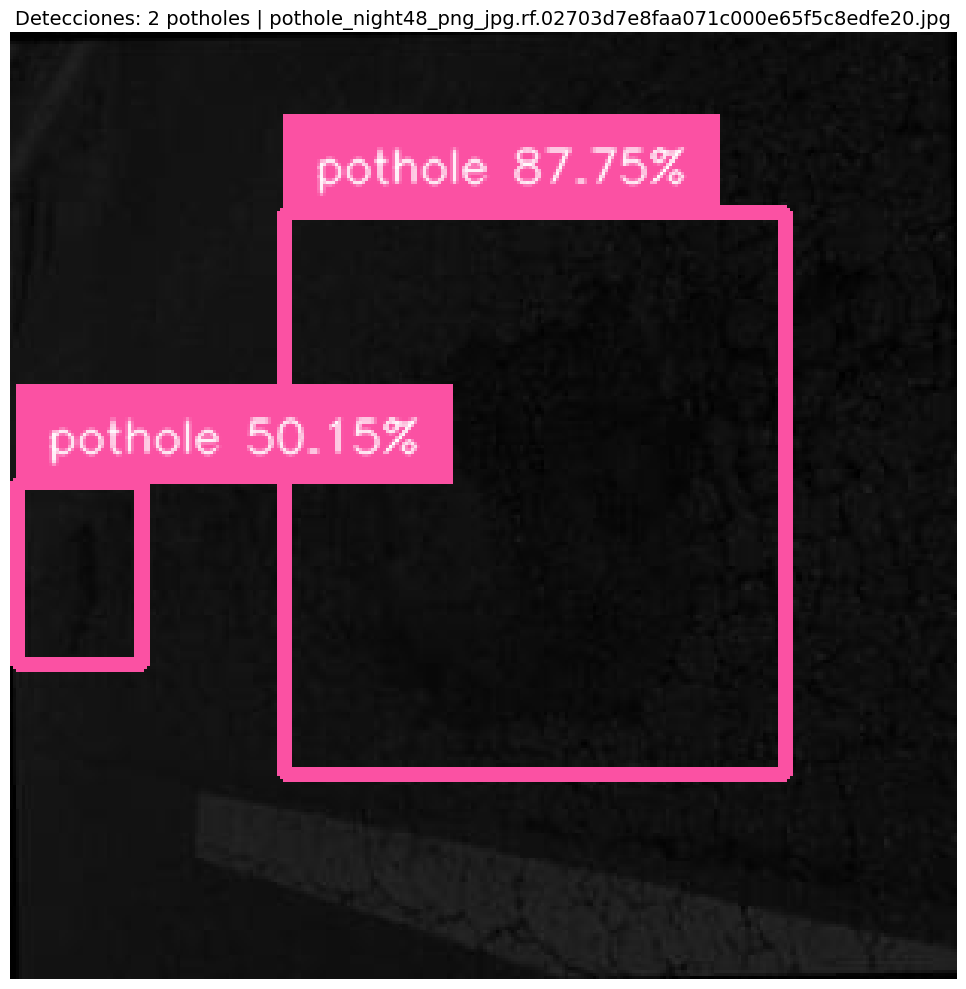


📷 Procesando [88/5]: pothole_night50_png_jpg.rf.bd937faa2d6937c570f64d0a116bb186.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 88.69%


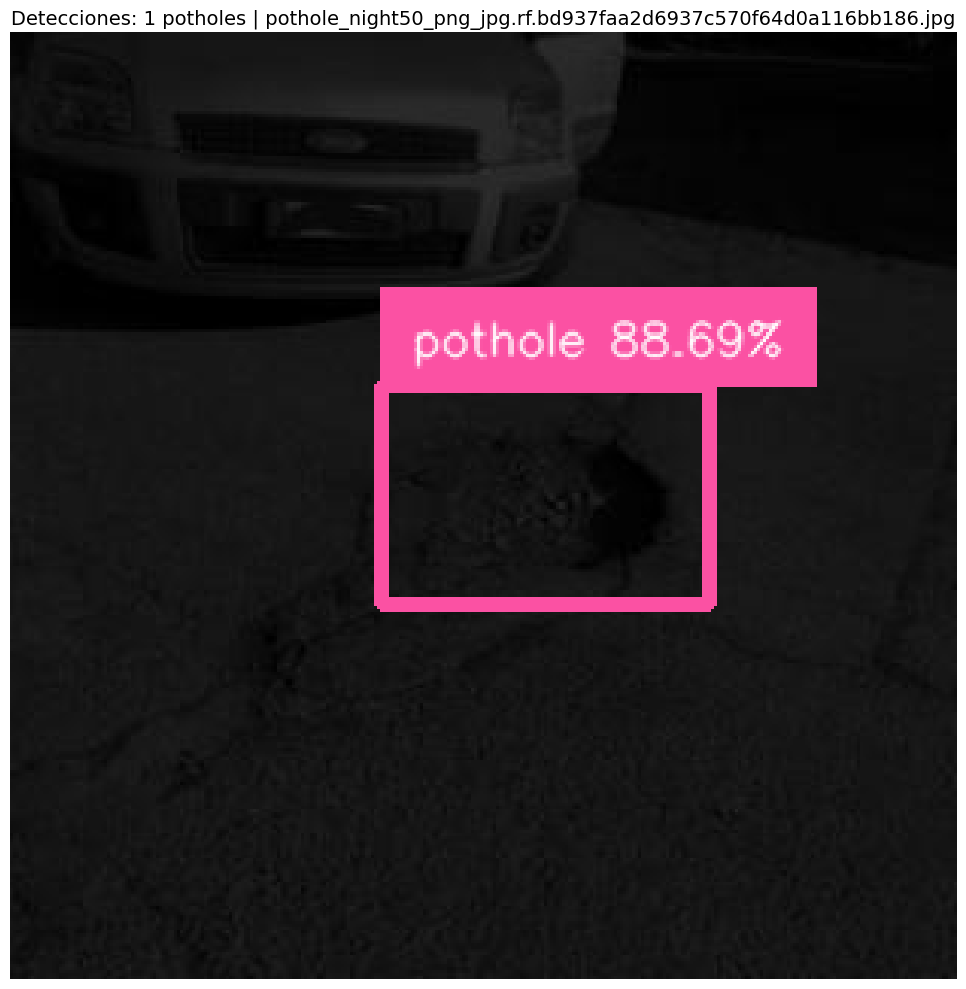


📷 Procesando [89/5]: pothole_night52_png_jpg.rf.b23e703e7cabf247e7b30a2332532cc1.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 92.67%


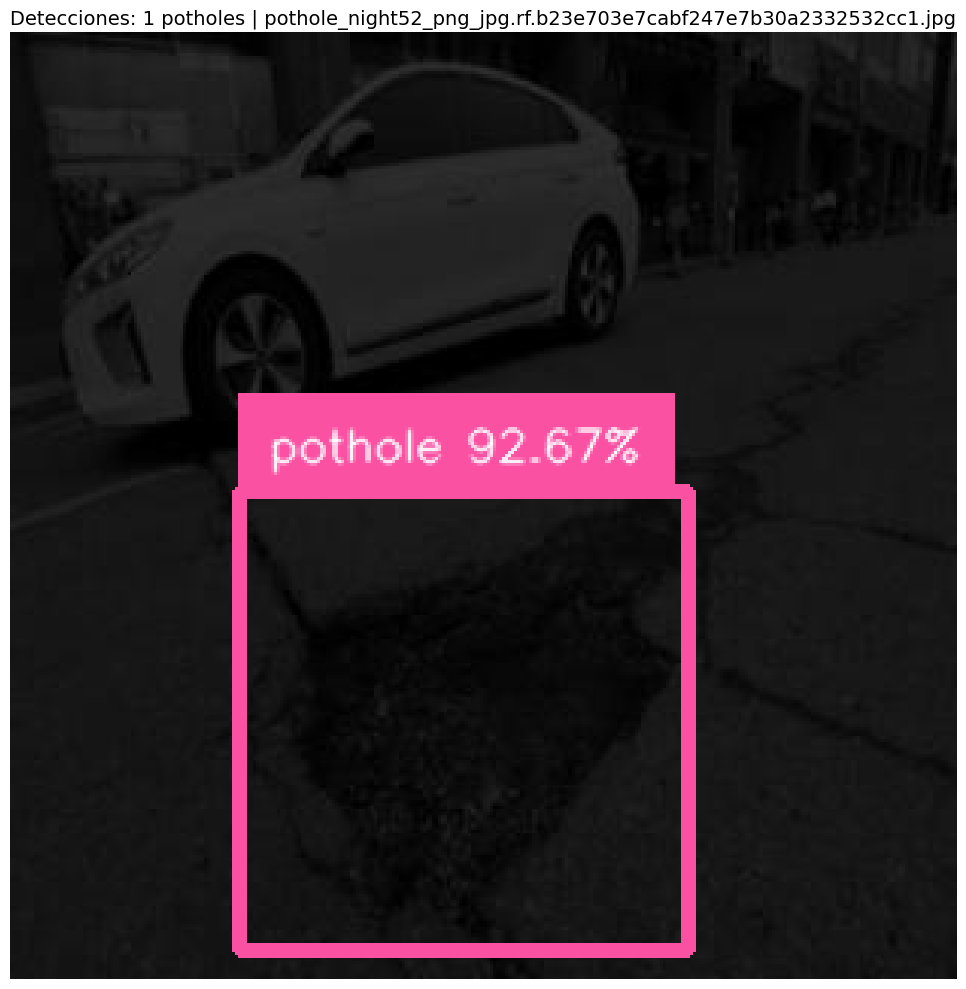


📷 Procesando [90/5]: pothole_night54_png.rf.695d8e76c3f287dcaaa0d49e1e898283.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 96.82%


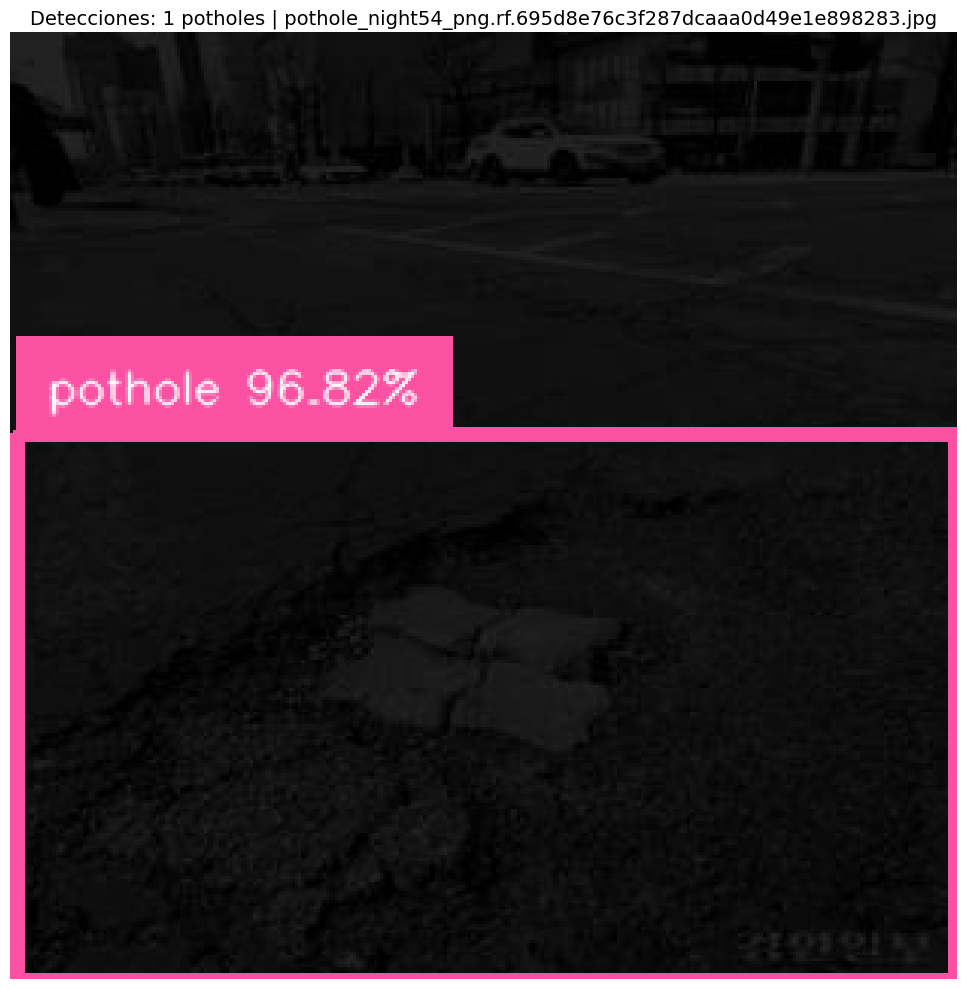


📷 Procesando [91/5]: pothole_night58_png.rf.e632aa9140d3c507e8055eaa1bd10b5e.jpg
🕳️ Potholes detectados: 3
  1. Confianza: 87.06%
  2. Confianza: 80.70%
  3. Confianza: 79.09%


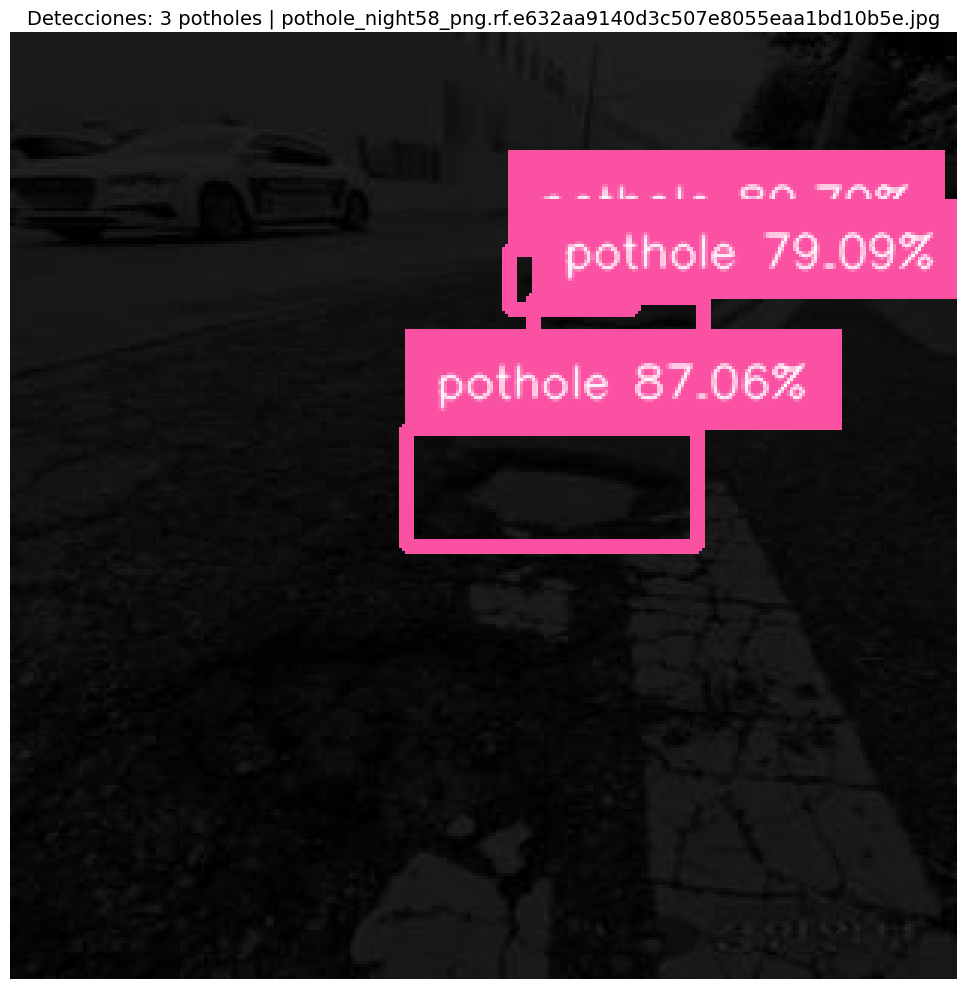


📷 Procesando [92/5]: pothole_night63_png_jpg.rf.d55ca20d7c699afd9598af0549f12b51.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 90.52%
  2. Confianza: 88.56%


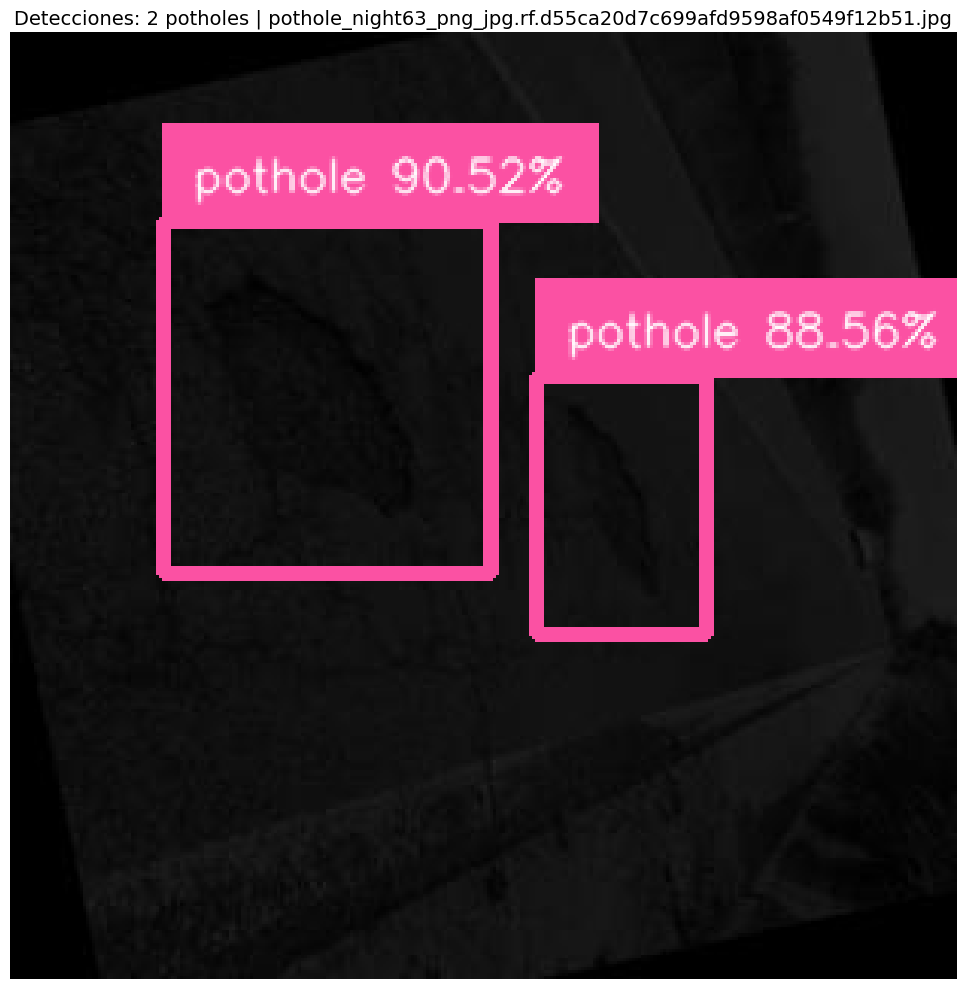


📷 Procesando [93/5]: pothole_night64_png_jpg.rf.2faca4b0875d6358c7749205c5429b56.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 89.99%


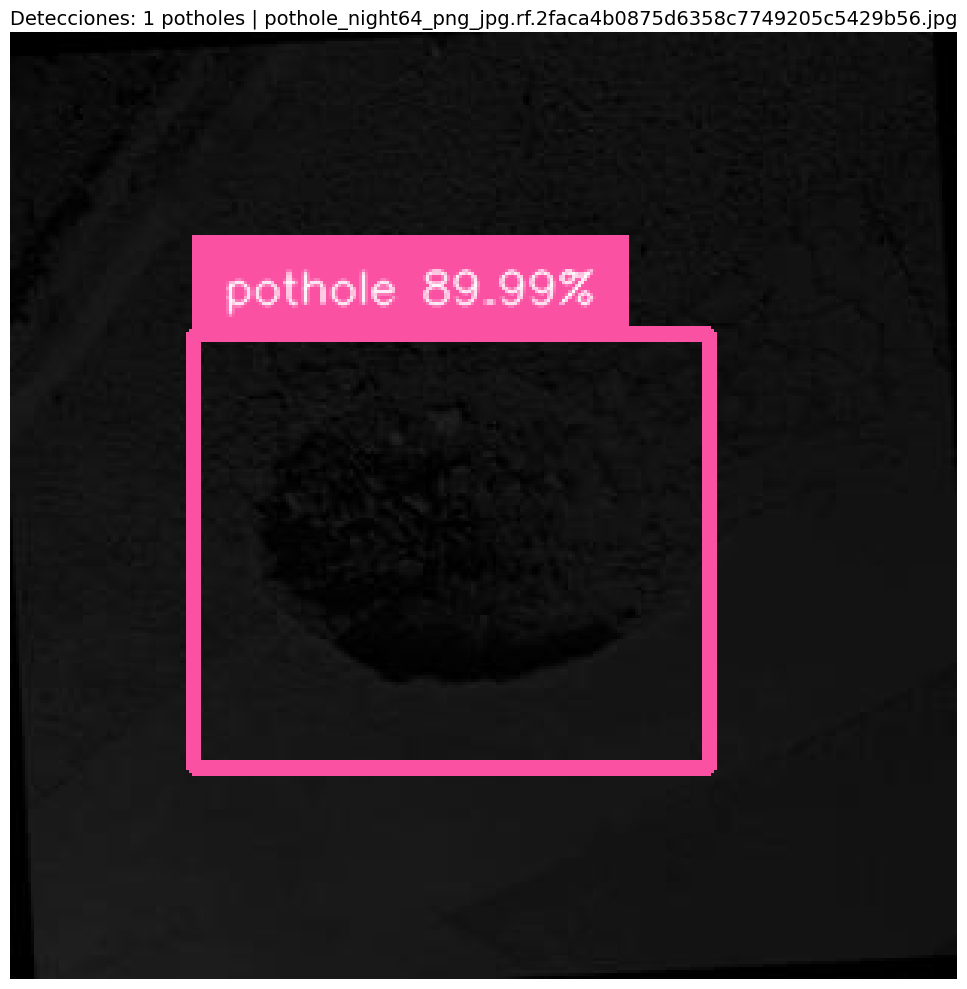


📷 Procesando [94/5]: pothole_night77_png_jpg.rf.1f66728cbab56720952c5b00c9bd9526.jpg
🕳️ Potholes detectados: 6
  1. Confianza: 84.82%
  2. Confianza: 81.27%
  3. Confianza: 80.98%
  4. Confianza: 79.87%
  5. Confianza: 73.23%
  6. Confianza: 61.16%


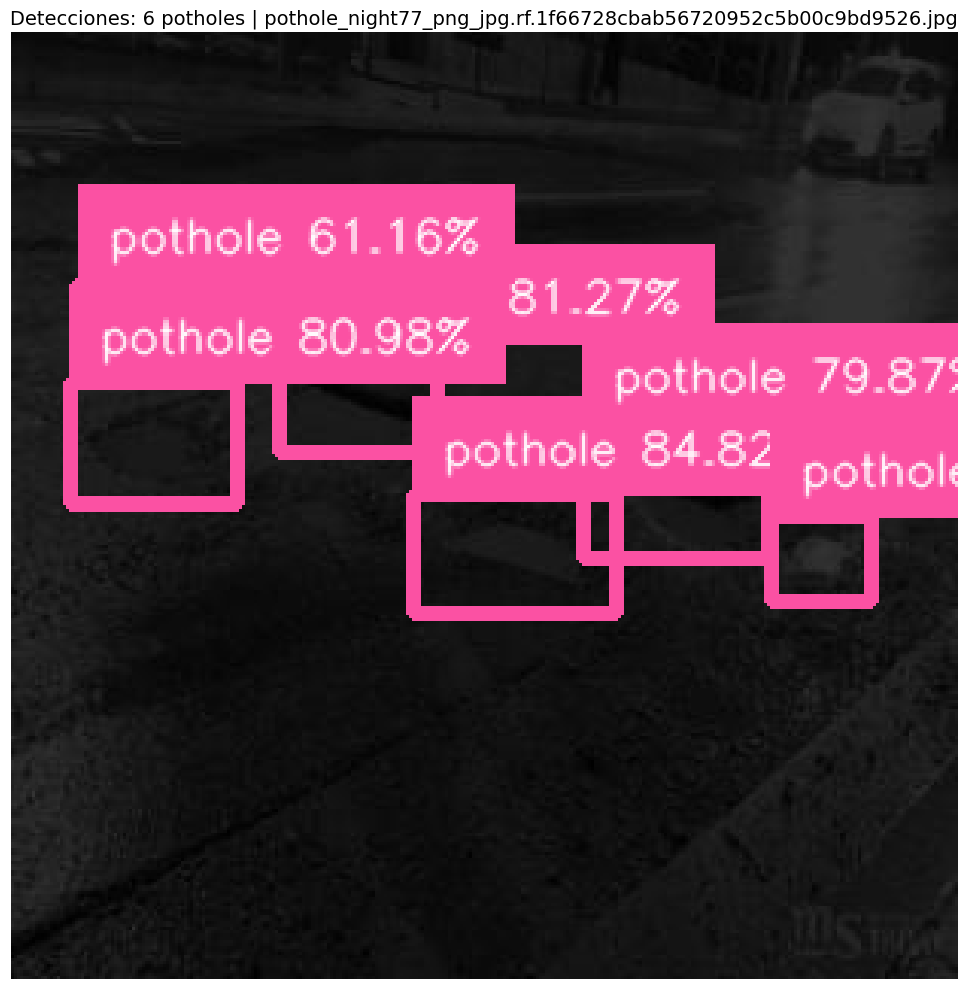


📷 Procesando [95/5]: pothole_night77_png_jpg.rf.6c17d2ce064762a7e84254e9d21a99bb.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 84.97%
  2. Confianza: 81.89%
  3. Confianza: 81.36%
  4. Confianza: 79.66%


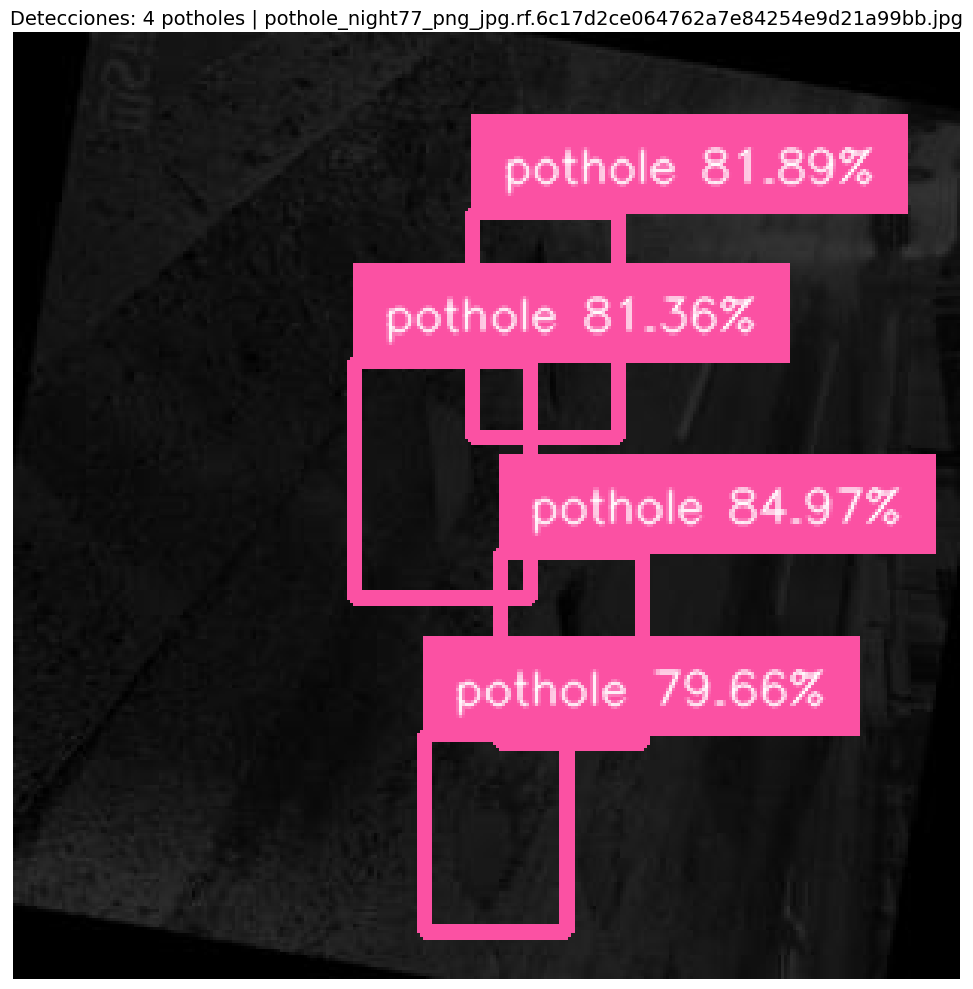


📷 Procesando [96/5]: pothole_night77_png_jpg.rf.f6ef60636db00cf47b7d219767d87a62.jpg
🕳️ Potholes detectados: 5
  1. Confianza: 84.72%
  2. Confianza: 83.01%
  3. Confianza: 79.45%
  4. Confianza: 75.26%
  5. Confianza: 59.81%


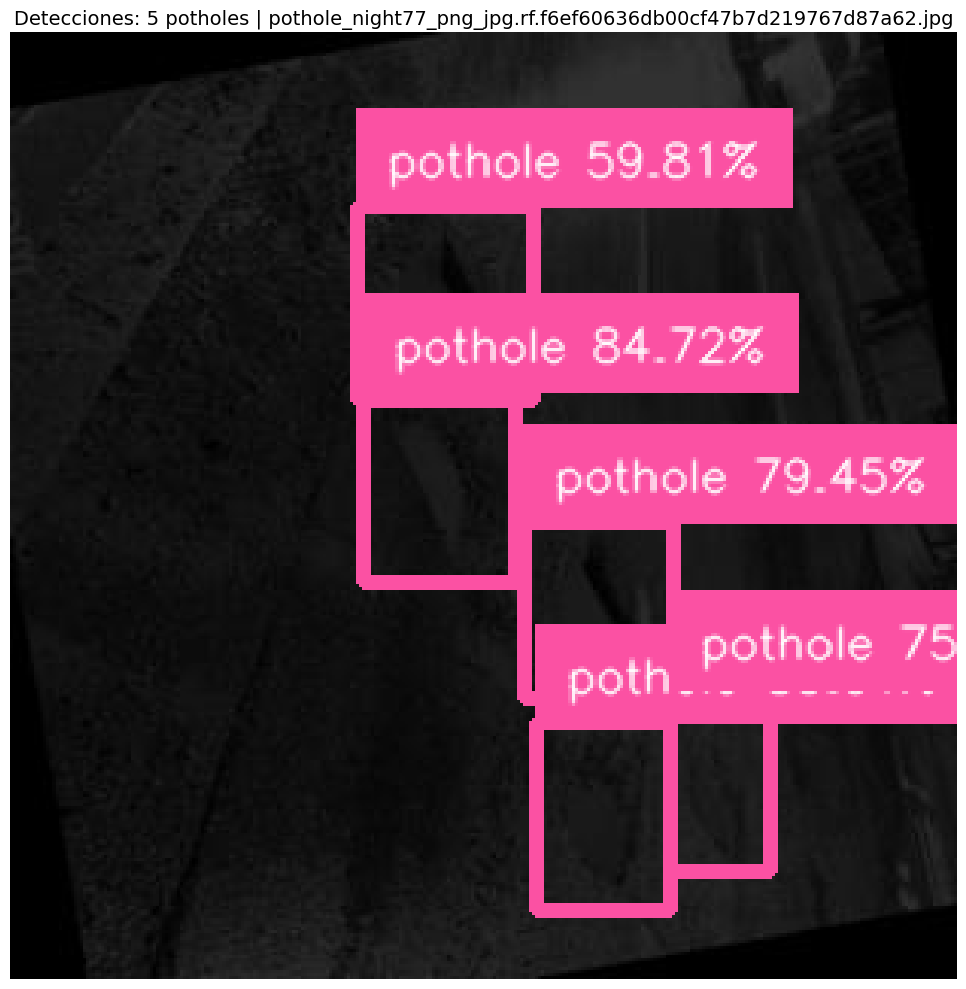


📷 Procesando [97/5]: pothole_night79_png_jpg.rf.2784c62066681f0b2ab7289102e32808.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 91.88%
  2. Confianza: 86.14%


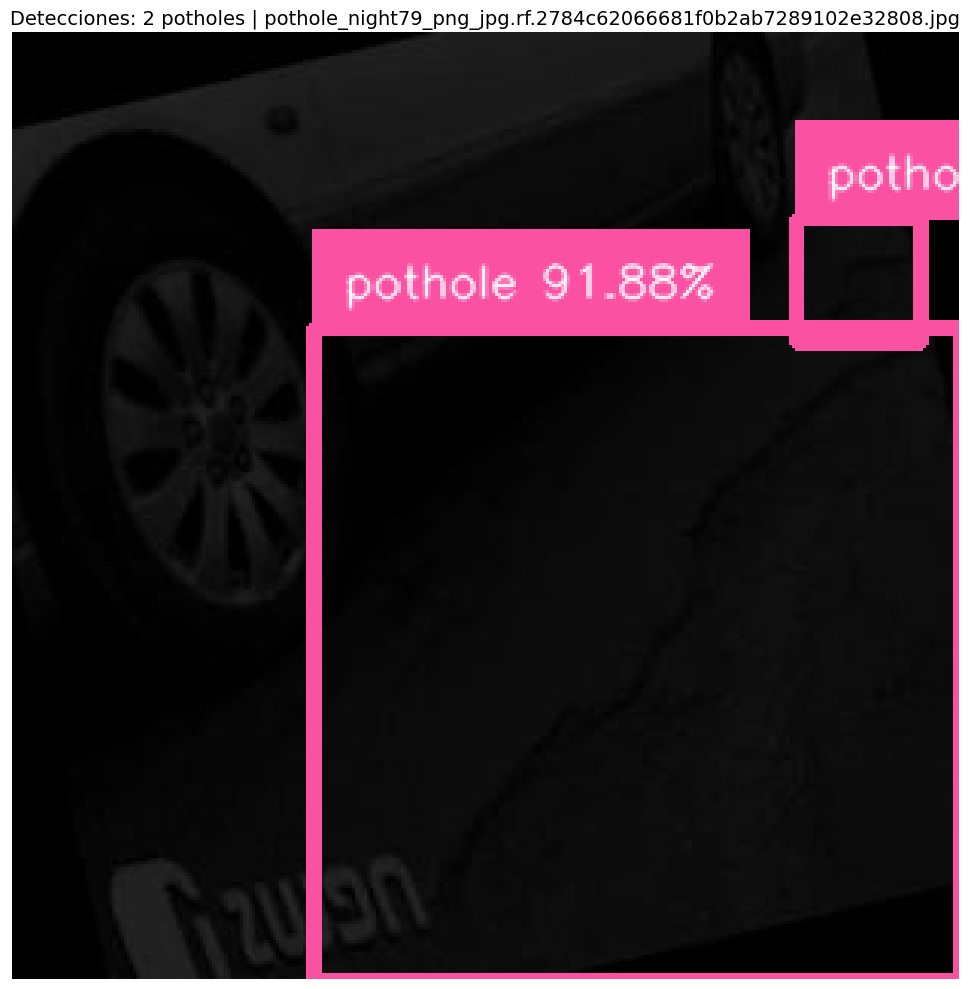


📷 Procesando [98/5]: pothole_night7_jpg.rf.0a603587c7e27001cedb4e11eb24610d.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 83.71%
  2. Confianza: 80.79%
  3. Confianza: 75.26%
  4. Confianza: 73.33%


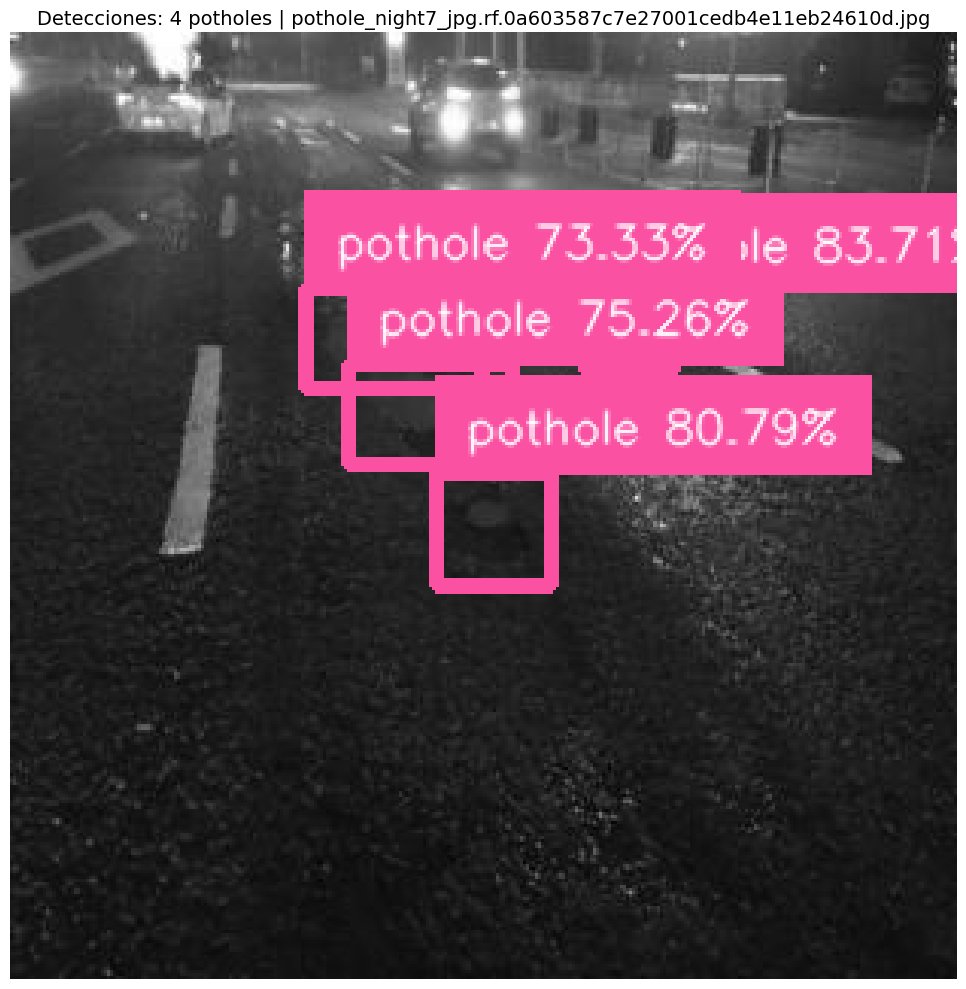


📷 Procesando [99/5]: pothole_night83_jpg.rf.df47ed9dd766486f3827b9a5dcae7a78.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 90.93%
  2. Confianza: 84.82%


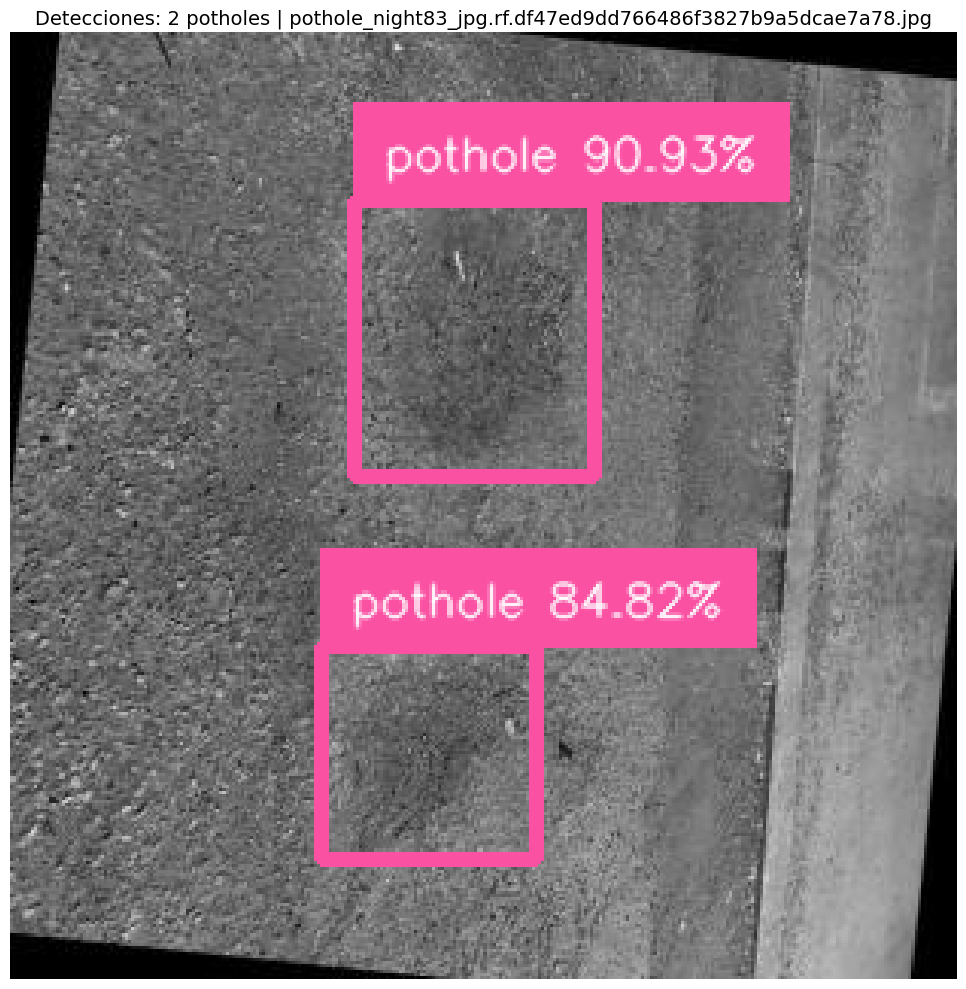


📷 Procesando [100/5]: pothole_night83_jpg.rf.f6bb4fa2ab944e9ca4cecfede929f1b3.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 91.12%
  2. Confianza: 89.28%


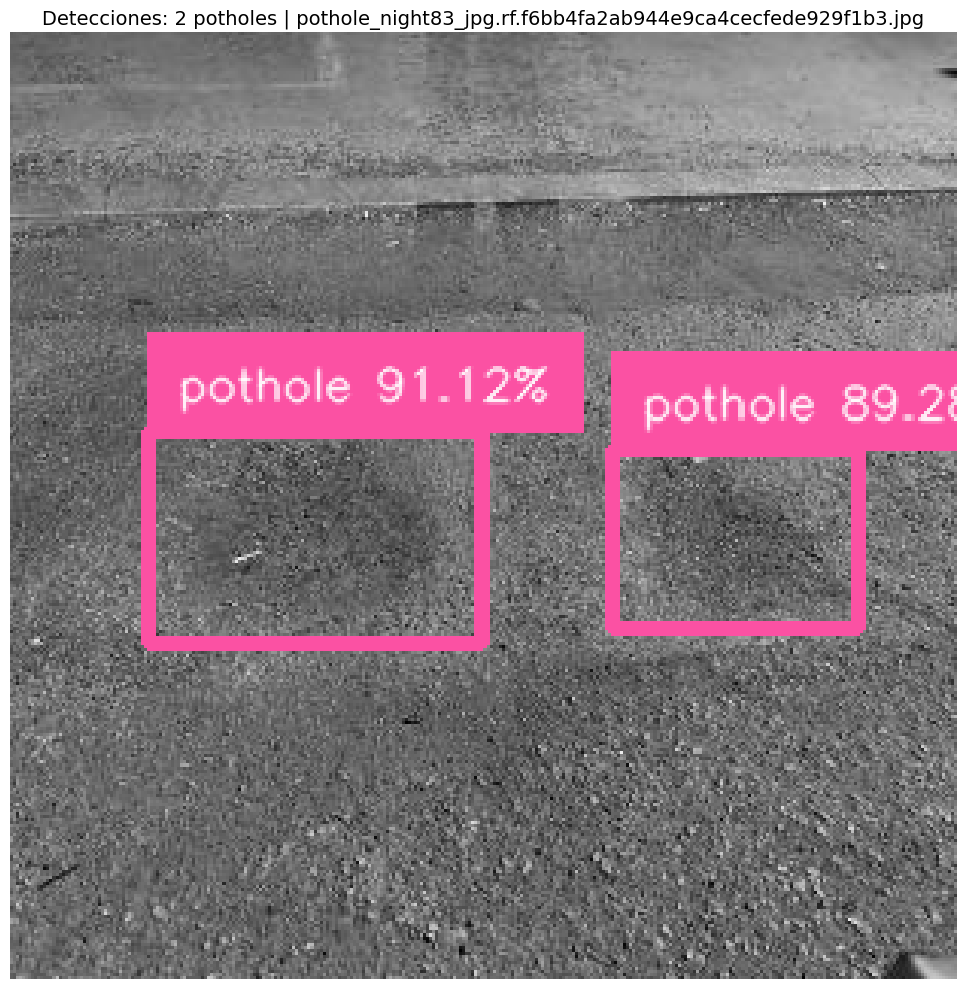


📷 Procesando [101/5]: pothole_night87_png_jpg.rf.164e785a3682595bd20d0a2e3b39a857.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 91.94%


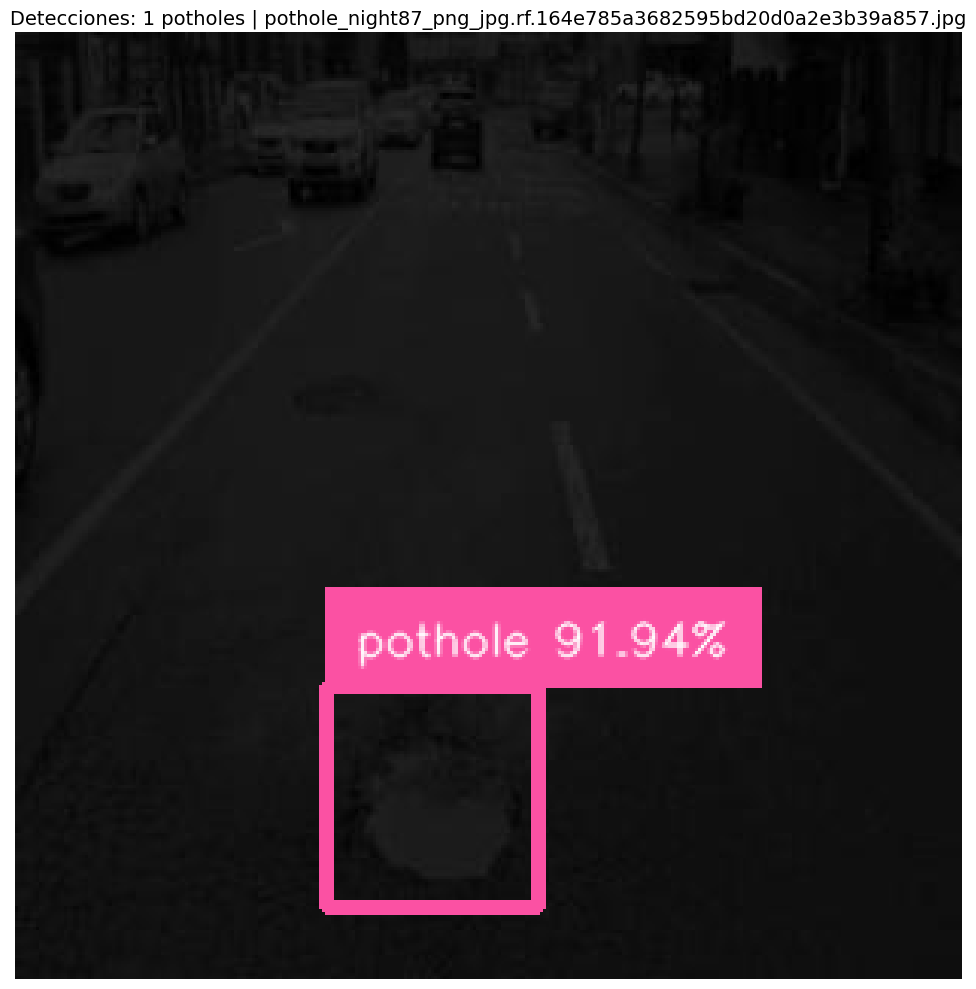


📷 Procesando [102/5]: pothole_night90_jpg.rf.a22cefa4f50fd2c559176c57e77b14aa.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 91.45%


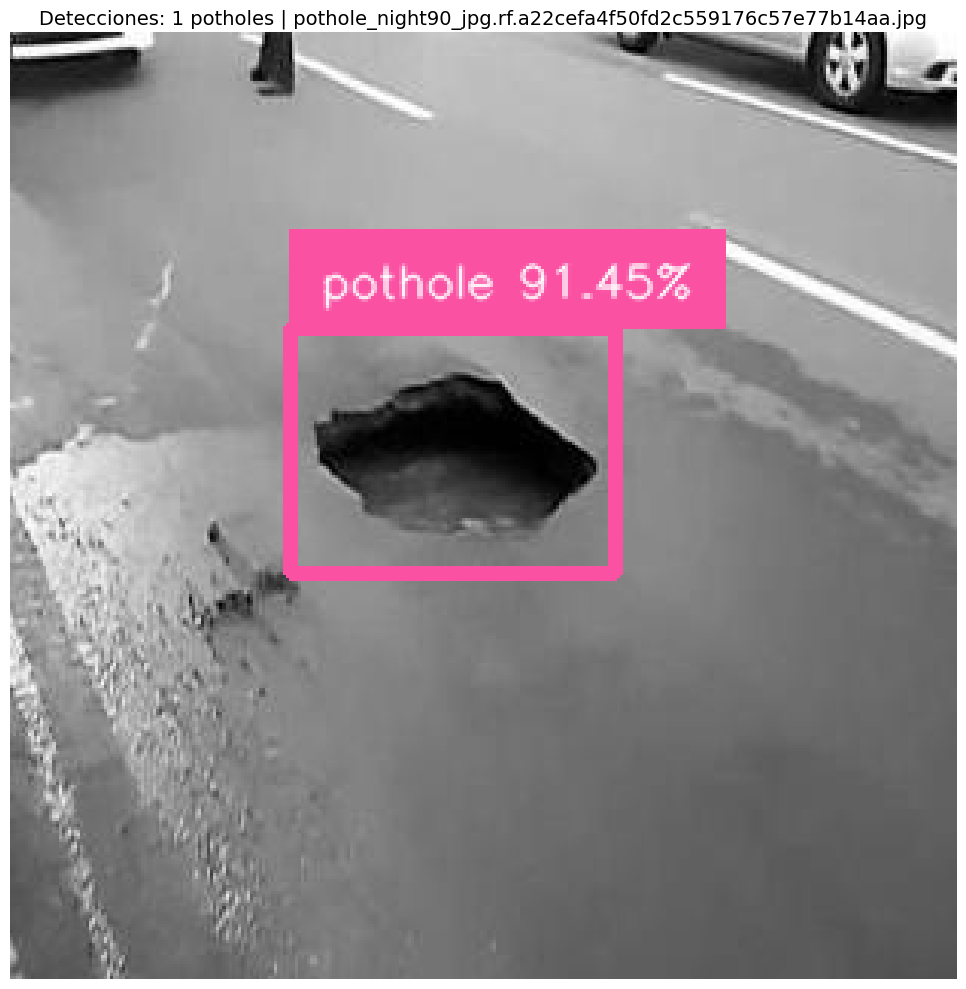


📷 Procesando [103/5]: pothole_rain17_jpg.rf.8acd1bda6333f390c04123cb63b41c52.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 90.93%


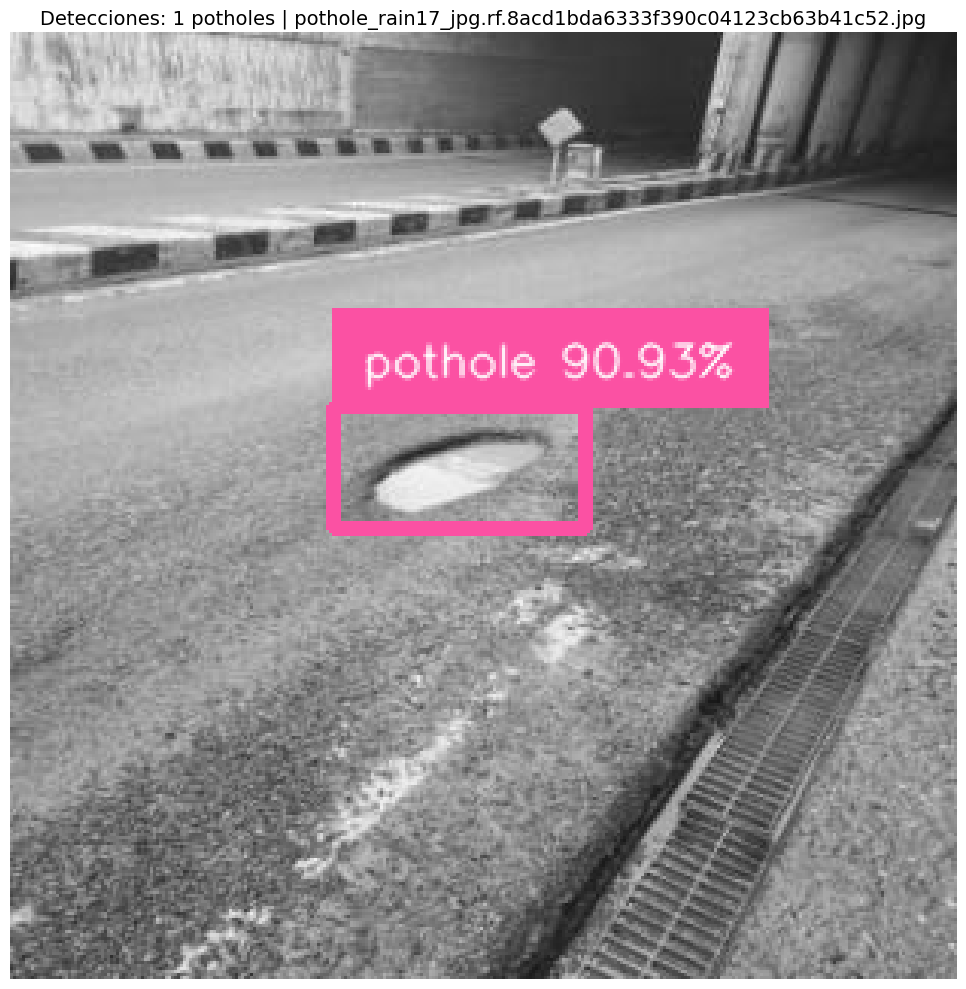


📷 Procesando [104/5]: pothole_rain1_jpg.rf.098d55fe28a6ac7beded566f97aed0c6.jpg
🕳️ Potholes detectados: 5
  1. Confianza: 93.16%
  2. Confianza: 81.00%
  3. Confianza: 79.02%
  4. Confianza: 78.54%
  5. Confianza: 78.08%


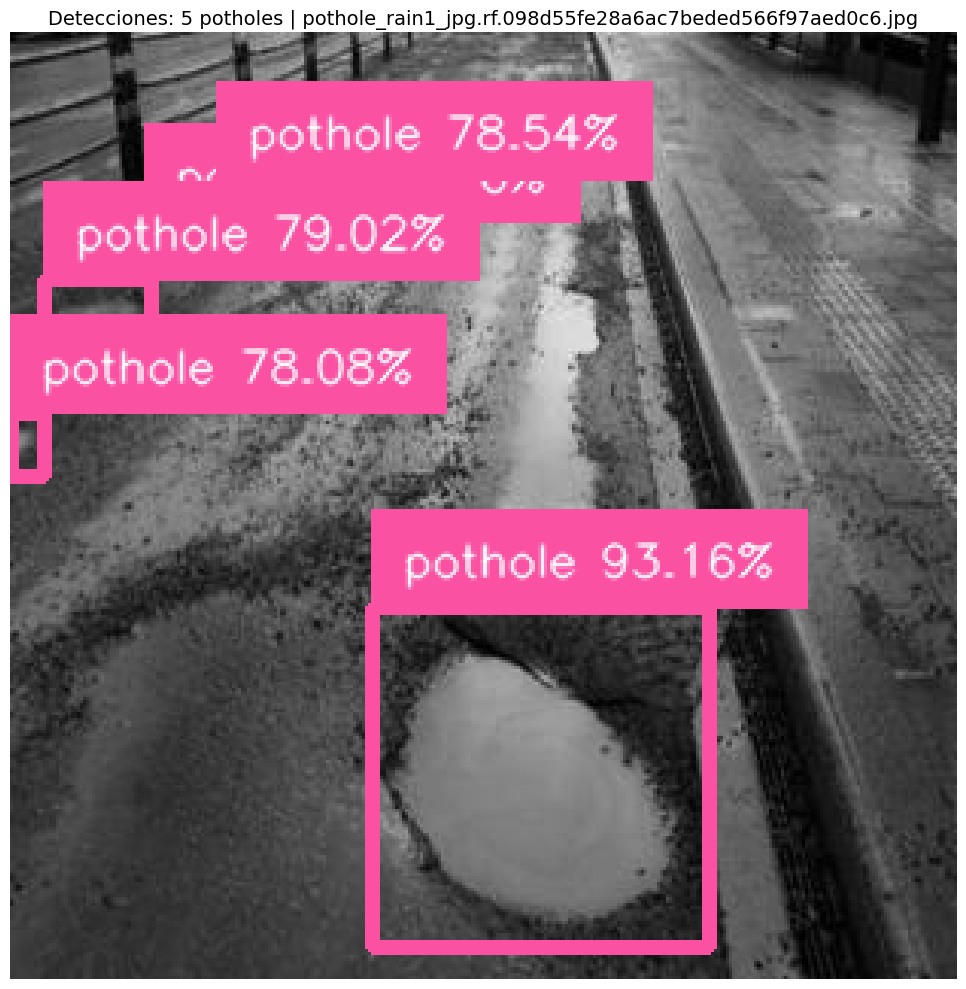


📷 Procesando [105/5]: pothole_rain2_jpg.rf.c5bd6f11a227abc9ad0482e097de6a5f.jpg
🕳️ Potholes detectados: 4
  1. Confianza: 91.29%
  2. Confianza: 88.40%
  3. Confianza: 84.48%
  4. Confianza: 50.70%


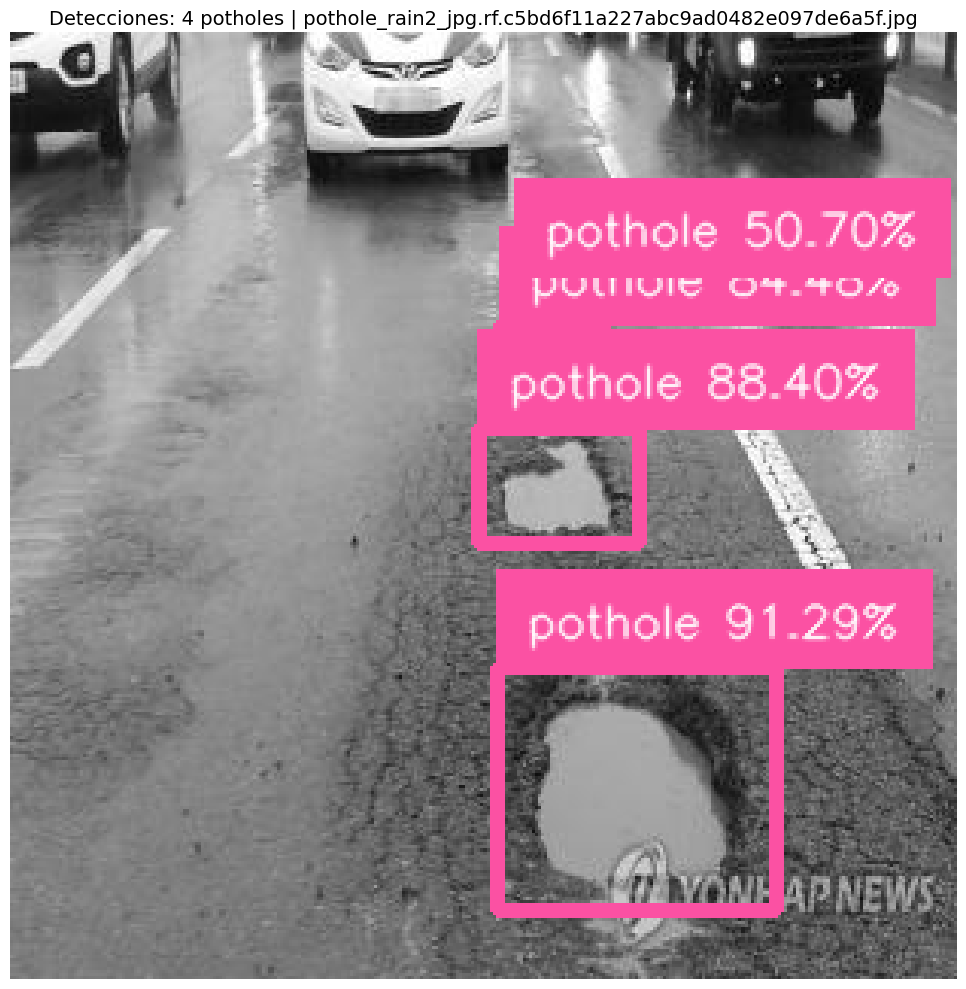


📷 Procesando [106/5]: pothole_rain8_jpg.rf.9b00be0e4c775b8d8531bf2da23b629b.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 89.79%
  2. Confianza: 88.08%


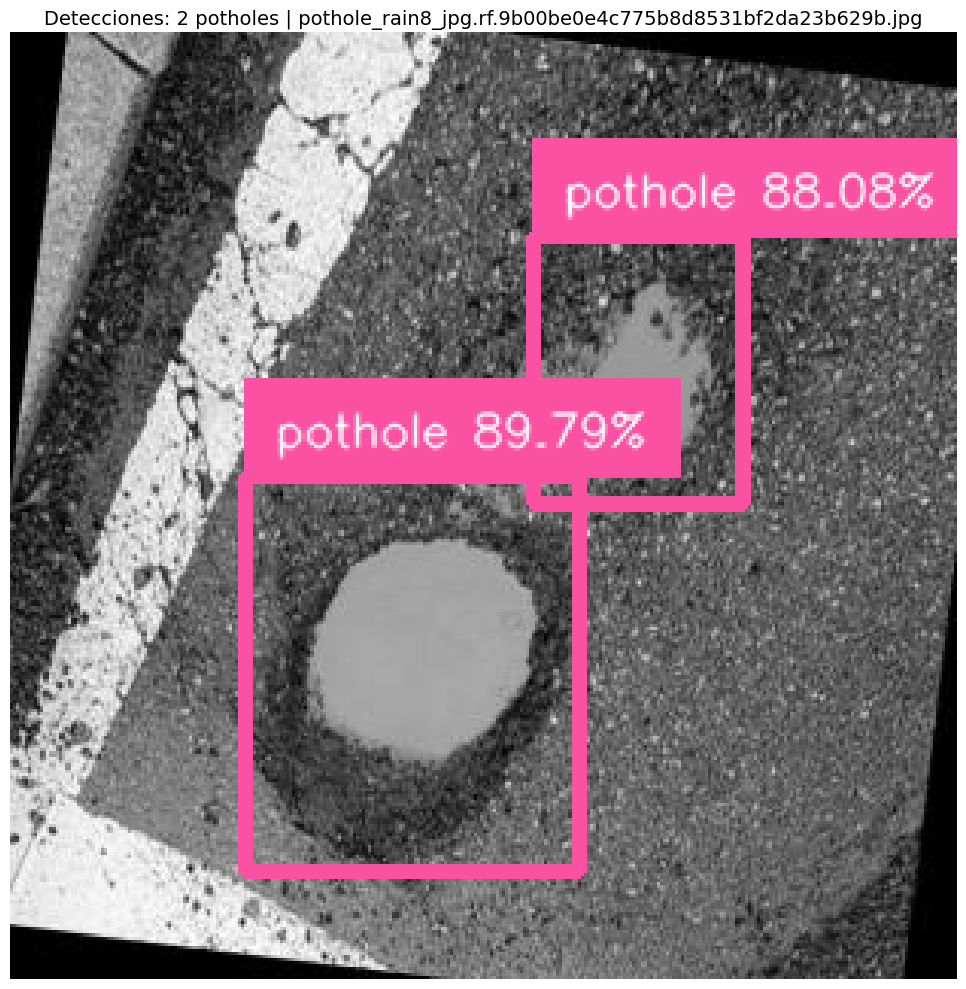


📷 Procesando [107/5]: raining-7274548_960_720_jpg.rf.1e64e90e218433fa7e1dd6f67105ef55.jpg
🕳️ Potholes detectados: 0


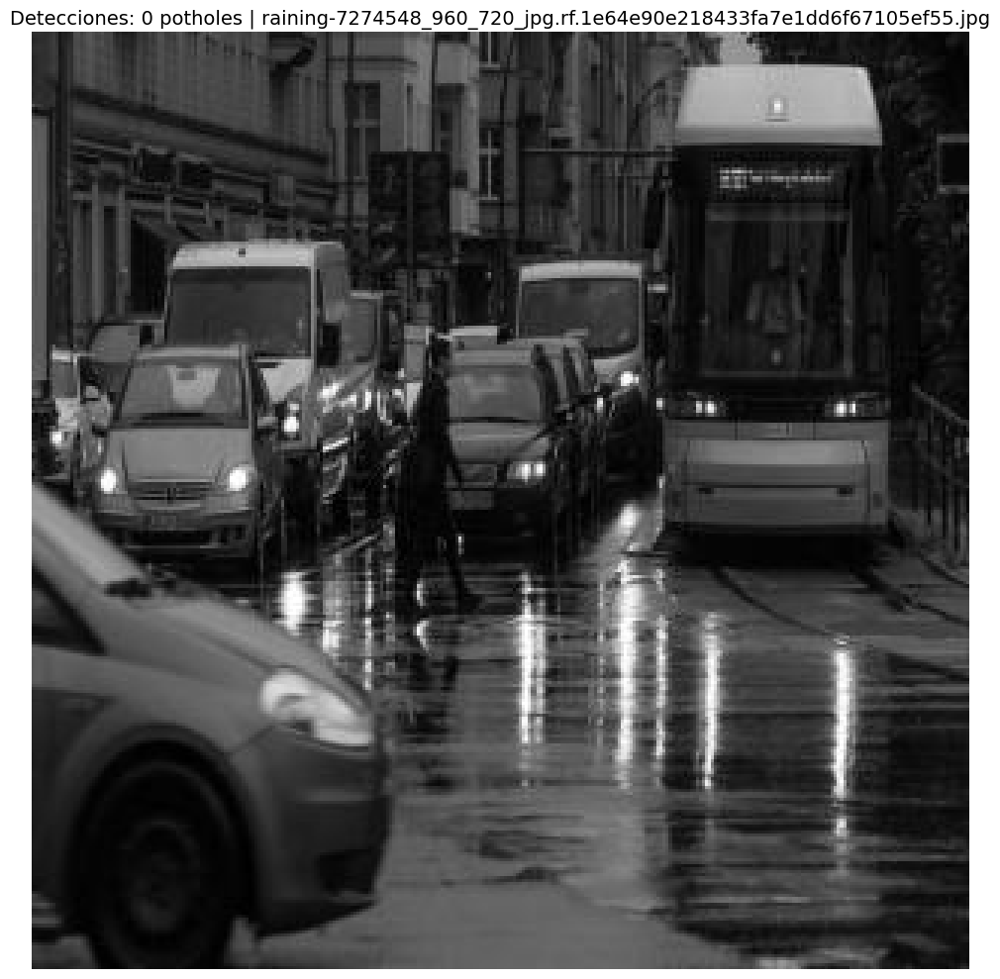


📷 Procesando [108/5]: raining-7274548_960_720_jpg.rf.8f80c4dbe3dea9866372682044406391.jpg
🕳️ Potholes detectados: 0


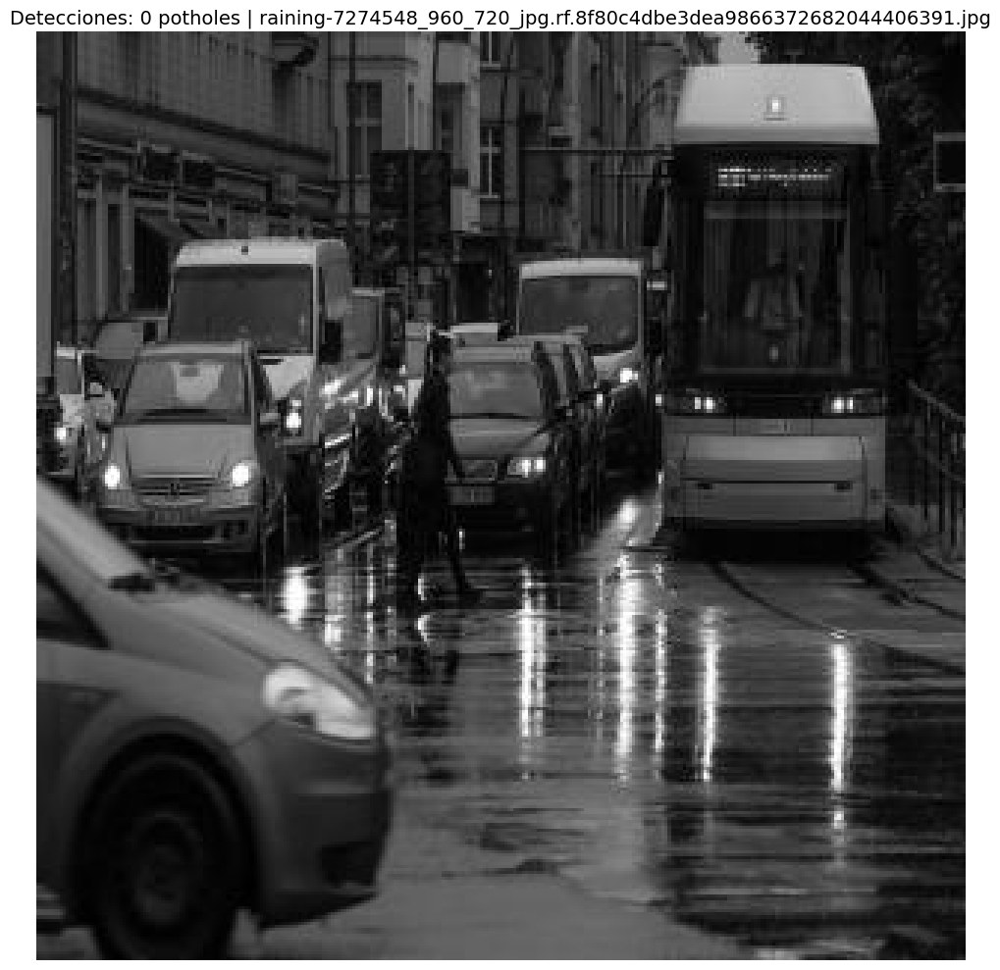


📷 Procesando [109/5]: youtube-18_jpg.rf.7058a39a03779a6877785a092416b8b9.jpg
🕳️ Potholes detectados: 2
  1. Confianza: 79.79%
  2. Confianza: 78.88%


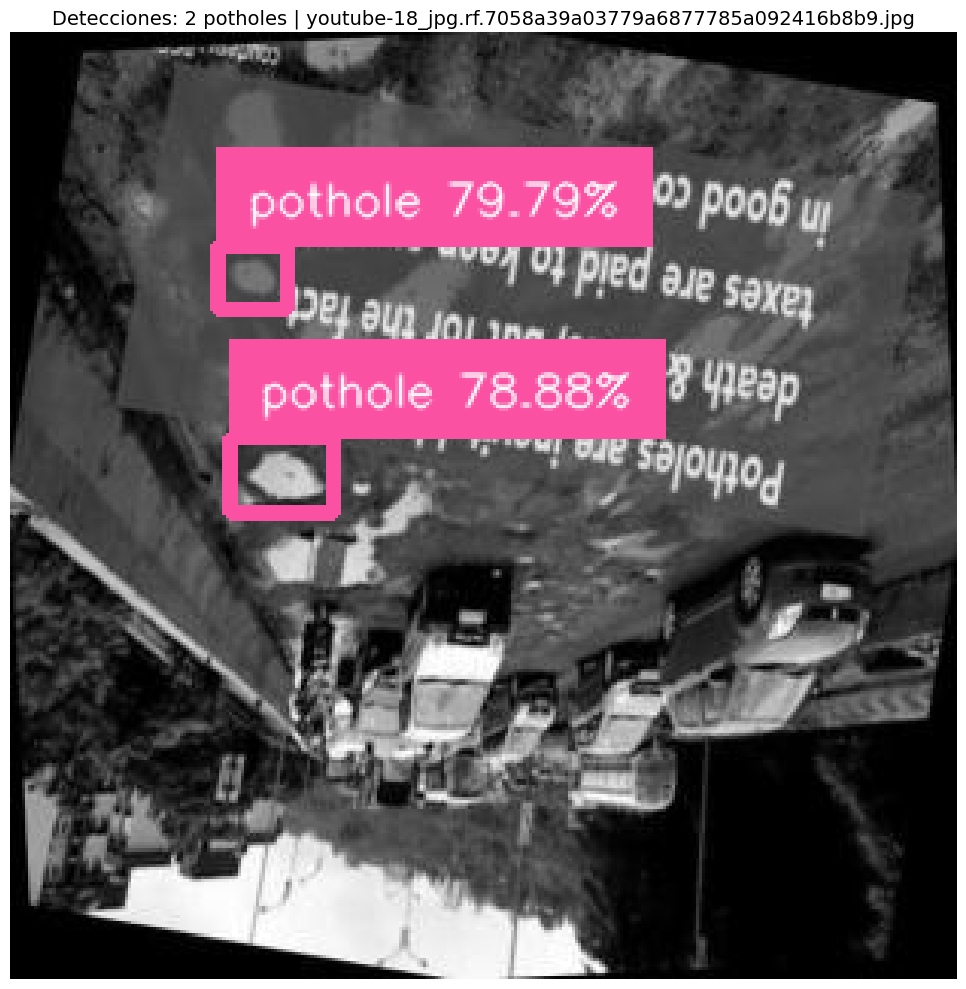


📷 Procesando [110/5]: youtube-21_jpg.rf.abdd5bf89ec545cc8171bf50357a7111.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 94.42%


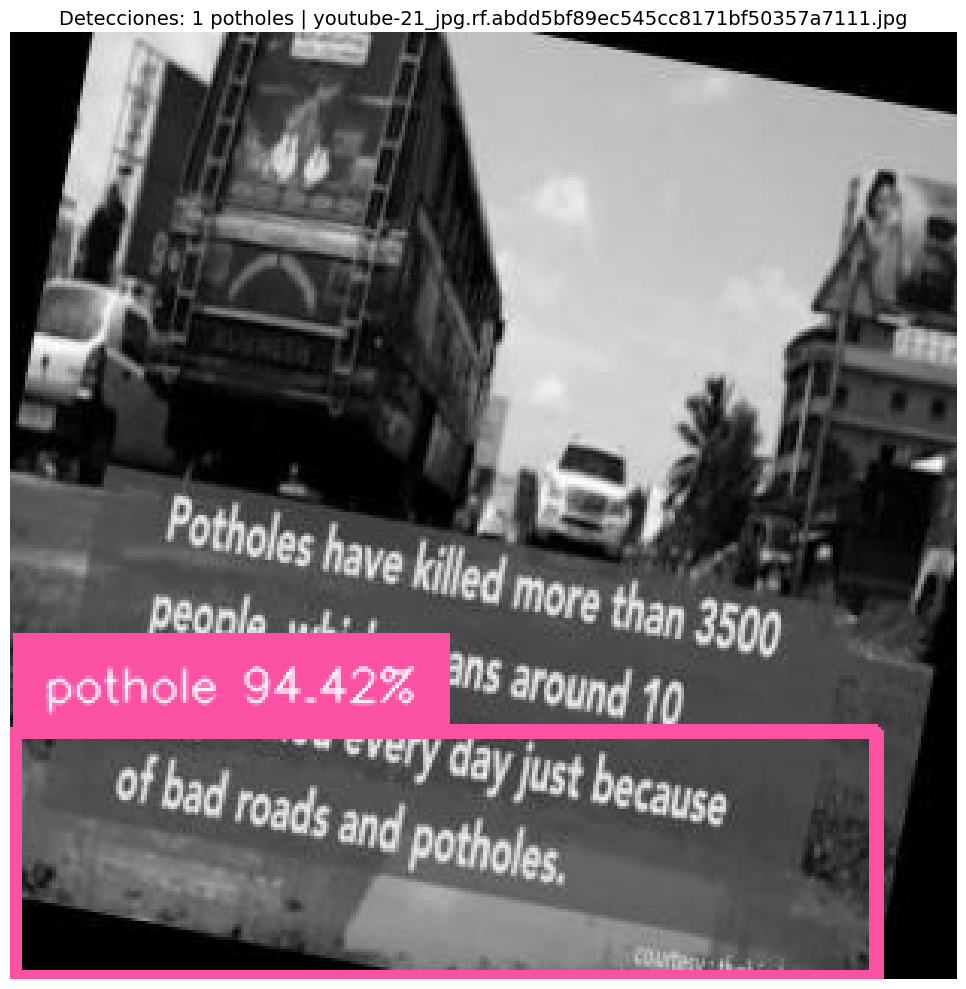


📷 Procesando [111/5]: youtube-25_jpg.rf.81ddf9c41070e106a9dd41a49367fba7.jpg
🕳️ Potholes detectados: 1
  1. Confianza: 93.11%


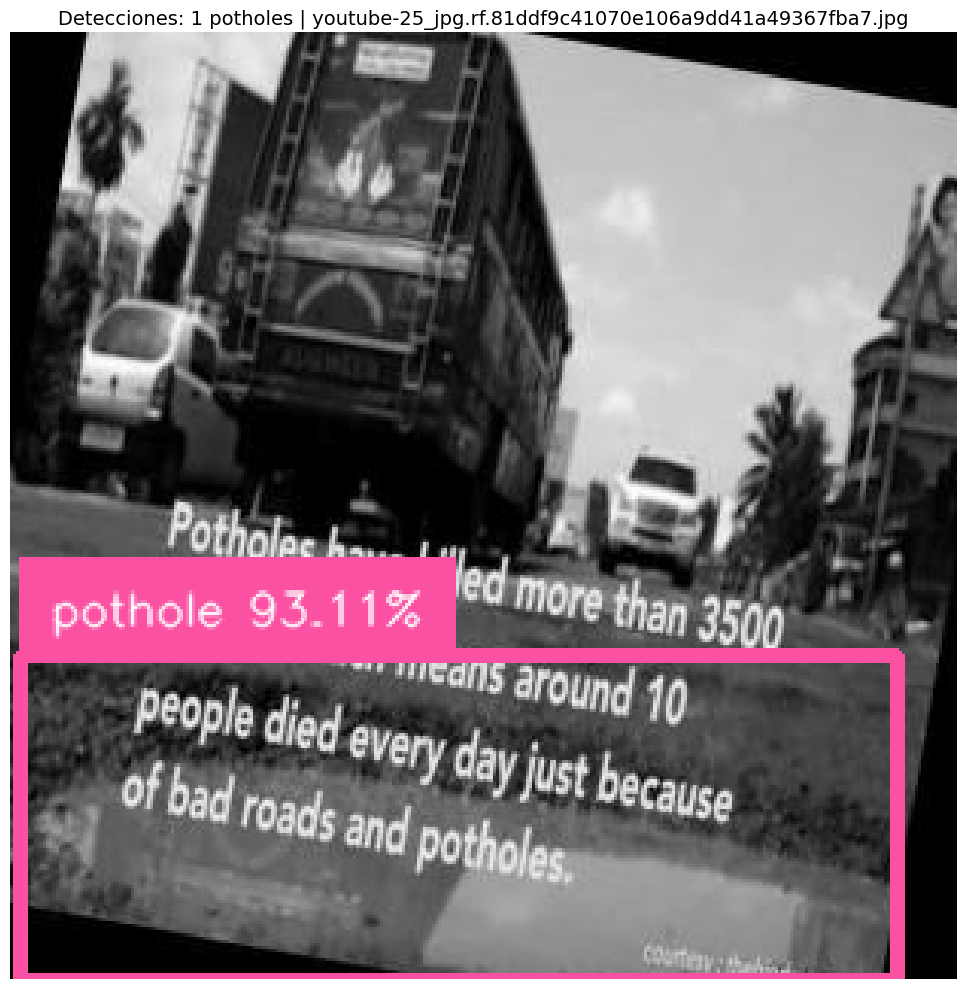


📊 RESUMEN FINAL
✅ Imágenes procesadas: 5
🕳️ Total de potholes detectados: 166
📈 Promedio por imagen: 33.2


In [ ]:

# Configuración de rutas
BASE_DIR = Path(r"D:\Entrenamiento_A")
TEST_DIR = BASE_DIR / "test"
TRAIN_JSON = BASE_DIR / "train" / "_annotations.coco.json"
CHECKPOINT_PATH = BASE_DIR / "models" / "RF-DETR" / "checkpoint_best_ema.pth"

# Cargar número de clases
NUM_CLASSES = len(json.load(open(TRAIN_JSON))["categories"])
print(f"📊 Número de clases: {NUM_CLASSES}")

# Cargar modelo entrenado
print("🔄 Cargando modelo...")
model = RFDETRSmall(num_classes=NUM_CLASSES)
state = torch.load(CHECKPOINT_PATH, map_location="cpu")

# Extraer pesos EMA
if "ema" in state:
    state = state["ema"]
elif "model" in state:
    state = state["model"]

try:
    torch_model = model.model.model
except AttributeError:
    torch_model = model.model

torch_model.load_state_dict(state, strict=False)
model.optimize_for_inference(compile=False)
model.names = ["pothole"]
print("✅ Modelo cargado exitosamente\n")

# Obtener imágenes de prueba
test_images = list(TEST_DIR.glob("*.jpg")) + list(TEST_DIR.glob("*.png"))
print(f"🖼️ Imágenes encontradas: {len(test_images)}\n")

# Configurar anotadores (CORREGIDO)
box_annotator = sv.BoxAnnotator(thickness=3)
label_annotator = sv.LabelAnnotator(text_position=sv.Position.TOP_LEFT)

# Procesar cada imagen
total_detections = 0

for idx, image_path in enumerate(test_images[:]):  # Procesa las primeras 5
    print(f"{'='*60}")
    print(f"📷 Procesando [{idx+1}/{min(5, len(test_images))}]: {image_path.name}")
    print(f"{'='*60}")
    
    # Cargar y predecir
    image = Image.open(image_path).convert("RGB")
    detections = model.predict(image, conf_threshold=0.5)
    
    # Ajustar IDs de clase
    adjusted_class_ids = [int(cid) - 1 for cid in detections.class_id]
    valid_mask = [i for i, cid in enumerate(adjusted_class_ids) if 0 <= cid < NUM_CLASSES]
    
    filtered = sv.Detections(
        xyxy=detections.xyxy[valid_mask],
        confidence=detections.confidence[valid_mask],
        class_id=np.array([adjusted_class_ids[i] for i in valid_mask], dtype=int),
    )
    
    num_potholes = len(filtered)
    total_detections += num_potholes
    
    # Mostrar resultados
    print(f"🕳️ Potholes detectados: {num_potholes}")
    if num_potholes > 0:
        for i, (box, conf) in enumerate(zip(filtered.xyxy, filtered.confidence)):
            print(f"  {i+1}. Confianza: {conf:.2%}")
    
    # Visualizar
    annotated_image = box_annotator.annotate(scene=np.array(image).copy(), detections=filtered)
    labels = [f"pothole {conf:.2%}" for conf in filtered.confidence]
    annotated_image = label_annotator.annotate(scene=annotated_image, detections=filtered, labels=labels)
    
    plt.figure(figsize=(14, 10))
    plt.imshow(annotated_image)
    plt.axis("off")
    plt.title(f"Detecciones: {num_potholes} potholes | {image_path.name}", fontsize=14)
    plt.tight_layout()
    plt.show()
    
    print()

# Resumen final
print(f"{'='*60}")
print(f"📊 RESUMEN FINAL")
print(f"{'='*60}")
print(f"✅ Imágenes procesadas: {min(5, len(test_images))}")
print(f"🕳️ Total de potholes detectados: {total_detections}")
print(f"{'='*60}")


## Pruebas con imágenes diferentes.


🔄 Cargando modelo RF-DETR...
Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Loading pretrain weights


✅ Modelo cargado exitosamente!

📂 Selecciona una o varias imágenes desde tu PC...
✅ 5 imagen(es) seleccionada(s)


📷 PROCESANDO [1/5]: 67ec378554fdd.jpeg
📐 Dimensiones: 414 x 238 px
🔍 Detectando potholes...

🕳️ POTHOLES DETECTADOS: 1
  Pothole #1: Confianza 89.71% | Tamaño: 101x48px


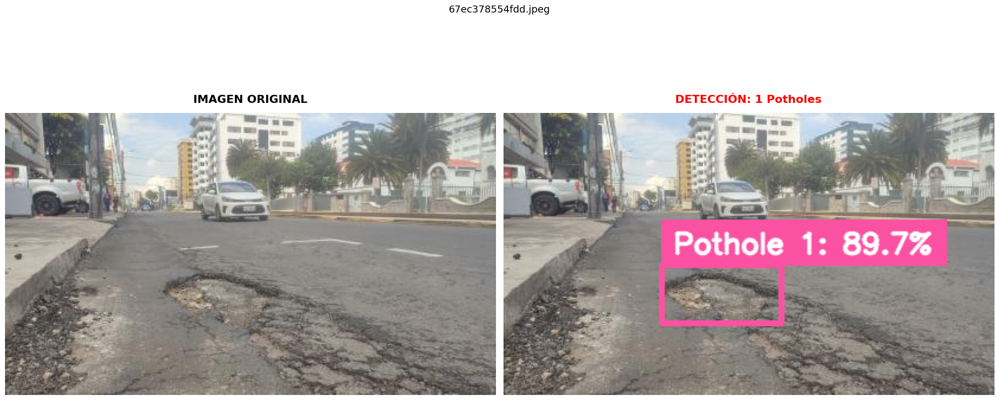


📷 PROCESANDO [2/5]: 8509254-pothole-road-damage-or-pot-hole-concept-with-street.jpg
📐 Dimensiones: 1300 x 863 px
🔍 Detectando potholes...

🕳️ POTHOLES DETECTADOS: 1
  Pothole #1: Confianza 94.78% | Tamaño: 874x475px


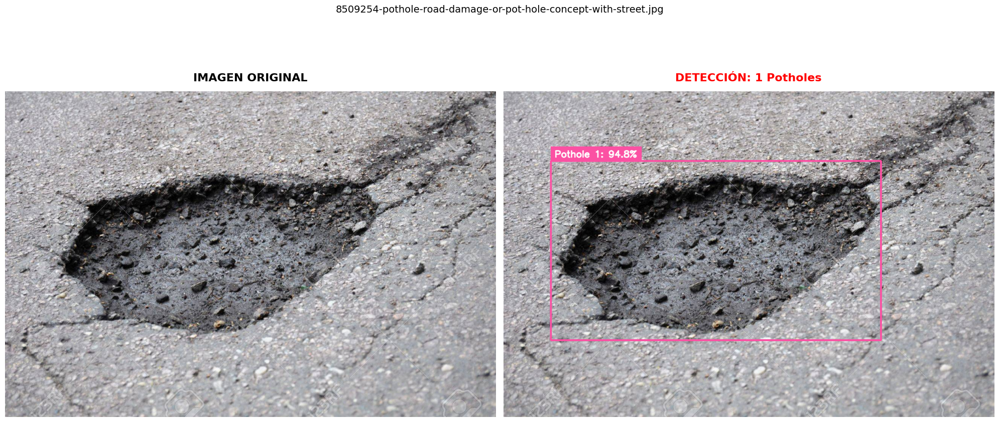


📷 PROCESANDO [3/5]: denuncia-de-la-comunidad-YRTIH3IK6NCCPFWQFYO2F4PK34.jpg
📐 Dimensiones: 1200 x 800 px
🔍 Detectando potholes...

🕳️ POTHOLES DETECTADOS: 1
  Pothole #1: Confianza 91.88% | Tamaño: 550x172px


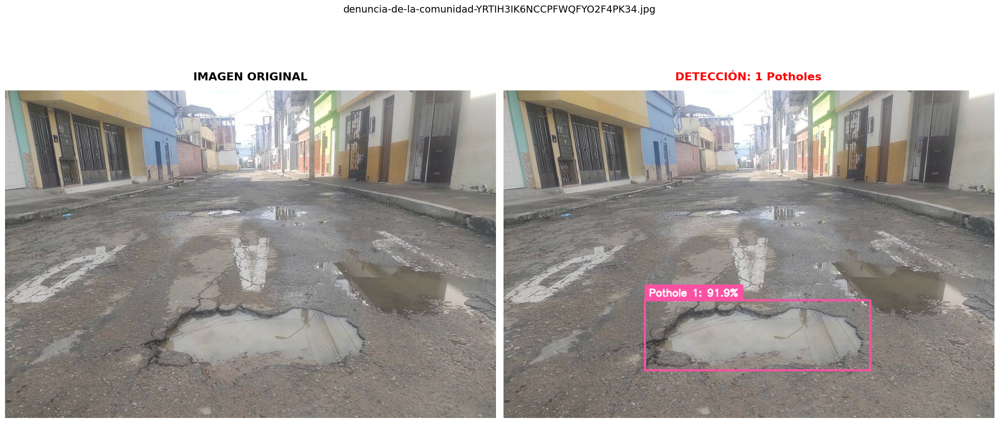


📷 PROCESANDO [4/5]: DSCN5122_C.jpg
📐 Dimensiones: 595 x 335 px
🔍 Detectando potholes...

🕳️ POTHOLES DETECTADOS: 3
  Pothole #1: Confianza 88.29% | Tamaño: 129x76px
  Pothole #2: Confianza 83.80% | Tamaño: 61x25px
  Pothole #3: Confianza 83.02% | Tamaño: 150x96px


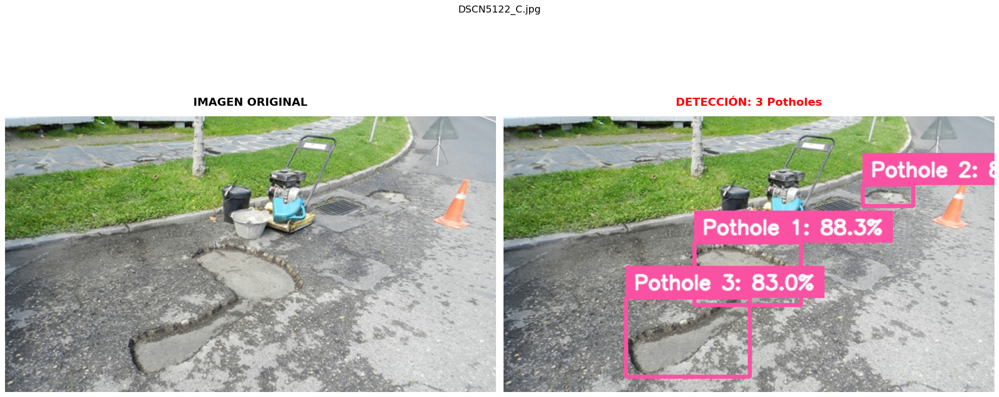


📷 PROCESANDO [5/5]: mal-estado.jpg
📐 Dimensiones: 950 x 530 px
🔍 Detectando potholes...

🕳️ POTHOLES DETECTADOS: 1
  Pothole #1: Confianza 64.66% | Tamaño: 936x376px


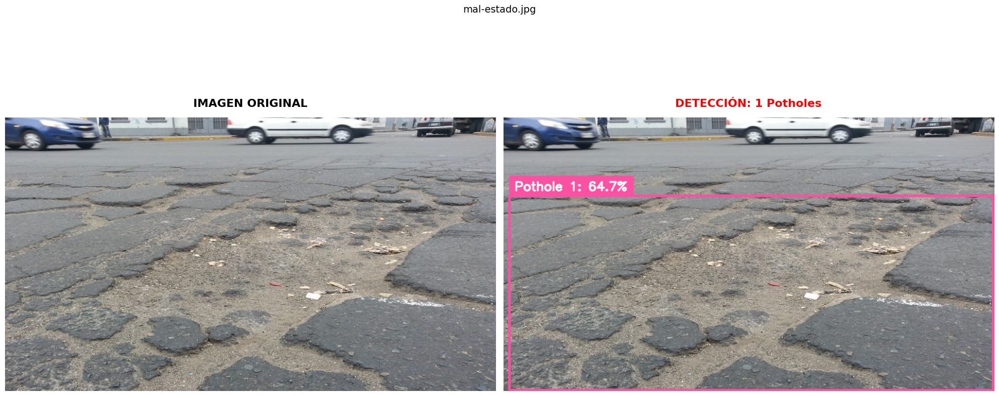


📊 RESUMEN FINAL
✅ Imágenes procesadas: 5
🕳️ Total de potholes detectados: 7
📈 Promedio por imagen: 1.4


In [ ]:

# Configuración inicial
BASE_DIR = Path(r"D:\Entrenamiento_A")
TRAIN_JSON = BASE_DIR / "train" / "_annotations.coco.json"
CHECKPOINT_PATH = BASE_DIR / "models" / "RF-DETR" / "checkpoint_best_ema.pth"

print("🔄 Cargando modelo RF-DETR...")

# Cargar modelo
NUM_CLASSES = len(json.load(open(TRAIN_JSON))["categories"])
model = RFDETRSmall(num_classes=NUM_CLASSES)
state = torch.load(CHECKPOINT_PATH, map_location="cpu")

if "ema" in state:
    state = state["ema"]
elif "model" in state:
    state = state["model"]

try:
    torch_model = model.model.model
except AttributeError:
    torch_model = model.model

torch_model.load_state_dict(state, strict=False)
model.optimize_for_inference(compile=False)
model.names = ["pothole"]

print("✅ Modelo cargado exitosamente!\n")

# Abrir diálogo para seleccionar UNA O VARIAS imágenes
from tkinter import Tk, filedialog

print("📂 Selecciona una o varias imágenes desde tu PC...")
root = Tk()
root.withdraw()
root.attributes('-topmost', True)

image_paths = filedialog.askopenfilenames(  # Note: askopenfilenames (plural)
    title="Selecciona imágenes para detectar potholes",
    filetypes=[
        ("Imágenes", "*.jpg *.jpeg *.png *.bmp"),
        ("Todos los archivos", "*.*")
    ]
)
root.destroy()

if not image_paths:
    print("❌ No se seleccionaron imágenes")
else:
    print(f"✅ {len(image_paths)} imagen(es) seleccionada(s)\n")
    
    total_potholes_all = 0
    
    # Procesar cada imagen
    for idx, image_path in enumerate(image_paths):
        print(f"\n{'='*70}")
        print(f"📷 PROCESANDO [{idx+1}/{len(image_paths)}]: {Path(image_path).name}")
        print(f"{'='*70}")
        
        # Cargar imagen
        image = Image.open(image_path).convert("RGB")
        print(f"📐 Dimensiones: {image.size[0]} x {image.size[1]} px")
        
        # Hacer predicción
        print("🔍 Detectando potholes...")
        detections = model.predict(image, conf_threshold=0.5)
        
        # Ajustar IDs de clase
        adjusted_class_ids = [int(cid) - 1 for cid in detections.class_id]
        valid_mask = [i for i, cid in enumerate(adjusted_class_ids) if 0 <= cid < NUM_CLASSES]
        
        filtered = sv.Detections(
            xyxy=detections.xyxy[valid_mask],
            confidence=detections.confidence[valid_mask],
            class_id=np.array([adjusted_class_ids[i] for i in valid_mask], dtype=int),
        )
        
        num_potholes = len(filtered)
        total_potholes_all += num_potholes
        
        # Mostrar resultados en consola
        print(f"\n🕳️ POTHOLES DETECTADOS: {num_potholes}")
        
        if num_potholes > 0:
            for i, (box, conf) in enumerate(zip(filtered.xyxy, filtered.confidence)):
                x1, y1, x2, y2 = box
                width = x2 - x1
                height = y2 - y1
                print(f"  Pothole #{i+1}: Confianza {conf:.2%} | Tamaño: {width:.0f}x{height:.0f}px")
        else:
            print("  ✅ No se detectaron potholes")
        
        # Crear imagen anotada
        box_annotator = sv.BoxAnnotator(thickness=4)
        label_annotator = sv.LabelAnnotator(
            text_position=sv.Position.TOP_LEFT,
            text_scale=0.8,
            text_thickness=2
        )
        
        annotated_image = box_annotator.annotate(scene=np.array(image).copy(), detections=filtered)
        labels = [f"Pothole {i+1}: {conf:.1%}" for i, conf in enumerate(filtered.confidence)]
        annotated_image = label_annotator.annotate(scene=annotated_image, detections=filtered, labels=labels)
        
        # Mostrar ORIGINAL y DETECCIÓN lado a lado
        fig, axes = plt.subplots(1, 2, figsize=(20, 10))
        
        # Imagen original
        axes[0].imshow(np.array(image))
        axes[0].axis("off")
        axes[0].set_title("IMAGEN ORIGINAL", fontsize=16, fontweight='bold', pad=15)
        
        # Imagen con detecciones
        axes[1].imshow(annotated_image)
        axes[1].axis("off")
        axes[1].set_title(f"DETECCIÓN: {num_potholes} Potholes", 
                         fontsize=16, fontweight='bold', pad=15,
                         color='red' if num_potholes > 0 else 'green')
        
        plt.suptitle(f"{Path(image_path).name}", fontsize=14, y=0.98)
        plt.tight_layout()
        plt.show()
    
    # Resumen final
    print(f"\n{'='*70}")
    print(f"📊 RESUMEN FINAL")
    print(f"{'='*70}")
    print(f"✅ Imágenes procesadas: {len(image_paths)}")
    print(f"🕳️ Total de potholes detectados: {total_potholes_all}")
    if len(image_paths) > 0:
        print(f"📈 Promedio por imagen: {total_potholes_all/len(image_paths):.1f}")
    print(f"{'='*70}")
